In [1]:
#######################################################################################
# Read Me Section:
## Name:
# Kaylen Smith Darnbrook
# Student ID:
# 2135667
# Course:
# M.S.c Machine Learning and Artificial Intelligence
# Module:
## DemonstrationFaceGeneration
## Description: 
# This module generates the baseline GAP Model used for denoising and generating faces.
# It uses the FFHQ256 dataset to train the model. The model is then saved to the
# 'models' directory. The model is then used to generate faces from the FFHQ256 dataset.
# A single model and cascade model implementation of GAP is used. The model is trained
# using the Adam optimizer and the loss function is the PhotonLoss Function. Each model
# is trained for 30 epochs. The models are compared using the Psnr, SSIM and Perceptual
# loss metric.
# This jupyter notebook is used to demonstrate the implementation of the original single and cascade GAP model.
# This notebook builds off of the work of the original authors of the GAP model which can be found at:
#https://github.com/krulllab/GAP
#####################################################################################

In [2]:
# Import Relevant Libraries:

# Import modules for system managment, io and file management 
import os 
import time 
import random

# Import modules for data manipulation and analysis
import numpy as np
import pandas as pd
import scipy as sp

# Import modules for data visualisation
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("darkgrid", {"axes.facecolor": ".9"})
sns.set_context("notebook")
from PIL import Image

# Import modules for Deep learning
import torch
from torch.utils.data import DataLoader
torch.set_float32_matmul_precision('medium')
torch.autograd.set_detect_anomaly(True)

# Pytorch Lightning Modules:
import pytorch_lightning as pL
from pytorch_lightning.callbacks import ModelCheckpoint
from pytorch_lightning.callbacks.early_stopping import EarlyStopping
from pytorch_lightning.callbacks import ModelCheckpoint, EarlyStopping, LearningRateMonitor
from pytorch_lightning.callbacks import LearningRateMonitor

# Import modules for model selection and evaluation.
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim

# Import the DataLoader
#from BinomDataset4 import FacesDataset
from PoissonDataset10 import FacesDataset
from PoissonValidator2 import ValidationSetGenerator
from OriginalGAPUNet import UNet

# Visualisation Software
import time
import numpy as np
import lpips

In [3]:
'''
Samples an image using Generative Accumulation of Photons (GAP) based on an initial photon image.
If the initial photon image contains only zeros the model samples from scratch. 
If it contains photon numbers, the model performs diversity denoising.

        Parameters:
                input_image (torch tensor): the initial photon image, containing integers (batch, channel, y, x).  
                model: the network used to predict the next phton location.
                max_photons (int): stop sampling when image contains more photons. 
                max_its (int): stop sampling after max_its iterations. 
                max_psnr (float): stop sampling when pseudo PSNR is larger max_psnr
                save_every_n (int): store and return images at every nth step. 
                augment (bool): use 8-fold data augmentation (default is False) 
                beta (float): photon number is increased exponentially by factor beta in each step.
        Returns:
                denoised (numpy array): denoised image at the end of that sampling process.
                photons (numpy array): photon image at the end of the sampling process.
                stack (list): list of numpy arrays containing intermediate results.
                i (int) number of executed iterations.
'''
def sample_image_3(input_image,
                 model,
                 max_photons = None,
                 max_its = 500000,
                 max_psnr = -15,
                 save_every_n = 5,
                 beta = 0.1
                ):

    start = input_image.clone()
    photons = start
    photnum = 1

    denoised = None
    stack = []
    
    sumDenoised = start
    region = 64
    
    for i in range(max_its):
        #print(i)
        # compute the pseudo PSNR
        psnr = np.log10(photons.mean().item() + 1e-50) * 10
        psnr = max(-40, psnr)
        if i % 10 == 0:
            print(psnr)
            
        if (max_photons is not None) and (photons.sum().item() > max_photons):
            break
            
        if psnr > max_psnr:
            break
    
        denoised = model(photons)
        denoised.detach()
        denoised = denoised - denoised.max()
        denoised = torch.exp(denoised)   
        denoised = denoised / (denoised.sum(dim=(-1,-2,-3), keepdim = True))

        #denoised = (denoised - denoised.min())/(denoised.max() - denoised.min())
        #plt.figure(figsize=(5,5))
        #plt.imshow(denoised.squeeze(0).permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
        #plt.title('denoised')
        #plt.show()
        #plt.clf()

        #photon_image = (photons - photons.min())/(photons.max() - photons.min())
        #plt.imshow(photon_image.squeeze(0).permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
        #plt.title('photons')
        #plt.show()
        #plt.clf()

        # here we save an image into our stack
        if (save_every_n is not None) and (i%save_every_n == 0):  

            imgsave = denoised.squeeze(0).permute(1,2,0).detach().cpu()
            imgsave = imgsave/imgsave.max()
            photsave = photons.squeeze(0).permute(1,2,0).detach().cpu()
            photsave = photsave / max(photsave.max(),1)      
            combi = torch.hstack((photsave,imgsave))
            stack.append(combi.numpy())

        # increase photon number
        photnum = max(beta* photons.sum(),1)
        
        # draw new photons
        new_photons = torch.poisson(denoised*(photnum)) 
        
        # add new photons
        photons = photons + new_photons 
        #photon_image_new = (photons_new - photons_new.min())/(photons_new.max() - photons_new.min())
        #plt.imshow(photon_image_new.squeeze(0).permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
        #plt.title('photons_new')
        #plt.show()
        #plt.clf()
    
    #print("Final PSNR Score", psnr)
    return denoised[...].detach().cpu().numpy(), photons[...].detach().cpu().numpy(), stack, i

In [4]:
# Generates plots of the Psnr, SSIM and Perceptual Loss from the data.
from IPython.display import display
def Plot_Creater(Psnr_Distribution, SSIM_Distribution, Perceptual_Distribution, minpsnr, maxpsnr):
    Psnr_Distribution = Psnr_Distribution.copy()
    SSIM_Distribution = SSIM_Distribution.copy()
    Perceptual_Distribution = Perceptual_Distribution.copy()
    Psnr_Distribution = pd.DataFrame(Psnr_Distribution, columns = ["PSNR"])
    Psnr_Distribution["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Psnr_Distribution.shape[0])
    Psnr_Distribution["PSNR_Average"] = Psnr_Distribution["PSNR"].rolling(window = 12).mean()
    Psnr_Distribution["PSNR_Variance"] = Psnr_Distribution["PSNR"].rolling(window = 12).std()
    Psnr_Distribution["PSNR_Variance_Upper"] = Psnr_Distribution["PSNR_Average"] + Psnr_Distribution["PSNR"].rolling(window = 12).std()
    Psnr_Distribution["PSNR_Variance_Lower"] = Psnr_Distribution["PSNR_Average"] - Psnr_Distribution["PSNR"].rolling(window = 12).std()   
    Psnr_Distribution.dropna(inplace = True)
    display(Psnr_Distribution.describe())

    SSIM_Distribution = pd.DataFrame(SSIM_Distribution, columns = ["SSIM"])
    SSIM_Distribution["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, SSIM_Distribution.shape[0])
    SSIM_Distribution["SSIM_Average"] = SSIM_Distribution["SSIM"].rolling(window = 12).mean()
    SSIM_Distribution["SSIM_Variance"] = SSIM_Distribution["SSIM"].rolling(window = 12).std()
    SSIM_Distribution["SSIM_Variance_Upper"] = SSIM_Distribution["SSIM_Average"] + SSIM_Distribution["SSIM"].rolling(window = 12).std()
    SSIM_Distribution["SSIM_Variance_Lower"] = SSIM_Distribution["SSIM_Average"] - SSIM_Distribution["SSIM"].rolling(window = 12).std()
    SSIM_Distribution.dropna(inplace = True)
    display(SSIM_Distribution.describe())

    Perceptual_Distribution = pd.DataFrame(Perceptual_Distribution, columns = ["1-PL"])
    Perceptual_Distribution["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Perceptual_Distribution.shape[0])
    Perceptual_Distribution["1-PL_Average"] = Perceptual_Distribution["1-PL"].rolling(window = 12).mean()
    Perceptual_Distribution["1-PL_Variance"] = Perceptual_Distribution["1-PL"].rolling(window = 12).std()
    Perceptual_Distribution["1-PL_Variance_Upper"] = Perceptual_Distribution["1-PL_Average"] + Perceptual_Distribution["1-PL_Average"].rolling(window = 12).std()
    Perceptual_Distribution["1-PL_Variance_Lower"] = Perceptual_Distribution["1-PL_Average"] - Perceptual_Distribution["1-PL_Average"].rolling(window = 12).std()
    Perceptual_Distribution.dropna(inplace = True)
    display(Perceptual_Distribution.describe())

    plt.Figure(figsize=(10,10))
    sns.set_style("darkgrid")
    sns.scatterplot(data = Psnr_Distribution, x = "Pseudo_PSNR", y = "PSNR", alpha = 0.5)
    sns.lineplot(data = Psnr_Distribution, x = "Pseudo_PSNR", y = "PSNR_Average", color = "red")
    sns.lineplot(data = Psnr_Distribution, x = "Pseudo_PSNR", y = "PSNR_Variance_Upper", color = "blue")
    sns.lineplot(data = Psnr_Distribution, x = "Pseudo_PSNR", y = "PSNR_Variance_Lower", color = "green")
    Psnr_Area = np.trapz(Psnr_Distribution["PSNR_Average"].values, Psnr_Distribution["Pseudo_PSNR"].values)
    #plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve
    plt.xlabel("Pseudo_Psnr")
    plt.ylabel("PSNR")
    plt.title("Psnr vs Pseudo_Psnr")
    plt.show()

    plt.Figure(figsize=(10,10))
    sns.set_style("darkgrid")
    sns.scatterplot(data = SSIM_Distribution, x = "Pseudo_PSNR", y = "SSIM", alpha = 0.5)
    sns.lineplot(data = SSIM_Distribution, x = "Pseudo_PSNR", y = "SSIM_Average", color = "red")
    sns.lineplot(data = SSIM_Distribution, x = "Pseudo_PSNR", y = "SSIM_Variance_Upper", color = "blue")
    sns.lineplot(data = SSIM_Distribution, x = "Pseudo_PSNR", y = "SSIM_Variance_Lower", color = "green")
    SSIM_Area = np.trapz(SSIM_Distribution["SSIM_Average"].values, SSIM_Distribution["Pseudo_PSNR"].values)
    #plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve
    plt.xlabel("Pseudo_Psnr")
    plt.ylabel("SSIM")
    plt.title("SSIM vs Pseudo_Psnr")
    plt.show()

    plt.Figure(figsize=(10,10))
    sns.scatterplot(data = Perceptual_Distribution, x = "Pseudo_PSNR", y = "1-PL", alpha = 0.5)
    sns.lineplot(data = Perceptual_Distribution, x = "Pseudo_PSNR", y = "1-PL_Average", color = "red") 
    sns.lineplot(data = Perceptual_Distribution, x = "Pseudo_PSNR", y = "1-PL_Variance_Upper", color = "blue")
    sns.lineplot(data = Perceptual_Distribution, x = "Pseudo_PSNR", y = "1-PL_Variance_Lower", color = "green")
    Perceptual_Area = np.trapz(Perceptual_Distribution["1-PL_Average"].values, Perceptual_Distribution["Pseudo_PSNR"].values)
    #plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve
    plt.xlabel("Pseudo_Psnr")
    plt.ylabel("1-Perceptual_Loss")
    plt.title("1-Perceptual_Loss vs Pseudo_Psnr")
    plt.show()

    print(f"Psnr Area: {Psnr_Area}, SSIM Area: {SSIM_Area}, Perceptual Area: {Perceptual_Area}")

    print("Mean Psnr",Psnr_Distribution["PSNR"].mean())
    print("Std Psnr",Psnr_Distribution["PSNR"].std()) 
    print("Min Psnr",Psnr_Distribution["PSNR"].min()) 
    print("Max Psnr",Psnr_Distribution["PSNR"].max())
    print("Mean Roll Var",Psnr_Distribution["PSNR_Variance"].mean())

    print("Mean SSIM",SSIM_Distribution["SSIM"].mean())
    print("Std SSIM",SSIM_Distribution["SSIM"].std()) 
    print("Min SSIM",SSIM_Distribution["SSIM"].min()) 
    print("Max SSIM",SSIM_Distribution["SSIM"].max())
    print("Mean Roll SSIM",SSIM_Distribution["SSIM_Variance"].mean())

    print("Mean 1-PL",Perceptual_Distribution["1-PL"].mean())
    print("Std 1-PL",Perceptual_Distribution["1-PL"].std()) 
    print("Min 1-PL",Perceptual_Distribution["1-PL"].min()) 
    print("Max 1-PL",Perceptual_Distribution["1-PL"].max())
    print("Mean Roll 1-PL",Perceptual_Distribution["1-PL_Variance"].mean())

    return Psnr_Area, SSIM_Area, Perceptual_Area

In [5]:
# Wraps around the sample_image_3 function to generate the faces.
def Sample_Image(input_image, model,  max_psnr, max_its = 1000, beta = 0.005, save_every_n = 10, device = 'cuda'):
    channels = 3
    batch_size = 1
    pixels_x = 128
    pixels_y = 128

    model = model.to(device)
    model.eval()
    input_image = input_image.to(device)

    denoised, photons, stack, i = sample_image_3(input_image, model, max_its = max_its, max_psnr = max_psnr, 
                                                 beta = beta, save_every_n = save_every_n)
    return denoised, photons, stack, i

In [6]:
# Sets the plotting parameters for the visualisation of the images.
plt.rcParams["axes.facecolor"] = "white"
plt.rcParams["savefig.facecolor"] = "white"
plt.rc("text", usetex = False)
plt.rc("font", family = "Times New Roman")
plt.rcParams["axes.grid"] = False

In [7]:
## Configuration
# Set the seed for reproducibility
seed = 42
np.random.seed(seed)
torch.manual_seed(seed)

# Set the device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Device: {device}")
GREYSCALE = False

# Set the path to the data
root_path = r"ffhq256_dataset/ffhq256"  # Replace with the Directory the FFHQ256 dataset is stored in
out_dir =r"TestSet"  # Replace with the Directory to save the generated images
Batch_Size = 32
load_pretained = False
NUM_Features = 128 * 128
max_epochs = 30
patience = 10
minpsnr = -40
maxpsnr = 32

Device: cuda


In [8]:
# Generates plots of the Psnr, SSIM and Perceptual Loss from the data.
from IPython.display import display
def Plot_Creater(Psnr_Distribution, SSIM_Distribution, Perceptual_Distribution, minpsnr, maxpsnr):

    # Generate a dataframe of the Psnr, SSIM and Perceptual Loss
    # Calculate the rolling mean and standard deviation of the data.
    # Plot the data using Seaborn.
    # Calculate the area under the curve for the Psnr, SSIM and Perceptual Loss.
    # Print the mean, standard deviation, minimum and maximum values of the data.
    # Return the area under the curve for the Psnr, SSIM and Perceptual Loss.

    Psnr_Distribution = pd.DataFrame(Psnr_Distribution, columns = ["PSNR"])
    Psnr_Distribution["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Psnr_Distribution.shape[0])
    Psnr_Distribution["PSNR_Average"] = Psnr_Distribution["PSNR"].rolling(window = 12).mean()
    Psnr_Distribution["PSNR_Variance"] = Psnr_Distribution["PSNR"].rolling(window = 12).std()
    Psnr_Distribution["PSNR_Variance_Upper"] = Psnr_Distribution["PSNR_Average"] + Psnr_Distribution["PSNR"].rolling(window = 12).std()
    Psnr_Distribution["PSNR_Variance_Lower"] = Psnr_Distribution["PSNR_Average"] - Psnr_Distribution["PSNR"].rolling(window = 12).std()   
    Psnr_Distribution.dropna(inplace = True)
    display(Psnr_Distribution.describe())

    SSIM_Distribution = pd.DataFrame(SSIM_Distribution, columns = ["SSIM"])
    SSIM_Distribution["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, SSIM_Distribution.shape[0])
    SSIM_Distribution["SSIM_Average"] = SSIM_Distribution["SSIM"].rolling(window = 12).mean()
    SSIM_Distribution["SSIM_Variance"] = SSIM_Distribution["SSIM"].rolling(window = 12).std()
    SSIM_Distribution["SSIM_Variance_Upper"] = SSIM_Distribution["SSIM_Average"] + SSIM_Distribution["SSIM"].rolling(window = 12).std()
    SSIM_Distribution["SSIM_Variance_Lower"] = SSIM_Distribution["SSIM_Average"] - SSIM_Distribution["SSIM"].rolling(window = 12).std()
    SSIM_Distribution.dropna(inplace = True)
    display(SSIM_Distribution.describe())

    Perceptual_Distribution = pd.DataFrame(Perceptual_Distribution, columns = ["1-PL"])
    Perceptual_Distribution["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Perceptual_Distribution.shape[0])
    Perceptual_Distribution["1-PL_Average"] = Perceptual_Distribution["1-PL"].rolling(window = 12).mean()
    Perceptual_Distribution["1-PL_Variance"] = Perceptual_Distribution["1-PL"].rolling(window = 12).std()
    Perceptual_Distribution["1-PL_Variance_Upper"] = Perceptual_Distribution["1-PL_Average"] + Perceptual_Distribution["1-PL_Average"].rolling(window = 12).std()
    Perceptual_Distribution["1-PL_Variance_Lower"] = Perceptual_Distribution["1-PL_Average"] - Perceptual_Distribution["1-PL_Average"].rolling(window = 12).std()
    Perceptual_Distribution.dropna(inplace = True)
    display(Perceptual_Distribution.describe())

    plt.Figure(figsize=(10,10))
    sns.set_style("darkgrid")
    sns.scatterplot(data = Psnr_Distribution, x = "Pseudo_PSNR", y = "PSNR", alpha = 0.5)
    sns.lineplot(data = Psnr_Distribution, x = "Pseudo_PSNR", y = "PSNR_Average", color = "red")
    sns.lineplot(data = Psnr_Distribution, x = "Pseudo_PSNR", y = "PSNR_Variance_Upper", color = "blue")
    sns.lineplot(data = Psnr_Distribution, x = "Pseudo_PSNR", y = "PSNR_Variance_Lower", color = "green")
    Psnr_Area = np.trapz(Psnr_Distribution["PSNR_Average"].values, Psnr_Distribution["Pseudo_PSNR"].values)
    #plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve
    plt.xlabel("Pseudo_Psnr")
    plt.ylabel("PSNR")
    plt.title("Psnr vs Pseudo_Psnr")
    plt.show()

    plt.Figure(figsize=(10,10))
    sns.set_style("darkgrid")
    sns.scatterplot(data = SSIM_Distribution, x = "Pseudo_PSNR", y = "SSIM", alpha = 0.5)
    sns.lineplot(data = SSIM_Distribution, x = "Pseudo_PSNR", y = "SSIM_Average", color = "red")
    sns.lineplot(data = SSIM_Distribution, x = "Pseudo_PSNR", y = "SSIM_Variance_Upper", color = "blue")
    sns.lineplot(data = SSIM_Distribution, x = "Pseudo_PSNR", y = "SSIM_Variance_Lower", color = "green")
    SSIM_Area = np.trapz(SSIM_Distribution["SSIM_Average"].values, SSIM_Distribution["Pseudo_PSNR"].values)
    #plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve
    plt.xlabel("Pseudo_Psnr")
    plt.ylabel("SSIM")
    plt.title("SSIM vs Pseudo_Psnr")
    plt.show()

    plt.Figure(figsize=(10,10))
    sns.scatterplot(data = Perceptual_Distribution, x = "Pseudo_PSNR", y = "1-PL", alpha = 0.5)
    sns.lineplot(data = Perceptual_Distribution, x = "Pseudo_PSNR", y = "1-PL_Average", color = "red") 
    sns.lineplot(data = Perceptual_Distribution, x = "Pseudo_PSNR", y = "1-PL_Variance_Upper", color = "blue")
    sns.lineplot(data = Perceptual_Distribution, x = "Pseudo_PSNR", y = "1-PL_Variance_Lower", color = "green")
    Perceptual_Area = np.trapz(Perceptual_Distribution["1-PL_Average"].values, Perceptual_Distribution["Pseudo_PSNR"].values)
    #plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve
    plt.xlabel("Pseudo_Psnr")
    plt.ylabel("1-Perceptual_Loss")
    plt.title("1-Perceptual_Loss vs Pseudo_Psnr")
    plt.show()

    print(f"Psnr Area: {Psnr_Area}, SSIM Area: {SSIM_Area}, Perceptual Area: {Perceptual_Area}")

    print("Mean Psnr",Psnr_Distribution["PSNR"].mean())
    print("Std Psnr",Psnr_Distribution["PSNR"].std()) 
    print("Min Psnr",Psnr_Distribution["PSNR"].min()) 
    print("Max Psnr",Psnr_Distribution["PSNR"].max())
    print("Mean Roll Var",Psnr_Distribution["PSNR_Variance"].mean())

    print("Mean SSIM",SSIM_Distribution["SSIM"].mean())
    print("Std SSIM",SSIM_Distribution["SSIM"].std()) 
    print("Min SSIM",SSIM_Distribution["SSIM"].min()) 
    print("Max SSIM",SSIM_Distribution["SSIM"].max())
    print("Mean Roll SSIM",SSIM_Distribution["SSIM_Variance"].mean())

    print("Mean 1-PL",Perceptual_Distribution["1-PL"].mean())
    print("Std 1-PL",Perceptual_Distribution["1-PL"].std()) 
    print("Min 1-PL",Perceptual_Distribution["1-PL"].min()) 
    print("Max 1-PL",Perceptual_Distribution["1-PL"].max())
    print("Mean Roll 1-PL",Perceptual_Distribution["1-PL_Variance"].mean())

    return Psnr_Area, SSIM_Area, Perceptual_Area

In [9]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
Steps = 9
Spacing = (maxpsnr - minpsnr) // Steps
PSNR_Ranges = [(i, j) for i, j in zip(range(minpsnr, maxpsnr, Spacing), range(minpsnr + Spacing, maxpsnr + Spacing, Spacing))]
print(PSNR_Ranges)

[(-40, -32), (-32, -24), (-24, -16), (-16, -8), (-8, 0), (0, 8), (8, 16), (16, 24), (24, 32)]


In [10]:
# Generates the metric functions for the PSNR, SSIM and Pseudo_PSNR
def PSNR(original, transformed, maximum):
    mse = np.mean((original-transformed)**2)
    if mse == 0:
        return 100
    max_pixel_value = maximum
    psnr = 20 * np.log10(max_pixel_value/np.sqrt(mse))
    return psnr

def SSIM(original, transformed):
    return sp.signal.ssim(original, transformed, multichannel=True)

def Estimated_Psuedo_PSNR(transformed, image_size):
    intensity = transformed/image_size
    return 10 * np.log(intensity)

In [11]:
# Generates a plot of the random persons in the dataset.
def plot_random_persons(images, sample = 9):
    random_image_indexes=np.array(random.sample(list(range(len(images))),sample))
    images = np.array([np.asarray(Image.open(os.path.join(root_path, images[index]))) for index in random_image_indexes])

    if (np.sqrt(sample) - int(np.sqrt(sample))) == 0:
        sqrt = int(np.sqrt(sample))
        Length, width = sqrt, sqrt
    else:
        Length, width = 1, sample
    
    fig = plt.figure(figsize=(15,15))
    for index, values in enumerate(random_image_indexes):
        images = np.array(images)
        image = (images[index] - images[index].min())/(images[index].max() - images[index].min())
        plt.subplot(Length,width,index+1)
        plt.imshow(image)
        plt.title(f'Person_id: {random_image_indexes[index]}\nShape: {images[index].shape}')
    return fig

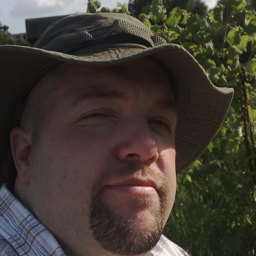

In [12]:
# Grabs the image paths from the dataset.
Image_Paths = [img for img in os.listdir(root_path)]
Image.open(os.path.join(root_path, Image_Paths[50128]))

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

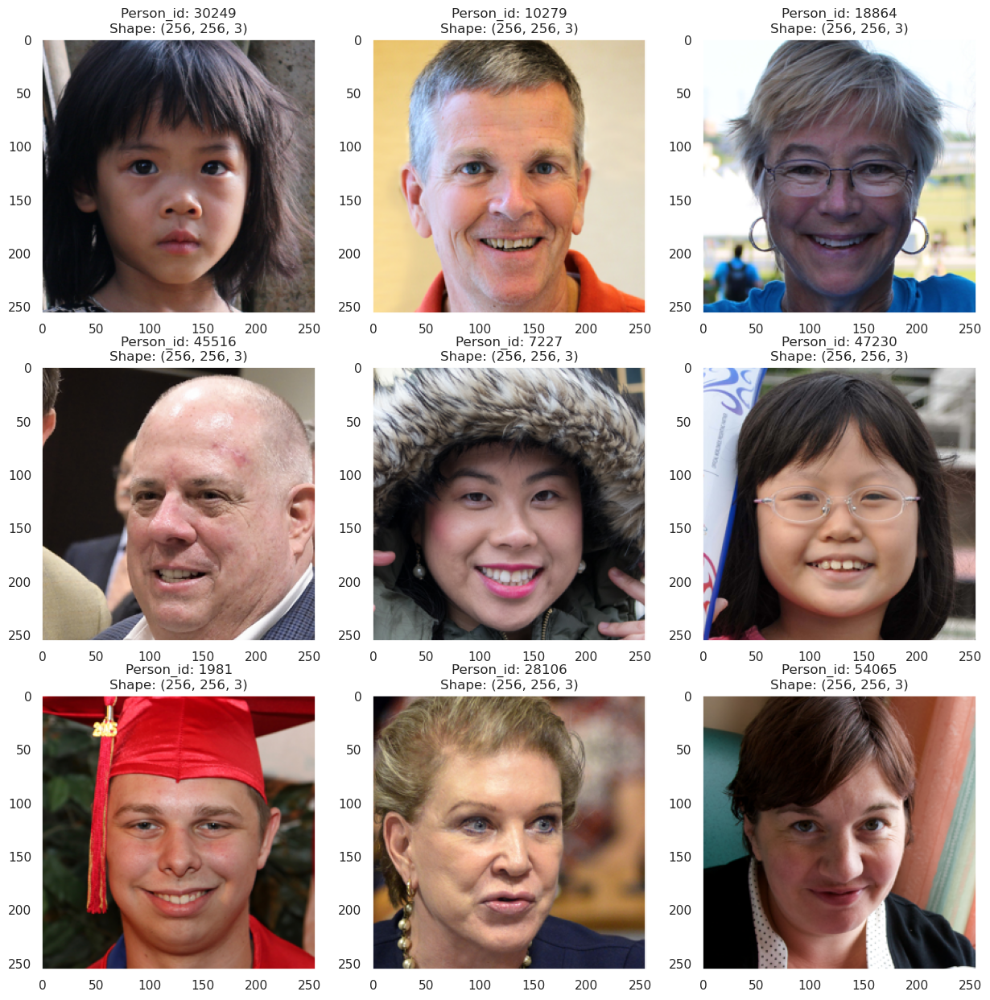

In [13]:
# Plots the Faces
fig = plot_random_persons(Image_Paths, sample = 9)

In [14]:
# Splits the data into the training and validation sets.
Directory = [path for path in os.listdir(root_path)]
rng = np.random.default_rng(seed)
indices = rng.permutation(len(Directory))
split_index = int(len(Directory) * 0.8)
train_indices = indices[:split_index]
val_indices = indices[split_index:]
train_indices.shape, val_indices.shape

((56000,), (14000,))

In [15]:
# Collects the Training and Validation Paths
Train_Paths = [Directory[index] for index in train_indices]
Val_Paths = [Directory[index] for index in val_indices]
Paths = Train_Paths.copy()
Paths.extend(Val_Paths)
np.shape(Train_Paths), np.shape(Val_Paths), np.shape(Paths)

((56000,), (14000,), (70000,))

In [16]:
# Generates the Training and Validation Datasets as well as their respective loaders.
print(PSNR_Ranges[-9][0], PSNR_Ranges[-1][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-9][0] , maxPSNR = PSNR_Ranges[-1][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-9][0], maxPSNR = PSNR_Ranges[-1][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

-40 32


(16384, 4096)

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.


findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

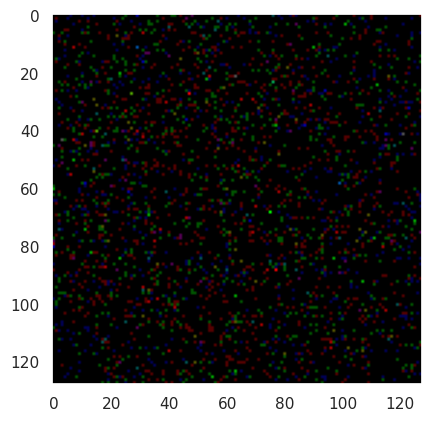

PSNR: -12.433809280395508
True PSNR: -8.05482610996352


In [17]:
# Grabs a sample image from the dataset and evaluates the PSNR.
ImageNoise, psnr_map, image_target = Train_Dataset.__getitem__(42)
ImageNoise = ImageNoise.detach().cpu().numpy().transpose(1,2,0)
image_target = image_target.detach().cpu().numpy().transpose(1,2,0)
normalised_noisy_image = ImageNoise/ImageNoise.mean()
normalised_image_target = image_target/image_target.mean()
true_psnr = psnr(normalised_image_target, normalised_noisy_image, data_range = normalised_image_target.max() - normalised_image_target.min())
normalised_image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
normalised_noisy_image = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
plt.imshow(normalised_noisy_image)
plt.show()
print(f"PSNR: {psnr_map.min().detach().cpu().numpy()}")
print(f"True PSNR: {true_psnr}")

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

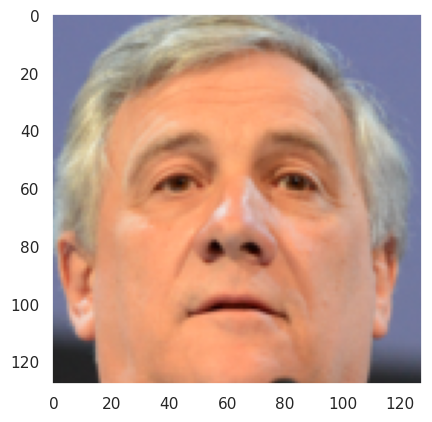

In [18]:
# Compares the original image with the noisy image.
plt.imshow(normalised_image_target)
plt.show()

In [19]:
# Grabs the Validation Paths for the Validation Noisy Images, PSNR Maps and Target Images.
Noisy_Images_Paths = []
Psnr_Maps_Paths = []
Image_Targets_Paths = []
with open(r"Validation_File_PathNames/NoisyImageNames.txt", "r") as File:  # Replace with the Dirctory Pathnames are stored in
    for line in File.readlines():
        Noisy_Images_Paths.append(line[:-1])
with open(r"Validation_File_PathNames/Psnr_MapNames.txt", "r") as File:
    for line in File.readlines():
        Psnr_Maps_Paths.append(line[:-1])
with open(r"Validation_File_PathNames/TargetImageNames.txt", "r") as File:
    for line in File.readlines():
        Image_Targets_Paths.append(line[:-1])
len(Noisy_Images_Paths), len(Psnr_Maps_Paths), len(Image_Targets_Paths)

(10, 10, 10)

In [20]:
# Generates dictionaries to store the Validation Noisy Images, PSNR Maps and Target Images.
Validation_Noisy_Images = {}
Validation_Psnr_Maps = {}
Validation_Target_Images = {}
val_Steps = 10
val_minpsnr = -40
val_maxpsnr = 40
val_Spacing = (val_maxpsnr - val_minpsnr) // val_Steps
val_psnr_ranges = [(i, j) for i, j in zip(range(val_minpsnr, val_maxpsnr, val_Spacing), range(val_minpsnr + val_Spacing, val_maxpsnr + val_Spacing, val_Spacing))]
print(len(val_psnr_ranges))
FaceValidators = [ValidationSetGenerator(root_dir= root_path, out_dir=out_dir, names = Paths, minPSNR= val_psnr_ranges[i][0], targetPSNR = val_psnr_ranges[i][1], augment= True, sample_size = 100, grayscale= GREYSCALE, amplification_factor= 1e2) for i in range(len(val_psnr_ranges))]
FaceValidators[0].out_dir
print(val_psnr_ranges)
for index in range(len(val_psnr_ranges)):
    psnr_label = str(val_psnr_ranges[index][0]) + str(val_psnr_ranges[index][1])
    print(f"Loading Validation Data for {index} Val_Dataset at psnr range {psnr_label}")
    FaceValidator = FaceValidators[index]
    File_Path_NI = Noisy_Images_Paths[index]
    File_Path_PSM = Psnr_Maps_Paths[index]
    File_Path_TI = Image_Targets_Paths[index]
    Noisy_Images, Psnr_Maps, Target_Images = FaceValidator.Load_Noisy_Faces(File_Path_NI, File_Path_PSM, File_Path_TI, device=device)
    Validation_Noisy_Images[psnr_label] = Noisy_Images
    Validation_Psnr_Maps[psnr_label] = Psnr_Maps
    Validation_Target_Images[psnr_label] = Target_Images
len(Validation_Noisy_Images), len(Validation_Psnr_Maps), len(Validation_Target_Images)

10
[(-40, -32), (-32, -24), (-24, -16), (-16, -8), (-8, 0), (0, 8), (8, 16), (16, 24), (24, 32), (32, 40)]
Loading Validation Data for 0 Val_Dataset at psnr range -40-32


/home/linux/KaylenGAP/MScGAPProject/PoissonValidator2.py:114: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  Noisy_Images = torch.load(file_path_NI)
/home/linux/KaylenGAP/MSc

Loading Validation Data for 1 Val_Dataset at psnr range -32-24
Loading Validation Data for 2 Val_Dataset at psnr range -24-16
Loading Validation Data for 3 Val_Dataset at psnr range -16-8
Loading Validation Data for 4 Val_Dataset at psnr range -80
Loading Validation Data for 5 Val_Dataset at psnr range 08
Loading Validation Data for 6 Val_Dataset at psnr range 816
Loading Validation Data for 7 Val_Dataset at psnr range 1624
Loading Validation Data for 8 Val_Dataset at psnr range 2432
Loading Validation Data for 9 Val_Dataset at psnr range 3240


(10, 10, 10)

In [21]:
# Outputs the different keys (Noise Ranges) in the Validation Noisy Images, PSNR Maps and Target Images.
Validation_Noisy_Images.keys()

dict_keys(['-40-32', '-32-24', '-24-16', '-16-8', '-80', '08', '816', '1624', '2432', '3240'])

In [22]:
# Generates a sample image from the Validation Noisy Images across different noise levels
# and evaluates the visualisation of the image.
ValidationNoisyTest_Batch = torch.zeros((len(Validation_Noisy_Images), 3, 128, 128))
ValidationPsnrTest_Batch = torch.zeros((len(Validation_Noisy_Images), 3, 128, 128))
ValidationTargetTest_Batch = torch.zeros((len(Validation_Noisy_Images), 3, 128, 128))
for index, key in enumerate(Validation_Noisy_Images.keys()):
    ValidationNoisyTest_Batch[index] = Validation_Noisy_Images[key][-10]
    ValidationPsnrTest_Batch[index] = Validation_Psnr_Maps[key][-10].view(1, 3, 128, 128)
    ValidationTargetTest_Batch[index] = Validation_Target_Images[key][-10]
ValidationNoisyTest_Batch.shape, ValidationPsnrTest_Batch.shape, ValidationTargetTest_Batch.shape

(torch.Size([10, 3, 128, 128]),
 torch.Size([10, 3, 128, 128]),
 torch.Size([10, 3, 128, 128]))

In [23]:
# Moves the validation data to the gpu
ValidationNoisyTest_Batch = ValidationNoisyTest_Batch.to(device)
ValidationPsnrTest_Batch = ValidationPsnrTest_Batch.to(device)
ValidationTargetTest_Batch = ValidationTargetTest_Batch.to(device)

In [24]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the Baseline U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

/home/linux/KaylenGAP/MScGAPProject/OriginalGAPUNet.py:256: FutureWarning: `nn.init.xavier_normal` is now deprecated in favor of `nn.init.xavier_normal_`.
  init.xavier_normal(m.weight)
/home/linux/KaylenGAP/MScGAPProject/OriginalGAPUNet.py:257: FutureWarning: `nn.init.constant` is now deprecated in favor of `nn.init.constant_`.
  init.constant(m.bias, 0)


In [24]:
# Creates the directory to save the model in.
name = "FaceGenerationUNet128x128-m40-32"
CHECKPOINT_PATH = "./models/" 

In [25]:
# Trains the model using the Pytorch Lightning Trainer.
# The model is trained for 30 epochs and the model is saved in the models directory.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=10)])
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/logger_connector/logger_connector.py:75: Starting from v1.9.0, `tensorboardX` has been removed as a dependency of the `pytorch_lightning` package, due to potential conflicts with other packages in the ML ecosystem. For this reason, `logger=True` will use `CSVLogger` as the default logger, unless the `tensorboard` or `tensorboardX` packages are found. Please `pip install lightning[extra]` or one of them to enable TensorBoard support by default
Missing logger folder: models/FaceGenerationUNet128x128-m40-32/lightning_logs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type       | Params | Mode 
--------------------------------------------------
0 | conv_final | Conv2d     | 153    | train
1 | down_convs | ModuleList | 76.8 M | train
2 | up_convs   | ModuleList | 32.4 M | train
--------------------------------------------------
109 M     Trainable params
0         Non-train

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

In [26]:
# Loads the model from the checkpoint
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lightning_fabric/utilities/cloud_io.py:57: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
/home/linux/KaylenGAP/MScGAPProjec

In [27]:
# Validates the trained model on the Train Set
Trainer.test(model, Train_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:475: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.1328009068965912    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.1328009068965912}]

In [28]:
# Validates the trained model on the Validation Set
Trainer.test(model, Validation_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.13414248824119568    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.13414248824119568}]

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

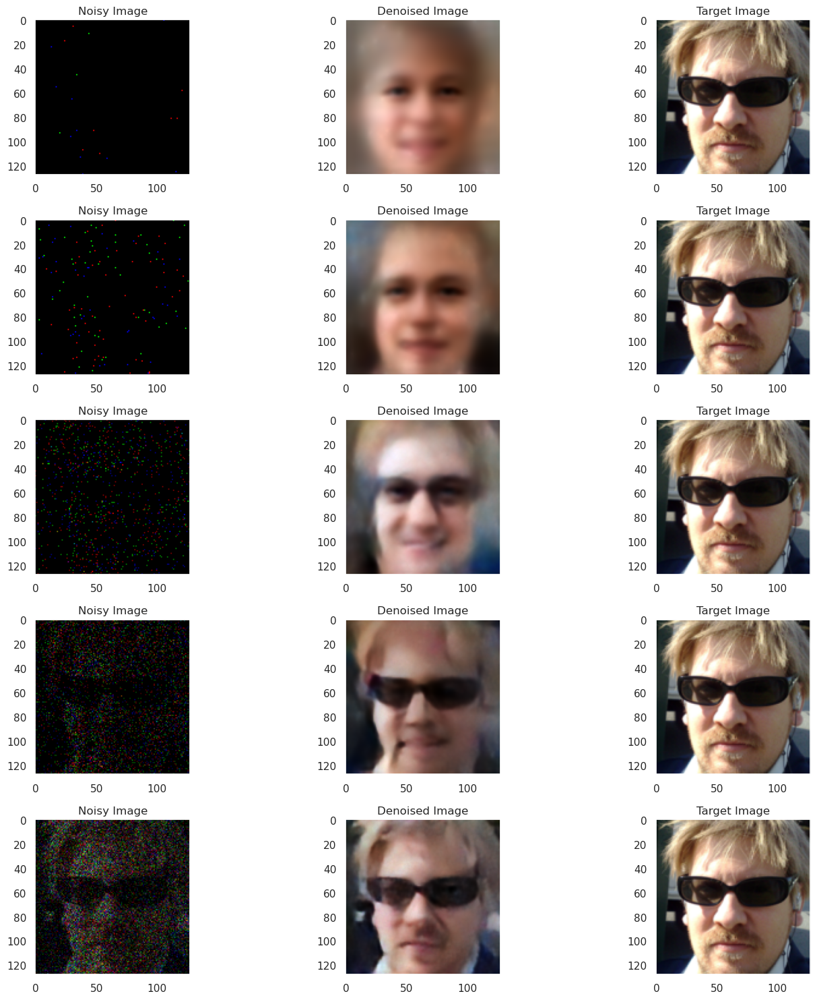

In [29]:
# Plots and visualises the sample Validation Noisy Image, Denoised Image and Target Image across the different noise levels.
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

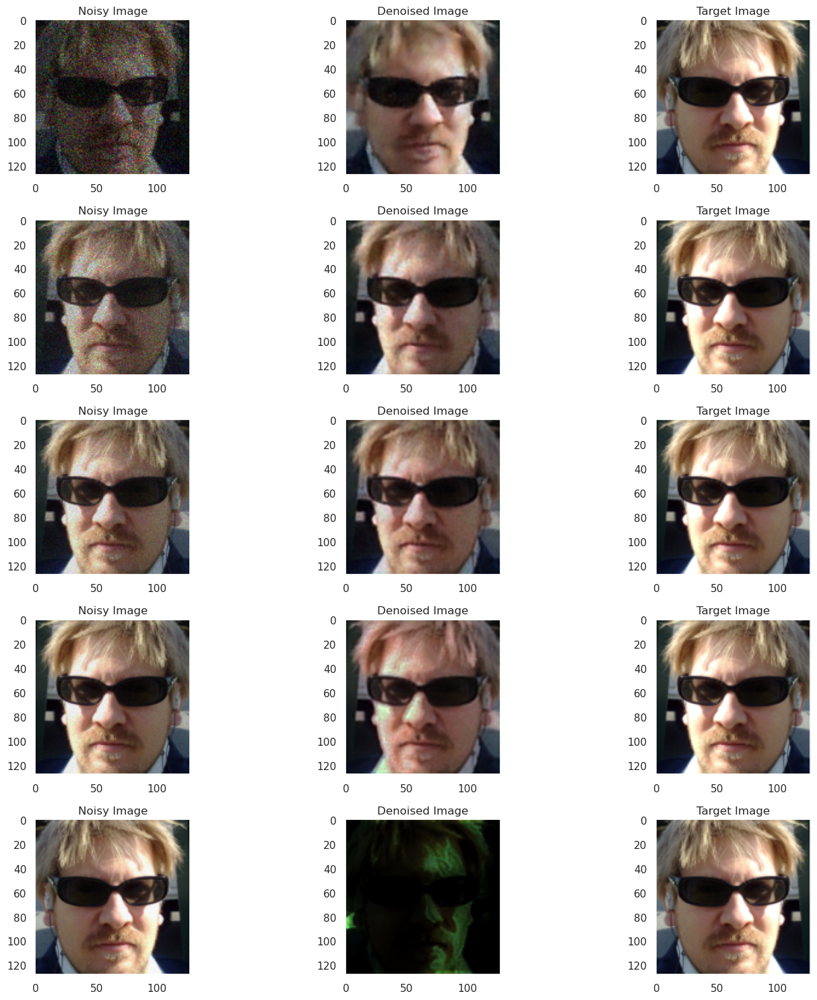

In [30]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

torch.Size([1, 3, 128, 128])
-33.6932189928148
-30.480885081161325
-26.384627358709004
-22.867074513056668
-19.36428915973917
-15.904818181031388
-12.632443701454507
-9.229030747049356
-5.8287471146142735
-2.4452274946402293
0.8620453972504244
4.187150925606361
7.523051680645146
10.860415050469278
14.205555138177443
17.543857498967355
20.885435138374365
24.229323753172448
27.571029601450363


findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

30.9133672582341


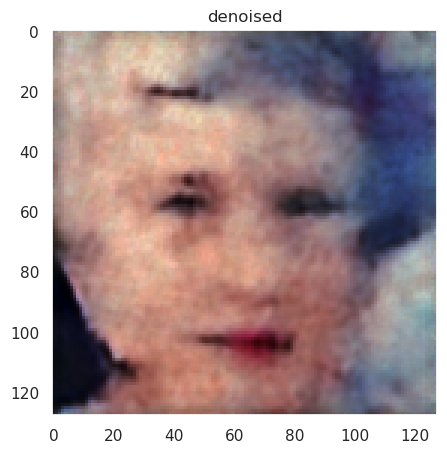

_______________________________________ 194
time (s): 2.6721904277801514 time per image (s) 2.6721904277801514


<Figure size 640x480 with 0 Axes>

In [31]:
# Generates an unseen face from the dataset and evaluates the PSNR.
ImageNoise, Psnr_map, image_target = ValidationNoisyTest_Batch[0], ValidationPsnrTest_Batch[0], ValidationTargetTest_Batch[0]
model = model.to(device)
model.eval()
inp_img = ImageNoise.unsqueeze(0).to(device)
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
vmax = np.percentile(image_target.detach().cpu().numpy(), 99.9)

# We are starting with an image containing zeros,
# i.e., sampling from scratch

# we just have 1 channel
channels = 3
# we can sample multiple images at the same time in a batch
batch_size = 1
# for best results this should correspond to training pach size
pixels_x = 128
pixels_y = 128

#inp_img =  ImageNoise.unsqueeze(0).to(device)
print(inp_img.shape)
model = model.to(device)

for i in range(1):
    
    startTime = time.time()
    
    # sampling the image(s)
    #print(inp_img.shape)
    denoised, photons, stack, iterations = sample_image_3(inp_img,
                                                        model.to(device), 
                                                        max_its=1000,
                                                        beta = 0.08,
                                                        save_every_n = 30,
                                                        max_psnr = PSNR_Ranges[-1][1])
denoised = (denoised - denoised.min())/(denoised.max() - denoised.min())
plt.figure(figsize=(5,5))
plt.imshow(denoised[0].transpose(1,2,0),vmin = 0, vmax = vmax)
plt.title('denoised')
plt.show()
plt.clf()
print('_______________________________________', iterations)
endTime = time.time()
elapsedTime = endTime - startTime
print('time (s):', elapsedTime, 'time per image (s)', elapsedTime/denoised.shape[0])

In [34]:
lpips_model = lpips.LPIPS(net='alex').to(device)

def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model.eval()
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = torch.zeros(Noisy_Images.shape[0], 3, 128, 128).to(device)
    
    # Process batches correctly without slicing errors
    batch_size = 32
    with torch.no_grad():
        for i in range(0, Noisy_Images.shape[0], batch_size):
            batch_end = min(i + batch_size, Noisy_Images.shape[0])  # Ensure no overflow
            Predictions[i:batch_end] = model(Noisy_Images[i:batch_end]).detach()

        # Adjust predictions after getting model output
        Predictions = torch.exp(Predictions - Predictions.max())  # Handle exp safely to avoid overflow
        Predictions = Noisy_Images.detach().sum(dim=(1, 2, 3), keepdim=True) * Predictions / Predictions.sum(dim=(1, 2, 3), keepdim=True)
        
        perceptual_score = lpips_model(Target_Images, Predictions)
        perceptual_score = 1 - perceptual_score
        
        # Move everything to CPU for further processing
        Noisy_Images = Noisy_Images.cpu().numpy()
        Target_Images = Target_Images.cpu().numpy()
        Predictions = Predictions.cpu().numpy()
        perceptual_score = perceptual_score.cpu().numpy()

        # Normalize Predictions correctly
        Predictions = Predictions / Predictions.mean(axis=(1, 2, 3), keepdims=True)
        
        # Compute PSNR and SSIM scores
        Psnr_Scores = [psnr(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        SSIM_Scores = [ssim(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        
        return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_1 = np.array(Psnr_Distribution)
SSIM_Distribution_1 = np.array(SSIM_Distribution)
Perceptual_Distribution_1 = np.array(Perceptual_Distribution)
Psnr_Distribution_1.shape, SSIM_Distribution_1.shape, Perceptual_Distribution_1.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/weights/v0.1/alex.pth
-40-32
-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

In [35]:
# Generates the dataframe for the Psnr
Psnr_Distribution_1 = pd.DataFrame(Psnr_Distribution_1, columns = ["PSNR"])
Psnr_Distribution_1["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Psnr_Distribution_1.shape[0])
Psnr_Distribution_1["PSNR_Average"] = Psnr_Distribution_1["PSNR"].rolling(window = 12).mean()
Psnr_Distribution_1["PSNR_Variance"] = Psnr_Distribution_1["PSNR"].rolling(window = 12).std()
Psnr_Distribution_1["PSNR_Variance_Upper"] = Psnr_Distribution_1["PSNR_Average"] + Psnr_Distribution_1["PSNR"].rolling(window = 12).std()
Psnr_Distribution_1["PSNR_Variance_Lower"] = Psnr_Distribution_1["PSNR_Average"] - Psnr_Distribution_1["PSNR"].rolling(window = 12).std()
Psnr_Distribution_1.dropna(inplace = True)
Psnr_Distribution_1.describe()

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,22.589360,-3.559511,22.507812,1.416317,23.924129,21.091495
std,6.117493,20.564969,5.985688,0.316961,5.937428,6.050190
min,9.788319,-39.119021,13.034744,0.715493,14.279654,11.399046
25%,16.933258,-21.339266,16.807122,1.204301,18.077986,15.402423
50%,22.923808,-3.559511,22.737064,1.360759,24.125562,21.441685
75%,28.374739,14.220245,28.637086,1.580826,30.131736,27.083669
max,33.121027,32.000000,31.034676,2.496276,32.437618,30.208730


In [36]:
# Generates the dataframe for the SSIM
SSIM_Distribution_1 = pd.DataFrame(SSIM_Distribution_1, columns = ["SSIM"])
SSIM_Distribution_1["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, SSIM_Distribution_1.shape[0])
SSIM_Distribution_1["SSIM_Average"] = SSIM_Distribution_1["SSIM"].rolling(window = 12).mean()
SSIM_Distribution_1["SSIM_Variance"] = SSIM_Distribution_1["SSIM"].rolling(window = 12).std()
SSIM_Distribution_1["SSIM_Variance_Upper"] = SSIM_Distribution_1["SSIM_Average"] + SSIM_Distribution_1["SSIM"].rolling(window = 12).std()
SSIM_Distribution_1["SSIM_Variance_Lower"] = SSIM_Distribution_1["SSIM_Average"] - SSIM_Distribution_1["SSIM"].rolling(window = 12).std()
SSIM_Distribution_1.dropna(inplace = True)
SSIM_Distribution_1.describe()

,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.662906,-3.559511,0.659530,0.054224,0.713754,0.605306
std,0.211617,20.564969,0.204947,0.019394,0.190875,0.219830
min,0.188367,-39.119021,0.327927,0.010742,0.393520,0.257101
25%,0.473388,-21.339266,0.453561,0.039592,0.513184,0.385548
50%,0.691903,-3.559511,0.680845,0.057969,0.744482,0.621675
75%,0.871367,14.220245,0.864236,0.068668,0.906745,0.807895
max,0.960584,32.000000,0.936082,0.098010,0.982275,0.919342


In [37]:
# Generates the dataframe for the Perceptual Loss
Perceptual_Distribution_1 = pd.DataFrame(Perceptual_Distribution_1, columns = ["1-PL"])
Perceptual_Distribution_1["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Perceptual_Distribution_1.shape[0])
Perceptual_Distribution_1["1-PL_Average"] = Perceptual_Distribution_1["1-PL"].rolling(window = 12).mean()
Perceptual_Distribution_1["1-PL_Variance"] = Perceptual_Distribution_1["1-PL"].rolling(window = 12).std()
Perceptual_Distribution_1["1-PL_Variance_Upper"] = Perceptual_Distribution_1["1-PL_Average"] + Perceptual_Distribution_1["1-PL_Average"].rolling(window = 12).std()
Perceptual_Distribution_1["1-PL_Variance_Lower"] = Perceptual_Distribution_1["1-PL_Average"] - Perceptual_Distribution_1["1-PL_Average"].rolling(window = 12).std()
Perceptual_Distribution_1.dropna(inplace = True)
Perceptual_Distribution_1.describe()

,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.451827,-3.119021,0.448497,0.055839,0.458273,0.438721
std,0.293130,20.310653,0.287891,0.023445,0.291208,0.284703
min,-0.053492,-38.238042,0.096866,0.011047,0.099376,0.091974
25%,0.130759,-20.678532,0.122207,0.035682,0.125788,0.118019
50%,0.579122,-3.119021,0.634359,0.057134,0.652500,0.612653
75%,0.724754,14.440489,0.698367,0.074927,0.708677,0.687074
max,0.920175,32.000000,0.859525,0.108543,0.869717,0.849333


findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

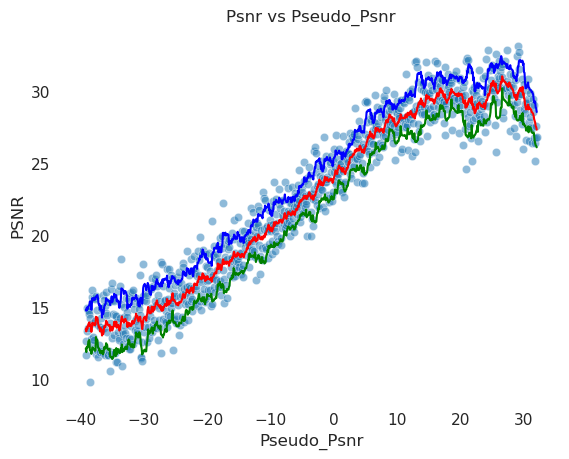

In [38]:
# Generates the plots for the Psnr
plt.Figure(figsize=(10,10))
sns.scatterplot(data = Psnr_Distribution_1, x = "Pseudo_PSNR", y = "PSNR", alpha = 0.5)
sns.lineplot(data = Psnr_Distribution_1, x = "Pseudo_PSNR", y = "PSNR_Average", color = "red")
sns.lineplot(data = Psnr_Distribution_1, x = "Pseudo_PSNR", y = "PSNR_Variance_Upper", color = "blue")
sns.lineplot(data = Psnr_Distribution_1, x = "Pseudo_PSNR", y = "PSNR_Variance_Lower", color = "green")
Psnr_Area_1 = np.trapz(Psnr_Distribution_1["PSNR_Average"].values, Psnr_Distribution_1["Pseudo_PSNR"].values)
#plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve  
plt.xlabel("Pseudo_Psnr")
plt.ylabel("PSNR")
plt.title("Psnr vs Pseudo_Psnr")
plt.show()

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

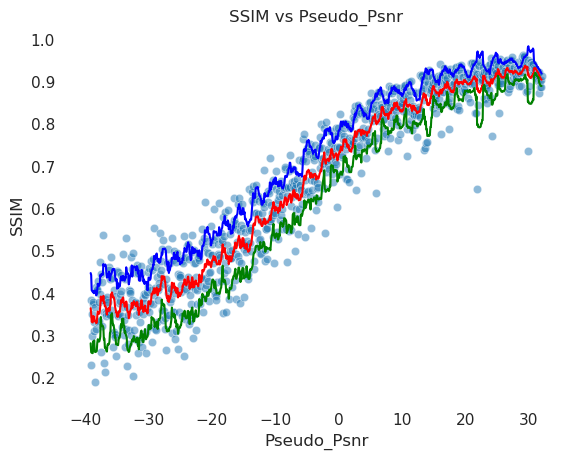

In [39]:
# Generates the plots for the SSIM
plt.Figure(figsize=(10,10))
sns.scatterplot(data = SSIM_Distribution_1, x = "Pseudo_PSNR", y = "SSIM", alpha = 0.5)
sns.lineplot(data = SSIM_Distribution_1, x = "Pseudo_PSNR", y = "SSIM_Average", color = "red")
sns.lineplot(data = SSIM_Distribution_1, x = "Pseudo_PSNR", y = "SSIM_Variance_Upper", color = "blue")
sns.lineplot(data = SSIM_Distribution_1, x = "Pseudo_PSNR", y = "SSIM_Variance_Lower", color = "green")
SSIM_Area_1 = np.trapz(SSIM_Distribution_1["SSIM_Average"].values, SSIM_Distribution_1["Pseudo_PSNR"].values)
#plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve  
plt.xlabel("Pseudo_Psnr")
plt.ylabel("SSIM")
plt.title("SSIM vs Pseudo_Psnr")
plt.show()

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

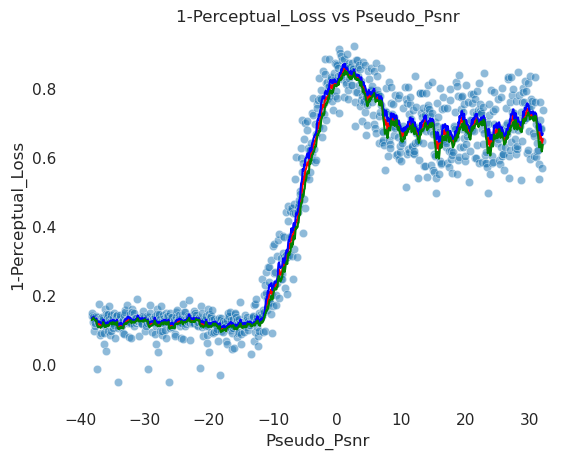

In [40]:
# Generates the plots for the Perceptual Loss
plt.Figure(figsize=(10,10))
sns.scatterplot(data = Perceptual_Distribution_1, x = "Pseudo_PSNR", y = "1-PL", alpha = 0.5)
sns.lineplot(data = Perceptual_Distribution_1, x = "Pseudo_PSNR", y = "1-PL_Average", color = "red")
sns.lineplot(data = Perceptual_Distribution_1, x = "Pseudo_PSNR", y = "1-PL_Variance_Upper", color = "blue")
sns.lineplot(data = Perceptual_Distribution_1, x = "Pseudo_PSNR", y = "1-PL_Variance_Lower", color = "green")
Perceptual_Area_1 = np.trapz(Perceptual_Distribution_1["1-PL_Average"].values, Perceptual_Distribution_1["Pseudo_PSNR"].values)
#plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve  
plt.xlabel("Pseudo_Psnr")
plt.ylabel("1-Perceptual_Loss")
plt.title("1-Perceptual_Loss vs Pseudo_Psnr")
plt.show()

In [41]:
# Prints the Areas under the curve for the Psnr, SSIM and Perceptual Loss.
print(Psnr_Area_1), print(SSIM_Area_1), print(Perceptual_Area_1)

1600.9022383003012
46.90724174343505
31.506219078025246


(None, None, None)

In [42]:
# Generates the summary statistics for the Psnr
print("Mean Psnr",Psnr_Distribution_1["PSNR"].mean())
print("Std Psnr",Psnr_Distribution_1["PSNR"].std()) 
print("Min Psnr",Psnr_Distribution_1["PSNR"].min()) 
print("Max Psnr",Psnr_Distribution_1["PSNR"].max())
print("Mean Roll Var",Psnr_Distribution_1["PSNR_Variance"].mean())

Mean Psnr 22.589360387644238
Std Psnr 6.117493066205897
Min Psnr 9.78831865571559
Max Psnr 33.121026605828604
Mean Roll Var 1.4163168899994347


In [43]:
# Generates the summary statistics for the SSIM
print("Mean SSIM",SSIM_Distribution_1["SSIM"].mean())
print("Std SSIM",SSIM_Distribution_1["SSIM"].std()) 
print("Min SSIM",SSIM_Distribution_1["SSIM"].min()) 
print("Max SSIM",SSIM_Distribution_1["SSIM"].max())
print("Mean Roll SSIM",SSIM_Distribution_1["SSIM_Variance"].mean())

Mean SSIM 0.6629055
Std SSIM 0.21161656081676483
Min SSIM 0.18836744129657745
Max SSIM 0.9605836868286133
Mean Roll SSIM 0.05422405900592413


In [44]:
# Generates the summary statistics for the Perceptual Loss
print("Mean 1-PL",Perceptual_Distribution_1["1-PL"].mean())
print("Std 1-PL",Perceptual_Distribution_1["1-PL"].std()) 
print("Min 1-PL",Perceptual_Distribution_1["1-PL"].min()) 
print("Max 1-PL",Perceptual_Distribution_1["1-PL"].max())
print("Mean Roll 1-PL",Perceptual_Distribution_1["1-PL_Variance"].mean())

Mean 1-PL 0.4518273
Std 1-PL 0.29313045740127563
Min 1-PL -0.053491830825805664
Max 1-PL 0.9201749563217163
Mean Roll 1-PL 0.05583890610785624


In [45]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Starts with the Highest PSNR Range
print(PSNR_Ranges[-1][0], PSNR_Ranges[-1][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-1][0] , maxPSNR = PSNR_Ranges[-1][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-1][0], maxPSNR = PSNR_Ranges[-1][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

24 32


(16384, 4096)

In [46]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

/home/linux/KaylenGAP/MScGAPProject/OriginalGAPUNet.py:256: FutureWarning: `nn.init.xavier_normal` is now deprecated in favor of `nn.init.xavier_normal_`.
  init.xavier_normal(m.weight)
/home/linux/KaylenGAP/MScGAPProject/OriginalGAPUNet.py:257: FutureWarning: `nn.init.constant` is now deprecated in favor of `nn.init.constant_`.
  init.constant(m.bias, 0)


In [47]:
# Creates the directory to save the model in for the Highest PSNR Range.
name = "FaceGenerationUNet128x128-24-32"
CHECKPOINT_PATH = "./models/" 

In [48]:
# Trains the model using the Pytorch Lightning Trainer for the Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)])
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type       | Params | Mode 
--------------------------------------------------
0 | conv_final | Conv2d     | 153    | train
1 | down_convs | ModuleList | 76.8 M | train
2 | up_convs   | ModuleList | 32.4 M | train
--------------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=30` reached.


In [49]:
# Loads the model from the checkpoint for the Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lightning_fabric/utilities/cloud_io.py:57: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
/home/linux/KaylenGAP/MScGAPProjec

In [50]:
# Validates the trained model on the Train Set for the Highest PSNR Range.
Trainer.test(model, Train_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:475: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.17064496874809265    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.17064496874809265}]

In [51]:
# Validates the trained model on the Validation Set for the Highest PSNR Range.
Trainer.test(model, Validation_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.1686168760061264    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.1686168760061264}]

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

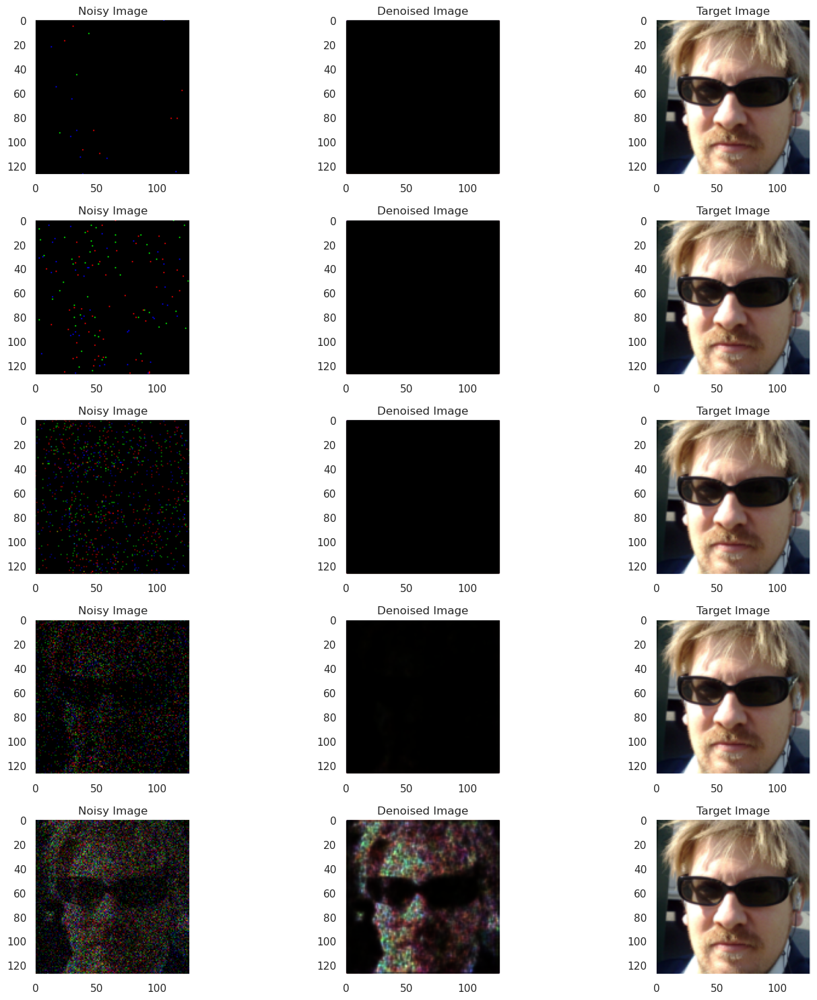

In [52]:
# Plots and visualises the sample Validation Noisy Image, Denoised Image and Target Image across the different noise levels for the Highest PSNR Range.
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

3.2814012 0.0 3.1152544021606445 0.7753521800041199
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: 29.298128128051758
29.298674770192772 29.298675081720624 0.0


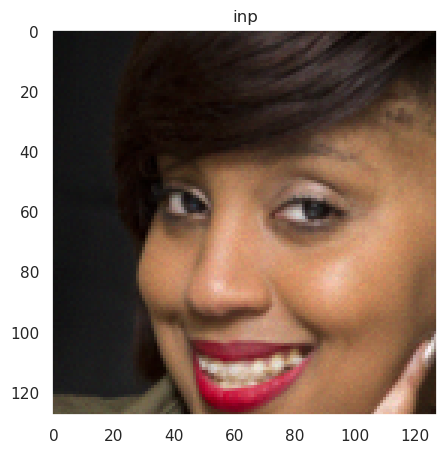

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

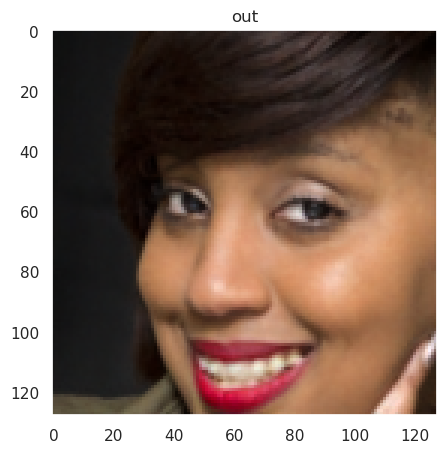

Text(0.5, 1.0, 'GT')

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

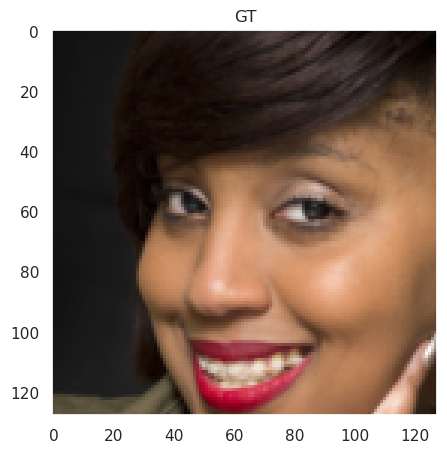

In [53]:
# Generates a smaple image from the dataset, denoises it and evaluates the visual quality of the denoised image
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times New Roman' not found.
findfont: Font family 'Times Ne

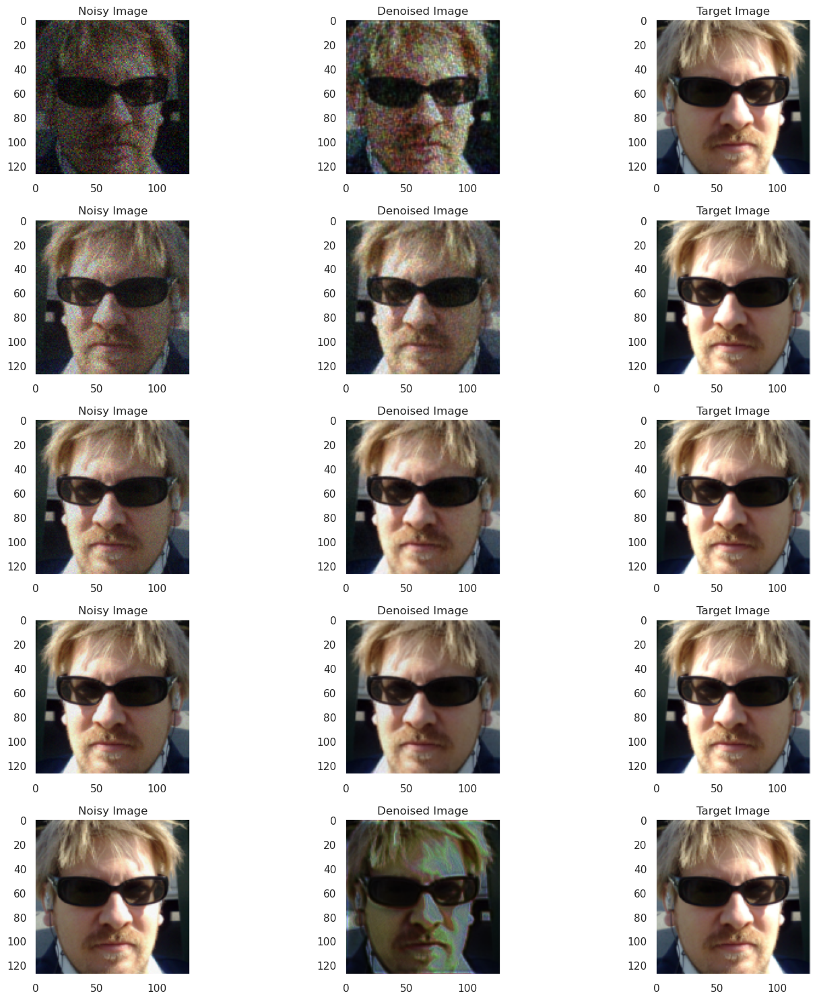

In [54]:
# continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [55]:
lpips_model = lpips.LPIPS(net='alex').to(device)

def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model.eval()
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = torch.zeros(Noisy_Images.shape[0], 3, 128, 128).to(device)
    
    # Process batches correctly without slicing errors
    batch_size = 32
    with torch.no_grad():
        for i in range(0, Noisy_Images.shape[0], batch_size):
            batch_end = min(i + batch_size, Noisy_Images.shape[0])  # Ensure no overflow
            Predictions[i:batch_end] = model(Noisy_Images[i:batch_end]).detach()

        # Adjust predictions after getting model output
        Predictions = torch.exp(Predictions - Predictions.max())  # Handle exp safely to avoid overflow
        Predictions = Noisy_Images.detach().sum(dim=(1, 2, 3), keepdim=True) * Predictions / Predictions.sum(dim=(1, 2, 3), keepdim=True)
        
        perceptual_score = lpips_model(Target_Images, Predictions)
        perceptual_score = 1 - perceptual_score
        
        # Move everything to CPU for further processing
        Noisy_Images = Noisy_Images.cpu().numpy()
        Target_Images = Target_Images.cpu().numpy()
        Predictions = Predictions.cpu().numpy()
        perceptual_score = perceptual_score.cpu().numpy()

        # Normalize Predictions correctly
        Predictions = Predictions / Predictions.mean(axis=(1, 2, 3), keepdims=True)
        
        # Compute PSNR and SSIM scores
        Psnr_Scores = [psnr(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        SSIM_Scores = [ssim(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        
        return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_2 = np.array(Psnr_Distribution)
SSIM_Distribution_2 = np.array(SSIM_Distribution)
Perceptual_Distribution_2 = np.array(Perceptual_Distribution)
Psnr_Distribution_2.shape, SSIM_Distribution_2.shape, Perceptual_Distribution_2.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/weights/v0.1/alex.pth
-40-32


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during u

-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

In [56]:
np.save("Data/Psnr_Distribution_24_32b.npy", Psnr_Distribution_2)
np.save("Data/SSIM_Distribution_24_32b.npy", SSIM_Distribution_2)
np.save("Data/Perceptual_Distribution_24_32b.npy", Perceptual_Distribution_2)

In [57]:
# Generates the dataframe for the Psnr
Psnr_Distribution_2 = pd.DataFrame(Psnr_Distribution_2, columns = ["PSNR"])
Psnr_Distribution_2["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Psnr_Distribution_2.shape[0])
Psnr_Distribution_2["PSNR_Average"] = Psnr_Distribution_2["PSNR"].rolling(window = 12).mean()
Psnr_Distribution_2["PSNR_Variance"] = Psnr_Distribution_2["PSNR"].rolling(window = 12).std()
Psnr_Distribution_2["PSNR_Variance_Upper"] = Psnr_Distribution_2["PSNR_Average"] + Psnr_Distribution_2["PSNR"].rolling(window = 12).std()
Psnr_Distribution_2["PSNR_Variance_Lower"] = Psnr_Distribution_2["PSNR_Average"] - Psnr_Distribution_2["PSNR"].rolling(window = 12).std()
Psnr_Distribution_2.dropna(inplace = True)
Psnr_Distribution_2.describe()

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,9.416561,-3.559511,9.119183,1.706303,10.825485,7.412880
std,18.710578,20.564969,18.561606,0.429543,18.468340,18.664295
min,-14.613057,-39.119021,-11.247163,0.496702,-9.857685,-12.886856
25%,-9.112821,-21.339266,-9.564141,1.407634,-7.719402,-11.286513
50%,7.770703,-3.559511,6.997524,1.691449,8.553680,5.640100
75%,27.512507,14.220245,27.066045,2.021396,28.787461,25.150449
max,42.707723,32.000000,40.035693,2.982605,41.896969,38.509125


In [58]:
# Generates the dataframe for the SSIM
SSIM_Distribution_2 = pd.DataFrame(SSIM_Distribution_2, columns = ["SSIM"])
SSIM_Distribution_2["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, SSIM_Distribution_2.shape[0])
SSIM_Distribution_2["SSIM_Average"] = SSIM_Distribution_2["SSIM"].rolling(window = 12).mean()
SSIM_Distribution_2["SSIM_Variance"] = SSIM_Distribution_2["SSIM"].rolling(window = 12).std()
SSIM_Distribution_2["SSIM_Variance_Upper"] = SSIM_Distribution_2["SSIM_Average"] + SSIM_Distribution_2["SSIM"].rolling(window = 12).std()
SSIM_Distribution_2["SSIM_Variance_Lower"] = SSIM_Distribution_2["SSIM_Average"] - SSIM_Distribution_2["SSIM"].rolling(window = 12).std()
SSIM_Distribution_2.dropna(inplace = True)
SSIM_Distribution_2.describe()

,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.433440,-3.559511,0.428173,0.049201,0.477374,0.378972
std,0.318583,20.564969,0.311475,0.032277,0.316380,0.309871
min,0.088157,-39.119021,0.126850,0.002916,0.143643,0.095566
25%,0.161987,-21.339266,0.154558,0.025549,0.187156,0.126100
50%,0.281900,-3.559511,0.273357,0.038060,0.332264,0.215308
75%,0.771296,14.220245,0.748488,0.067717,0.841322,0.670852
max,0.990226,32.000000,0.984482,0.155613,0.993570,0.981261


In [59]:
# Generates the dataframe for the Perceptual Loss
Perceptual_Distribution_2 = pd.DataFrame(Perceptual_Distribution_2, columns = ["1-PL"])
Perceptual_Distribution_2["Pseudo_PSNR"] = np.linspace(minpsnr, maxpsnr, Perceptual_Distribution_2.shape[0])
Perceptual_Distribution_2["1-PL_Average"] = Perceptual_Distribution_2["1-PL"].rolling(window = 12).mean()
Perceptual_Distribution_2["1-PL_Variance"] = Perceptual_Distribution_2["1-PL"].rolling(window = 12).std()
Perceptual_Distribution_2["1-PL_Variance_Upper"] = Perceptual_Distribution_2["1-PL_Average"] + Perceptual_Distribution_2["1-PL_Average"].rolling(window = 12).std()
Perceptual_Distribution_2["1-PL_Variance_Lower"] = Perceptual_Distribution_2["1-PL_Average"] - Perceptual_Distribution_2["1-PL_Average"].rolling(window = 12).std()
Perceptual_Distribution_2.dropna(inplace = True)
Perceptual_Distribution_2.describe()

,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.400678,-3.119021,0.396999,0.059676,0.406650,0.387348
std,0.229173,20.310653,0.219226,0.032281,0.223075,0.215506
min,-0.049960,-38.238042,0.105851,0.011536,0.107964,0.101885
25%,0.175461,-20.678532,0.172025,0.028819,0.175967,0.166705
50%,0.391156,-3.119021,0.424192,0.055231,0.436642,0.410290
75%,0.597679,14.440489,0.611440,0.084932,0.624227,0.597140
max,0.872726,32.000000,0.766319,0.150830,0.782714,0.755614


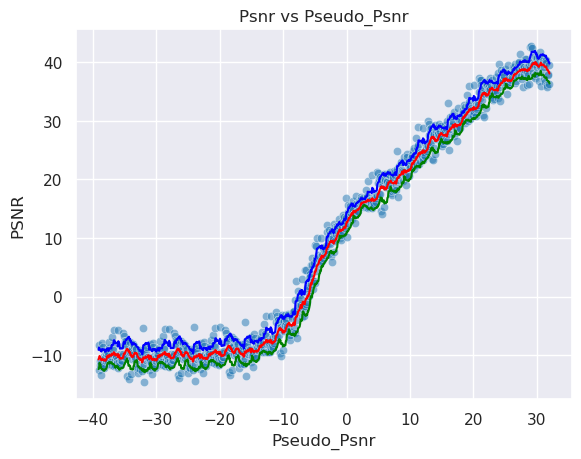

In [60]:
# Generates the plots for the Psnr
plt.Figure(figsize=(10,10))
sns.set_style("darkgrid")
sns.scatterplot(data = Psnr_Distribution_2, x = "Pseudo_PSNR", y = "PSNR", alpha = 0.5)
sns.lineplot(data = Psnr_Distribution_2, x = "Pseudo_PSNR", y = "PSNR_Average", color = "red")
sns.lineplot(data = Psnr_Distribution_2, x = "Pseudo_PSNR", y = "PSNR_Variance_Upper", color = "blue")
sns.lineplot(data = Psnr_Distribution_2, x = "Pseudo_PSNR", y = "PSNR_Variance_Lower", color = "green")
Psnr_Area_2 = np.trapz(Psnr_Distribution_2["PSNR_Average"].values, Psnr_Distribution_2["Pseudo_PSNR"].values)
#plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve  
plt.xlabel("Pseudo_Psnr")
plt.ylabel("PSNR")
plt.title("Psnr vs Pseudo_Psnr")
plt.show()

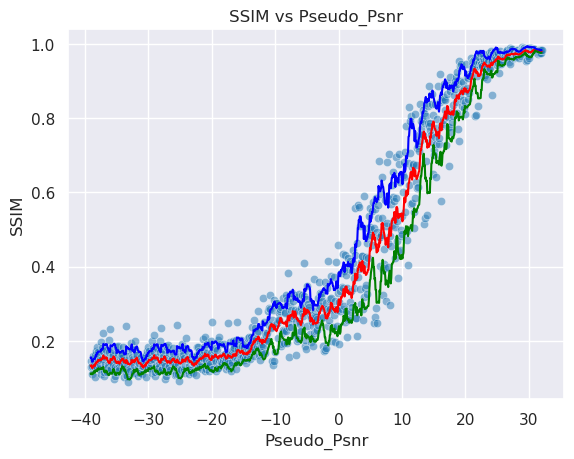

In [61]:
# Generates the plots for the SSIM
plt.Figure(figsize=(10,10))
sns.set_style("darkgrid")
sns.scatterplot(data = SSIM_Distribution_2, x = "Pseudo_PSNR", y = "SSIM", alpha = 0.5)
sns.lineplot(data = SSIM_Distribution_2, x = "Pseudo_PSNR", y = "SSIM_Average", color = "red")
sns.lineplot(data = SSIM_Distribution_2, x = "Pseudo_PSNR", y = "SSIM_Variance_Upper", color = "blue")
sns.lineplot(data = SSIM_Distribution_2, x = "Pseudo_PSNR", y = "SSIM_Variance_Lower", color = "green")
SSIM_Area_2 = np.trapz(SSIM_Distribution_2["SSIM_Average"].values, SSIM_Distribution_2["Pseudo_PSNR"].values)
#plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve  
plt.xlabel("Pseudo_Psnr")
plt.ylabel("SSIM")
plt.title("SSIM vs Pseudo_Psnr")
plt.show()

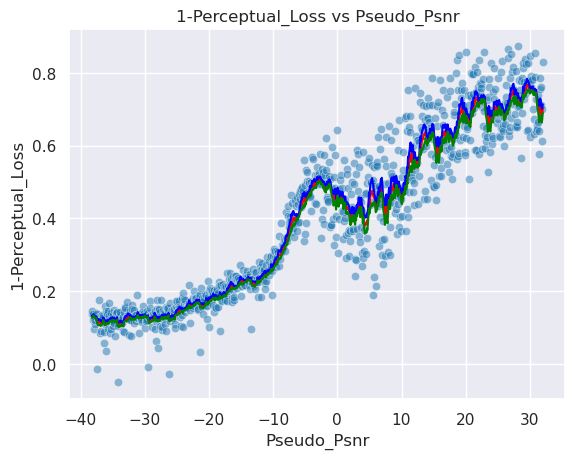

In [62]:
# Generates the plots for the Perceptual Loss
plt.Figure(figsize=(10,10))
sns.scatterplot(data = Perceptual_Distribution_2, x = "Pseudo_PSNR", y = "1-PL", alpha = 0.5)
sns.lineplot(data = Perceptual_Distribution_2, x = "Pseudo_PSNR", y = "1-PL_Average", color = "red")
sns.lineplot(data = Perceptual_Distribution_2, x = "Pseudo_PSNR", y = "1-PL_Variance_Upper", color = "blue")
sns.lineplot(data = Perceptual_Distribution_2, x = "Pseudo_PSNR", y = "1-PL_Variance_Lower", color = "green")
Perceptual_Area_2 = np.trapz(Perceptual_Distribution_2["1-PL_Average"].values, Perceptual_Distribution_2["Pseudo_PSNR"].values)
#plt.fill_between(Psnr_Distribution_1["Pseudo_PSNR"].values, Psnr_Distribution_1["PSNR"].values, color='skyblue', alpha=0.4)  # Optional: Fill under the curve  
plt.xlabel("Pseudo_Psnr")
plt.ylabel("1-Perceptual_Loss")
plt.title("1-Perceptual_Loss vs Pseudo_Psnr")
plt.show()

In [63]:
# Prints the Areas under the curve for the Psnr, SSIM and Perceptual Loss.
print(Psnr_Area_2), print(SSIM_Area_2), print(Perceptual_Area_2)

648.1833538136336
30.44100617762402
27.882903014924025


(None, None, None)

In [64]:
# Generates the summary statistics for the Psnr
print("Mean Psnr",Psnr_Distribution_2["PSNR"].mean())
print("Std Psnr",Psnr_Distribution_2["PSNR"].std()) 
print("Min Psnr",Psnr_Distribution_2["PSNR"].min()) 
print("Max Psnr",Psnr_Distribution_2["PSNR"].max())
print("Mean Roll Var",Psnr_Distribution_2["PSNR_Variance"].mean())

Mean Psnr 9.416560894527288
Std Psnr 18.71057848095575
Min Psnr -14.613056967933655
Max Psnr 42.707722797918315
Mean Roll Var 1.7063026814898894


In [65]:
# Generates the summary statistics for the SSIM
print("Mean SSIM",SSIM_Distribution_2["SSIM"].mean())
print("Std SSIM",SSIM_Distribution_2["SSIM"].std()) 
print("Min SSIM",SSIM_Distribution_2["SSIM"].min()) 
print("Max SSIM",SSIM_Distribution_2["SSIM"].max())
print("Mean Roll SSIM",SSIM_Distribution_2["SSIM_Variance"].mean())

Mean SSIM 0.43343955
Std SSIM 0.3185831904411316
Min SSIM 0.08815672993659973
Max SSIM 0.9902264475822449
Mean Roll SSIM 0.049201196979985394


In [66]:
# Generates the summary statistics for the Perceptual Loss
print("Mean 1-PL",Perceptual_Distribution_2["1-PL"].mean())
print("Std 1-PL",Perceptual_Distribution_2["1-PL"].std()) 
print("Min 1-PL",Perceptual_Distribution_2["1-PL"].min()) 
print("Max 1-PL",Perceptual_Distribution_2["1-PL"].max())
print("Mean Roll 1-PL",Perceptual_Distribution_2["1-PL_Variance"].mean())

Mean 1-PL 0.40067774
Std 1-PL 0.229172945022583
Min 1-PL -0.049959659576416016
Max 1-PL 0.8727255463600159
Mean Roll 1-PL 0.0596755772450153


In [67]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Second Highest PSNR Range
print(PSNR_Ranges[-2][0], PSNR_Ranges[-2][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-2][0] , maxPSNR = PSNR_Ranges[-2][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-2][0], maxPSNR = PSNR_Ranges[-2][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

16 24


(16384, 4096)

In [68]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

/home/linux/KaylenGAP/MScGAPProject/OriginalGAPUNet.py:256: FutureWarning: `nn.init.xavier_normal` is now deprecated in favor of `nn.init.xavier_normal_`.
  init.xavier_normal(m.weight)
/home/linux/KaylenGAP/MScGAPProject/OriginalGAPUNet.py:257: FutureWarning: `nn.init.constant` is now deprecated in favor of `nn.init.constant_`.
  init.constant(m.bias, 0)


In [69]:
# Creates the directory to save the model in for the Second Highest PSNR Range.
name = "FaceGenerationUNet128x128-16-24"
CHECKPOINT_PATH = "./models/" 

In [70]:
# Trains the model using the Pytorch Lightning Trainer for the Second Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)])
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
Missing logger folder: models/FaceGenerationUNet128x128-16-24/lightning_logs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type       | Params | Mode 
--------------------------------------------------
0 | conv_final | Conv2d     | 153    | train
1 | down_convs | ModuleList | 76.8 M | train
2 | up_convs   | ModuleList | 32.4 M | train
--------------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=30` reached.


In [71]:
# Validations the trained model on the Train Set for the Second Highest PSNR Range.
Trainer.test(model, Train_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:475: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.16853205859661102    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.16853205859661102}]

In [72]:
# Validates the trained model on the Validation Set for the Second Highest PSNR Range.
Trainer.test(model, Validation_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.1684304028749466    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.1684304028749466}]

In [73]:
# Loads the model from the checkpoint for the Second Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lightning_fabric/utilities/cloud_io.py:57: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.


2.661807 0.021379977 2.5121474266052246 1.0262389183044434
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: 23.15789222717285
23.159540822615533 23.159540822615533 0.0


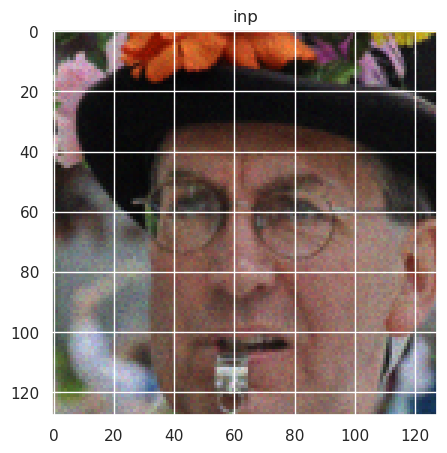

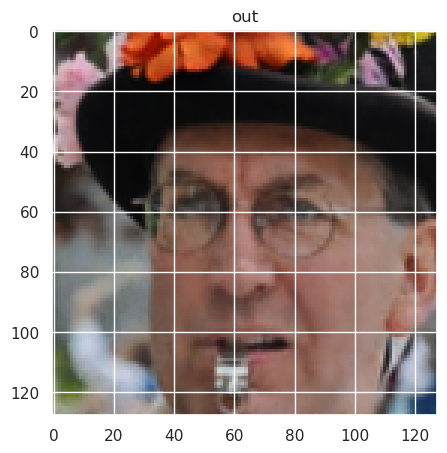

Text(0.5, 1.0, 'GT')

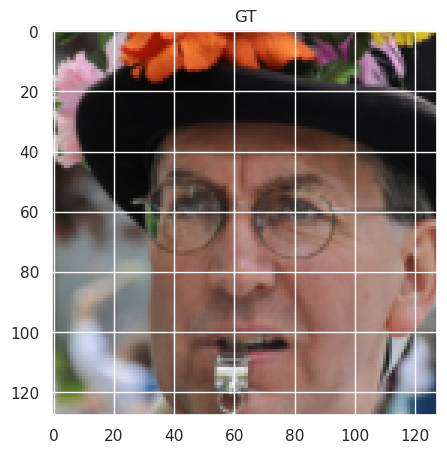

In [74]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

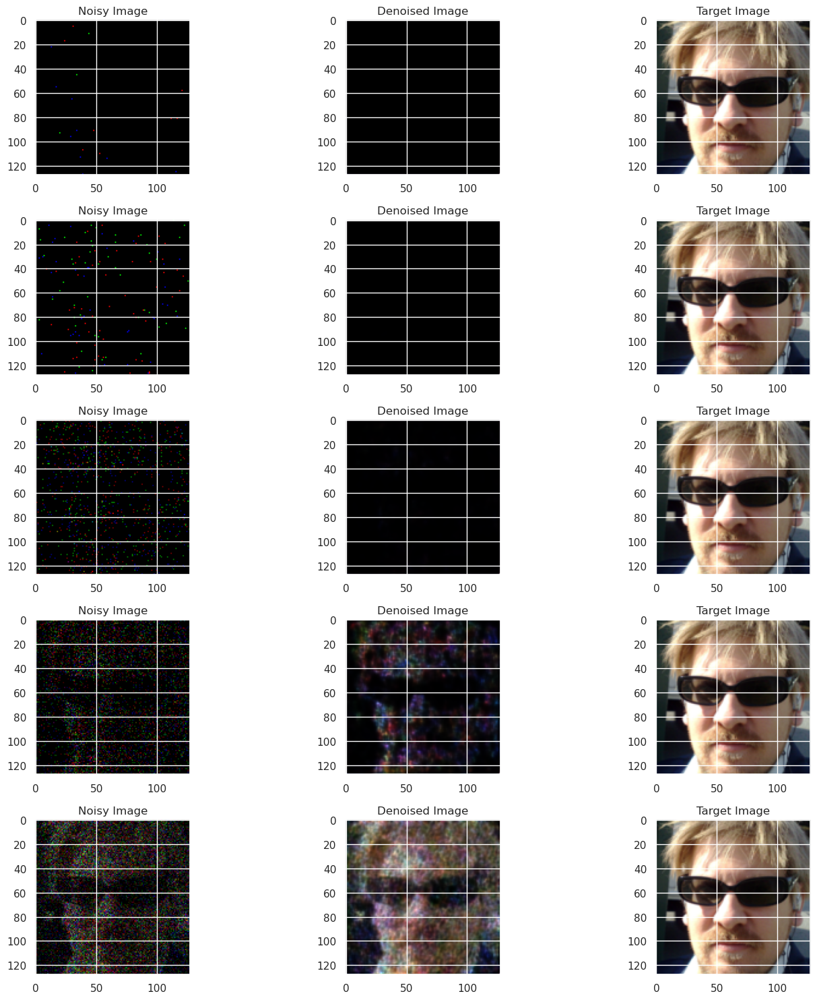

In [75]:
# Plots for a sample image the Noisy Image, its corresponding denoised image 
# and the target image for the Second Highest PSNR Range.
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

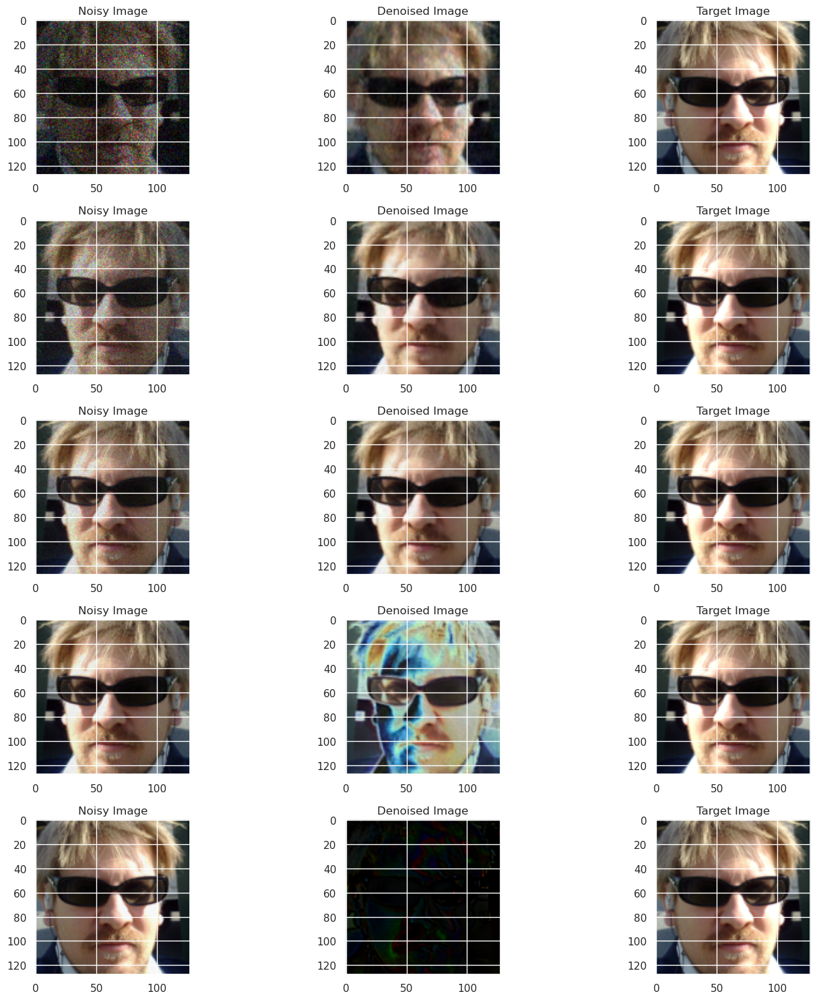

In [76]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [77]:
lpips_model = lpips.LPIPS(net='alex').to(device)

def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model.eval()
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = torch.zeros(Noisy_Images.shape[0], 3, 128, 128).to(device)
    
    # Process batches correctly without slicing errors
    batch_size = 32
    with torch.no_grad():
        for i in range(0, Noisy_Images.shape[0], batch_size):
            batch_end = min(i + batch_size, Noisy_Images.shape[0])  # Ensure no overflow
            Predictions[i:batch_end] = model(Noisy_Images[i:batch_end]).detach()

        # Adjust predictions after getting model output
        Predictions = torch.exp(Predictions - Predictions.max())  # Handle exp safely to avoid overflow
        Predictions = Noisy_Images.detach().sum(dim=(1, 2, 3), keepdim=True) * Predictions / Predictions.sum(dim=(1, 2, 3), keepdim=True)
        
        perceptual_score = lpips_model(Target_Images, Predictions)
        perceptual_score = 1 - perceptual_score
        
        # Move everything to CPU for further processing
        Noisy_Images = Noisy_Images.cpu().numpy()
        Target_Images = Target_Images.cpu().numpy()
        Predictions = Predictions.cpu().numpy()
        perceptual_score = perceptual_score.cpu().numpy()

        # Normalize Predictions correctly
        Predictions = Predictions / Predictions.mean(axis=(1, 2, 3), keepdims=True)
        
        # Compute PSNR and SSIM scores
        Psnr_Scores = [psnr(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        SSIM_Scores = [ssim(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        
        return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_3 = np.array(Psnr_Distribution)
SSIM_Distribution_3 = np.array(SSIM_Distribution)
Perceptual_Distribution_3 = np.array(Perceptual_Distribution)
Psnr_Distribution_3.shape, SSIM_Distribution_3.shape, Perceptual_Distribution_3.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/weights/v0.1/alex.pth
-40-32


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(model_pa

-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

In [78]:
np.save("Data/Psnr_Distribution_16_32b.npy", Psnr_Distribution_3)
np.save("Data/SSIM_Distribution_16_32b.npy", SSIM_Distribution_3)
np.save("Data/Perceptual_Distribution_16_32b.npy", Perceptual_Distribution_3)

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,11.686738,-3.559511,11.525836,1.748575,13.274411,9.777261
std,18.125733,20.564969,18.147638,0.645901,18.079594,18.238317
min,-17.902279,-39.119021,-14.639460,0.761360,-13.204109,-16.380879
25%,-8.804879,-21.339266,-9.379402,1.321553,-7.994215,-10.818340
50%,14.988739,-3.559511,15.508944,1.661956,17.363368,13.528705
75%,28.261662,14.220245,28.533090,1.985700,30.098254,27.183275
max,38.543272,32.000000,36.310874,5.090263,37.773614,35.259148


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.460981,-3.559511,0.459263,0.048609,0.507872,0.410654
std,0.348354,20.564969,0.344620,0.033483,0.345200,0.347282
min,0.052944,-39.119021,0.093700,0.006421,0.106545,0.071853
25%,0.126682,-21.339266,0.120192,0.021453,0.150391,0.092549
50%,0.328119,-3.559511,0.312702,0.038253,0.420340,0.215387
75%,0.852846,14.220245,0.839524,0.072180,0.900990,0.796789
max,0.979199,32.000000,0.968058,0.200197,0.980967,0.961637


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.422113,-3.119021,0.419545,0.057036,0.429045,0.410044
std,0.240226,20.310653,0.233480,0.026166,0.236932,0.230125
min,-0.049556,-38.238042,0.106331,0.011702,0.108444,0.102236
25%,0.175375,-20.678532,0.162690,0.034061,0.167260,0.158026
50%,0.378708,-3.119021,0.361980,0.055331,0.377449,0.350028
75%,0.645222,14.440489,0.676433,0.079729,0.692508,0.657340
max,0.866696,32.000000,0.760471,0.119319,0.774575,0.749766


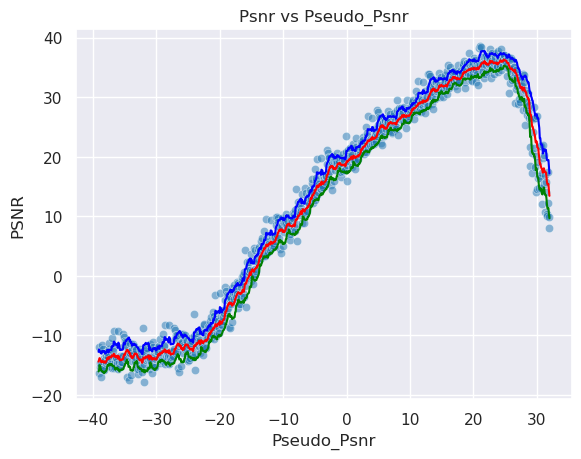

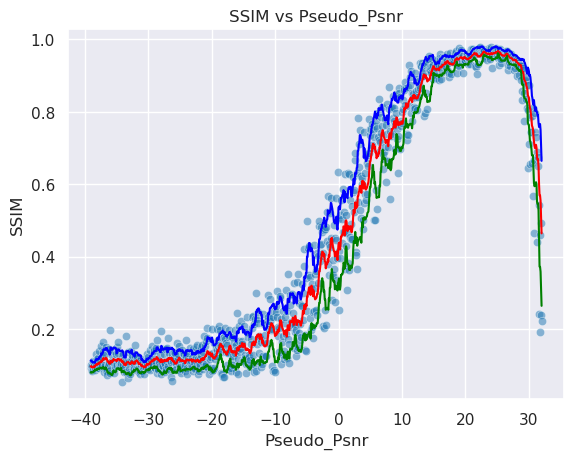

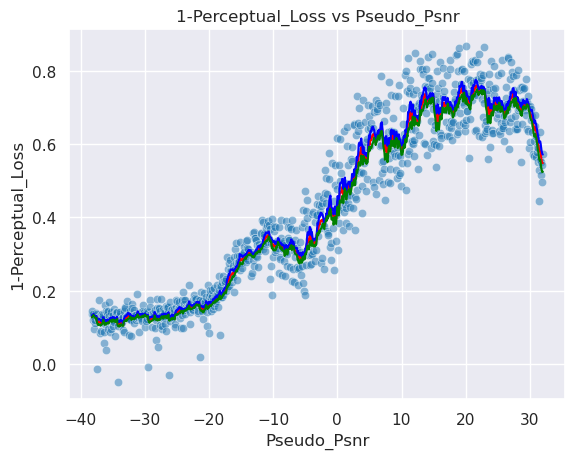

Psnr Area: 820.6704285931874, SSIM Area: 32.67668045285646, Perceptual Area: 29.474467668371553
Mean Psnr 11.686737772753213
Std Psnr 18.125733036001503
Min Psnr -17.902279163611947
Max Psnr 38.54327203281837
Mean Roll Var 1.7485751137961776
Mean SSIM 0.46098077
Std SSIM 0.3483535647392273
Min SSIM 0.05294381454586983
Max SSIM 0.9791991710662842
Mean Roll SSIM 0.048609325372133035
Mean 1-PL 0.42211345
Std 1-PL 0.24022561311721802
Min 1-PL -0.04955554008483887
Max 1-PL 0.866695761680603
Mean Roll 1-PL 0.05703566825385378


(820.6704285931874, 32.67668045285646, 29.474467668371553)

In [79]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Second Highest PSNR Range.
Plot_Creater(Psnr_Distribution_3, SSIM_Distribution_3, Perceptual_Distribution_3, minpsnr, maxpsnr)

In [179]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Third Highest PSNR Range
print(PSNR_Ranges[-3][0], PSNR_Ranges[-3][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-3][0] , maxPSNR = PSNR_Ranges[-3][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-3][0], maxPSNR = PSNR_Ranges[-3][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

8 16


(16384, 4096)

In [180]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

/home/linux/KaylenGAP/MScGAPProject/OriginalGAPUNet.py:256: FutureWarning: `nn.init.xavier_normal` is now deprecated in favor of `nn.init.xavier_normal_`.
  init.xavier_normal(m.weight)
/home/linux/KaylenGAP/MScGAPProject/OriginalGAPUNet.py:257: FutureWarning: `nn.init.constant` is now deprecated in favor of `nn.init.constant_`.
  init.constant(m.bias, 0)


In [181]:
# Creates the directory to save the model in for the Third Highest PSNR Range.
name = "FaceGenerationUNet128x128-8-16"
CHECKPOINT_PATH = "./models/" 

In [182]:
# Trains the model using the Pytorch Lightning Trainer for the Third Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)])

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


In [183]:
# Trains the model using the Pytorch Lightning Trainer for the Third Highest PSNR Range.
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type       | Params | Mode 
--------------------------------------------------
0 | conv_final | Conv2d     | 153    | train
1 | down_convs | ModuleList | 76.8 M | train
2 | up_convs   | ModuleList | 32.4 M | train
--------------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=30` reached.


In [184]:
# Loads the model from the checkpoint for the Third Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lightning_fabric/utilities/cloud_io.py:57: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.


In [185]:
# Validates the trained model on the Train Set for the Third Highest PSNR Range.
Trainer.test(model, Train_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:475: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.16844838857650757    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.16844838857650757}]

In [186]:
# Validates the trained model on the Validation Set for the Third Highest PSNR Range.
Trainer.test(model, Validation_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.1674366295337677    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.1674366295337677}]

2.1788828 0.034178555 2.1788828372955322 0.8544638752937317
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: 8.169720649719238
8.165439030825384 8.165438714881091 0.0


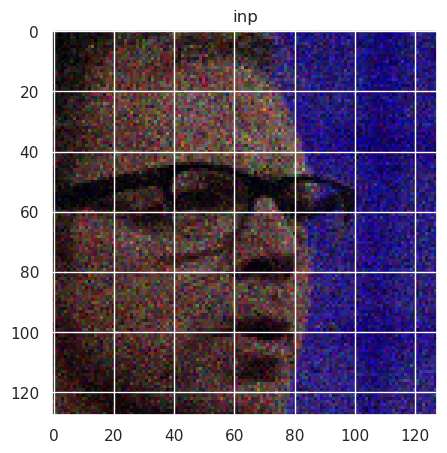

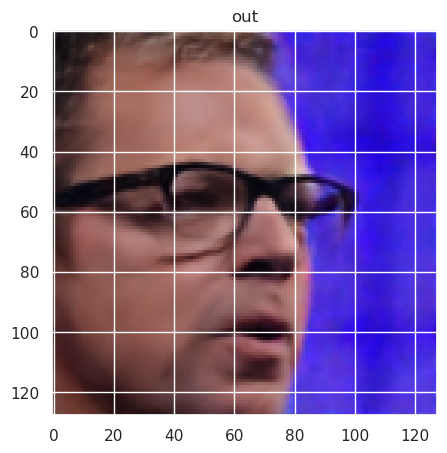

Text(0.5, 1.0, 'GT')

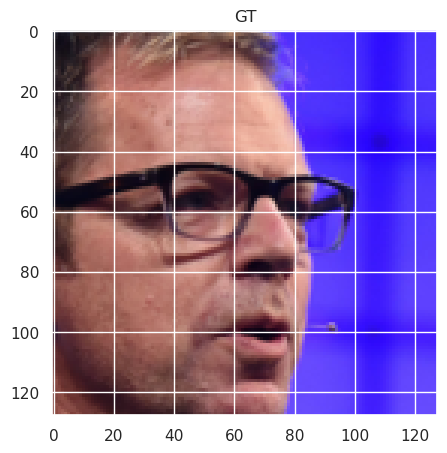

In [187]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

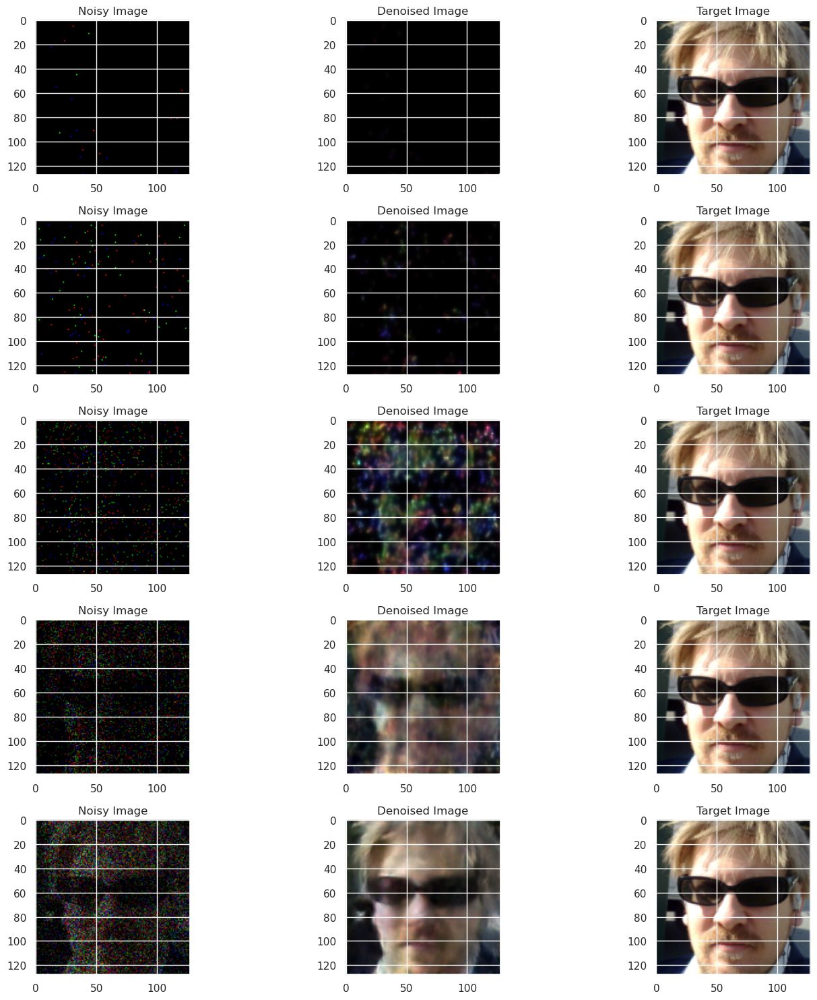

In [188]:
# Plots for a sample image the Noisy Image, its corresponding denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

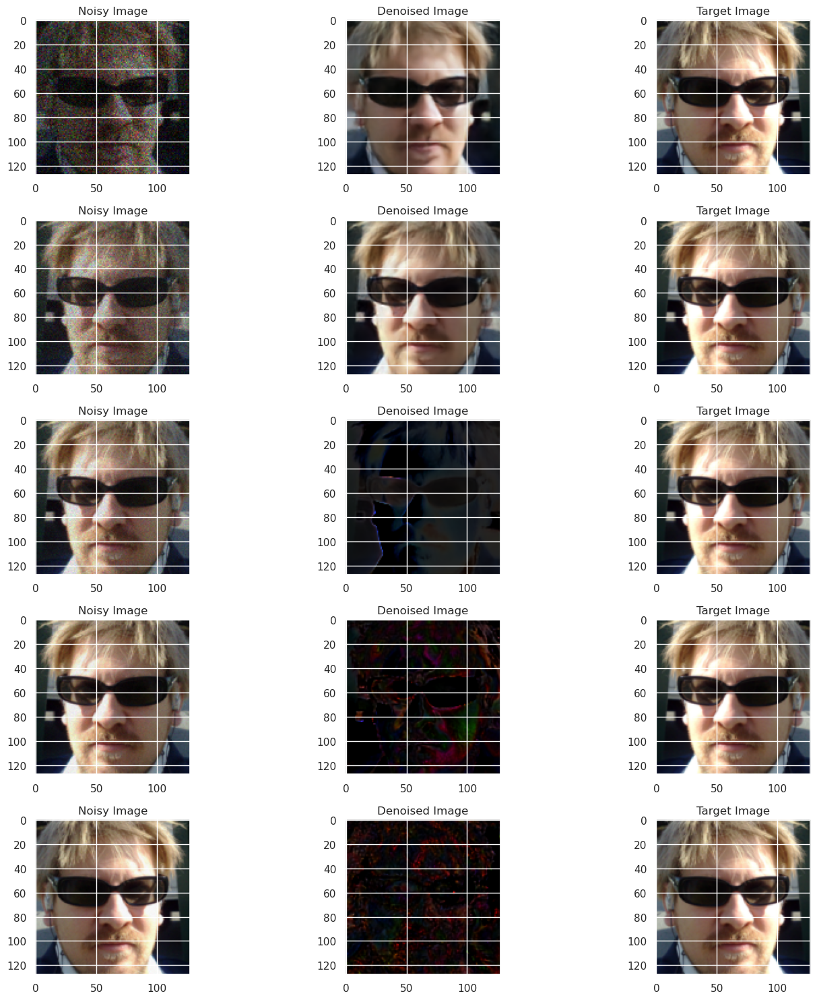

In [189]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [190]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Third Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)

def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model.eval()
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = torch.zeros(Noisy_Images.shape[0], 3, 128, 128).to(device)
    
    # Process batches correctly without slicing errors
    batch_size = 32
    with torch.no_grad():
        for i in range(0, Noisy_Images.shape[0], batch_size):
            batch_end = min(i + batch_size, Noisy_Images.shape[0])  # Ensure no overflow
            Predictions[i:batch_end] = model(Noisy_Images[i:batch_end]).detach()

        # Adjust predictions after getting model output
        Predictions = torch.exp(Predictions - Predictions.max())  # Handle exp safely to avoid overflow
        Predictions = Noisy_Images.detach().sum(dim=(1, 2, 3), keepdim=True) * Predictions / Predictions.sum(dim=(1, 2, 3), keepdim=True)
        
        perceptual_score = lpips_model(Target_Images, Predictions)
        perceptual_score = 1 - perceptual_score
        
        # Move everything to CPU for further processing
        Noisy_Images = Noisy_Images.cpu().numpy()
        Target_Images = Target_Images.cpu().numpy()
        Predictions = Predictions.cpu().numpy()
        perceptual_score = perceptual_score.cpu().numpy()

        # Normalize Predictions correctly
        Predictions = Predictions / Predictions.mean(axis=(1, 2, 3), keepdims=True)
        
        # Compute PSNR and SSIM scores
        Psnr_Scores = [psnr(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        SSIM_Scores = [ssim(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        
        return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_4 = np.array(Psnr_Distribution)
SSIM_Distribution_4 = np.array(SSIM_Distribution)
Perceptual_Distribution_4 = np.array(Perceptual_Distribution)
Psnr_Distribution_4.shape, SSIM_Distribution_4.shape, Perceptual_Distribution_4.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/weights/v0.1/alex.pth
-40-32


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(model_pa

-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

In [191]:
np.save("Data/Psnr_Distribution_8_32b.npy", Psnr_Distribution_4)
np.save("Data/SSIM_Distribution_8_32b.npy", SSIM_Distribution_4)
np.save("Data/Perceptual_Distribution_8_32b.npy", Perceptual_Distribution_4)

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,13.141565,-3.559511,13.068927,1.796336,14.865263,11.272591
std,13.316249,20.564969,13.253587,0.918360,13.169424,13.400305
min,-9.671450,-39.119021,-7.592705,0.529777,-6.158174,-9.343539
25%,1.590298,-21.339266,1.292379,1.250028,3.556808,-1.022562
50%,12.805613,-3.559511,12.557453,1.582358,14.471705,10.182262
75%,25.381382,14.220245,25.507140,2.021110,27.214049,23.270910
max,35.563826,32.000000,33.741615,5.947734,35.829216,32.807940


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.397226,-3.559511,0.398028,0.051057,0.449086,0.346971
std,0.354215,20.564969,0.348549,0.034592,0.347256,0.353241
min,-0.358614,-39.119021,-0.112189,0.009649,-0.041337,-0.211017
25%,0.095460,-21.339266,0.100938,0.029335,0.135011,0.059596
50%,0.229443,-3.559511,0.244108,0.044719,0.316485,0.141560
75%,0.780367,14.220245,0.782724,0.063930,0.838730,0.714010
max,0.962400,32.000000,0.945885,0.259296,0.976474,0.935619


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.435015,-3.119021,0.433545,0.048023,0.442499,0.424591
std,0.262370,20.310653,0.258485,0.022039,0.261924,0.255192
min,-0.051519,-38.238042,0.104536,0.012122,0.106690,0.100744
25%,0.199295,-20.678532,0.202655,0.028680,0.206298,0.198402
50%,0.387478,-3.119021,0.409878,0.045295,0.421655,0.398083
75%,0.700033,14.440489,0.726936,0.064620,0.737931,0.713806
max,0.925950,32.000000,0.849282,0.124691,0.858541,0.840023


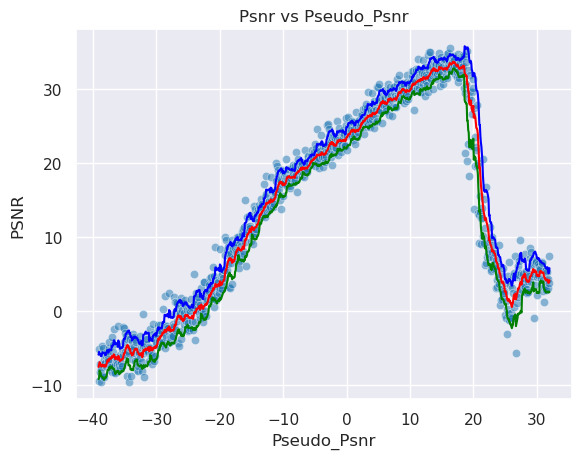

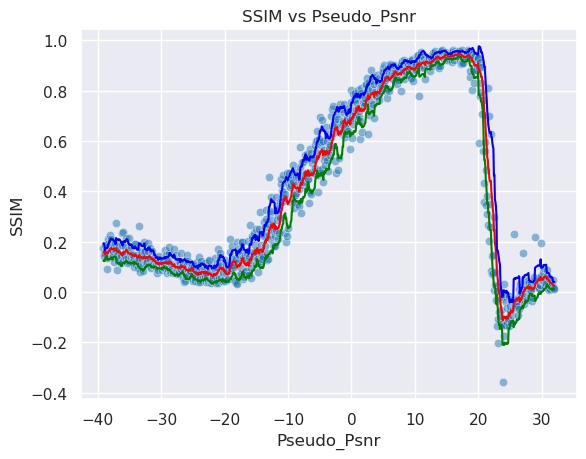

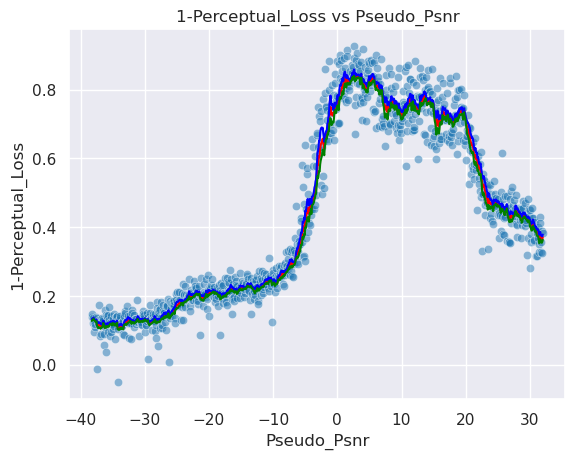

Psnr Area: 930.6340150486315, SSIM Area: 28.33190940262064, Perceptual Area: 30.466060775273107
Mean Psnr 13.141565206834379
Std Psnr 13.316248746752022
Min Psnr -9.671450057981488
Max Psnr 35.56382642730731
Mean Roll Var 1.796335760395025
Mean SSIM 0.3972256
Std SSIM 0.3542153537273407
Min SSIM -0.3586139678955078
Max SSIM 0.9624001979827881
Mean Roll SSIM 0.051057316356513206
Mean 1-PL 0.4350155
Std 1-PL 0.2623700797557831
Min 1-PL -0.051518917083740234
Max 1-PL 0.9259495139122009
Mean Roll 1-PL 0.048022739339624664


(930.6340150486315, 28.33190940262064, 30.466060775273107)

In [192]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Third Highest PSNR Range.
Plot_Creater(Psnr_Distribution_4, SSIM_Distribution_4, Perceptual_Distribution_4, minpsnr, maxpsnr)

In [193]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Fourth Highest PSNR Range
print(PSNR_Ranges[-4][0], PSNR_Ranges[-4][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-4][0] , maxPSNR = PSNR_Ranges[-4][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-4][0], maxPSNR = PSNR_Ranges[-4][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

0 8


(16384, 4096)

In [194]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

/home/linux/KaylenGAP/MScGAPProject/OriginalGAPUNet.py:256: FutureWarning: `nn.init.xavier_normal` is now deprecated in favor of `nn.init.xavier_normal_`.
  init.xavier_normal(m.weight)
/home/linux/KaylenGAP/MScGAPProject/OriginalGAPUNet.py:257: FutureWarning: `nn.init.constant` is now deprecated in favor of `nn.init.constant_`.
  init.constant(m.bias, 0)


In [96]:
# Creates the directory to save the model in for the Fourth Highest PSNR Range.
name = "FaceGenerationUNet128x128-0-8"
CHECKPOINT_PATH = "./models/" 

In [97]:
# Trains the model using the Pytorch Lightning Trainer for the Fourth Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)])

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


In [98]:
# Trains the model using the Pytorch Lightning Trainer for the Fourth Highest PSNR Range.
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

Missing logger folder: models/FaceGenerationUNet128x128-0-8/lightning_logs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type       | Params | Mode 
--------------------------------------------------
0 | conv_final | Conv2d     | 153    | train
1 | down_convs | ModuleList | 76.8 M | train
2 | up_convs   | ModuleList | 32.4 M | train
--------------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=30` reached.


In [99]:
# Loads the model from the checkpoint for the Fourth Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lightning_fabric/utilities/cloud_io.py:57: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.


In [100]:
# Validates the trained model on the Train Set for the Fourth Highest PSNR Range.
Trainer.test(model, Train_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:475: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.16663052141666412    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.16663052141666412}]

In [101]:
# Validates the trained model on the Validation Set for the Fourth Highest PSNR Range.
Trainer.test(model, Validation_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.1638953685760498    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.1638953685760498}]

2.6614892 0.05239152 2.6195759773254395 0.9116124510765076
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: 2.677083969116211
2.684250713677188 2.6842509927190275 -2.588596909321764e-07


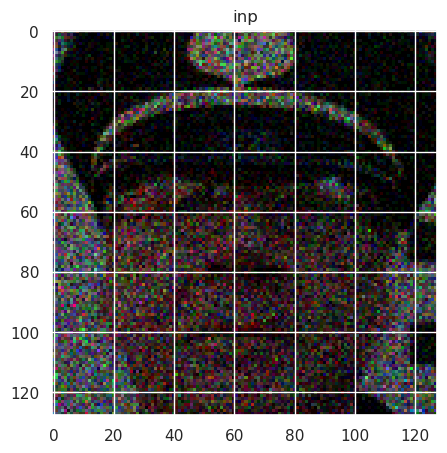

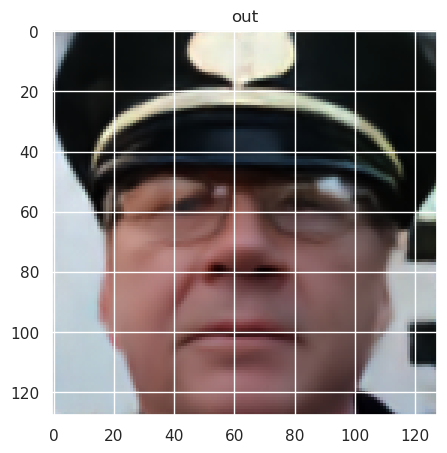

Text(0.5, 1.0, 'GT')

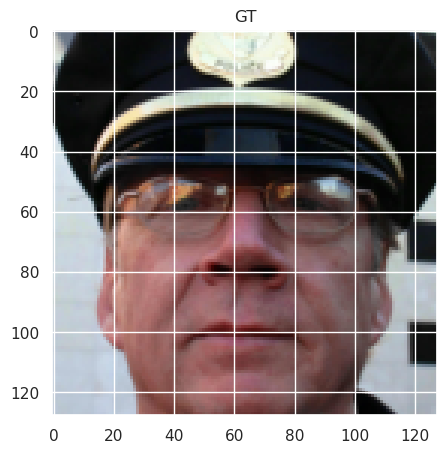

In [102]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

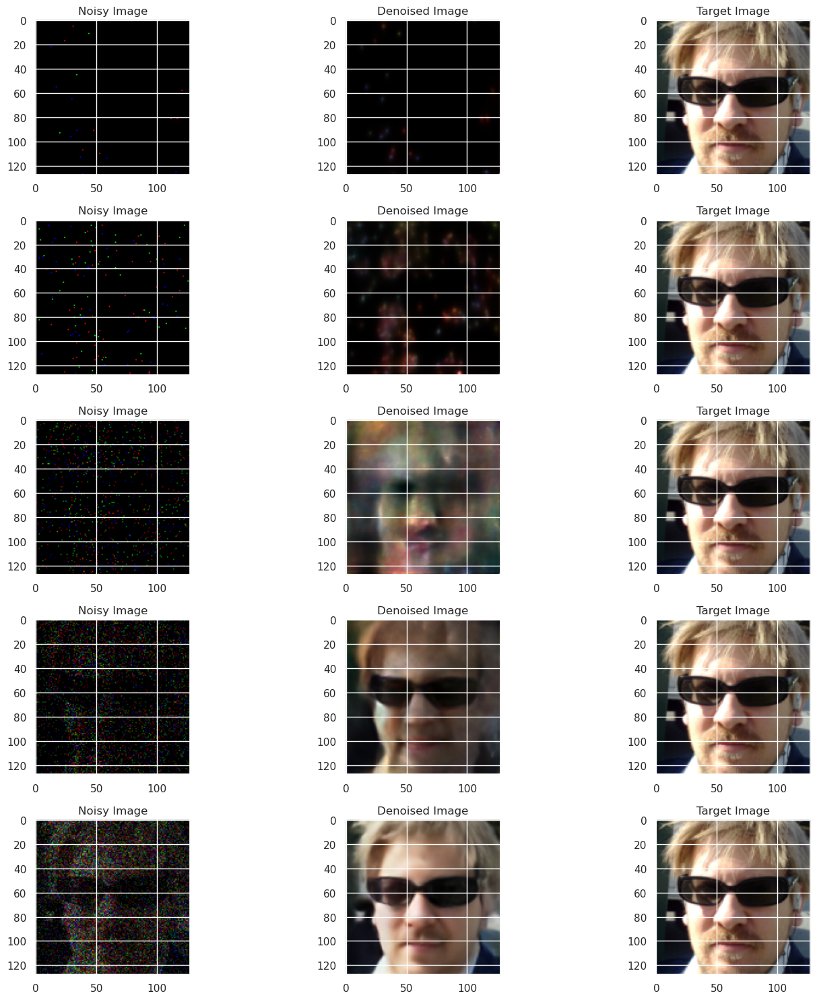

In [103]:
# Plots for a sample image the Noisy Image, its corresponding denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

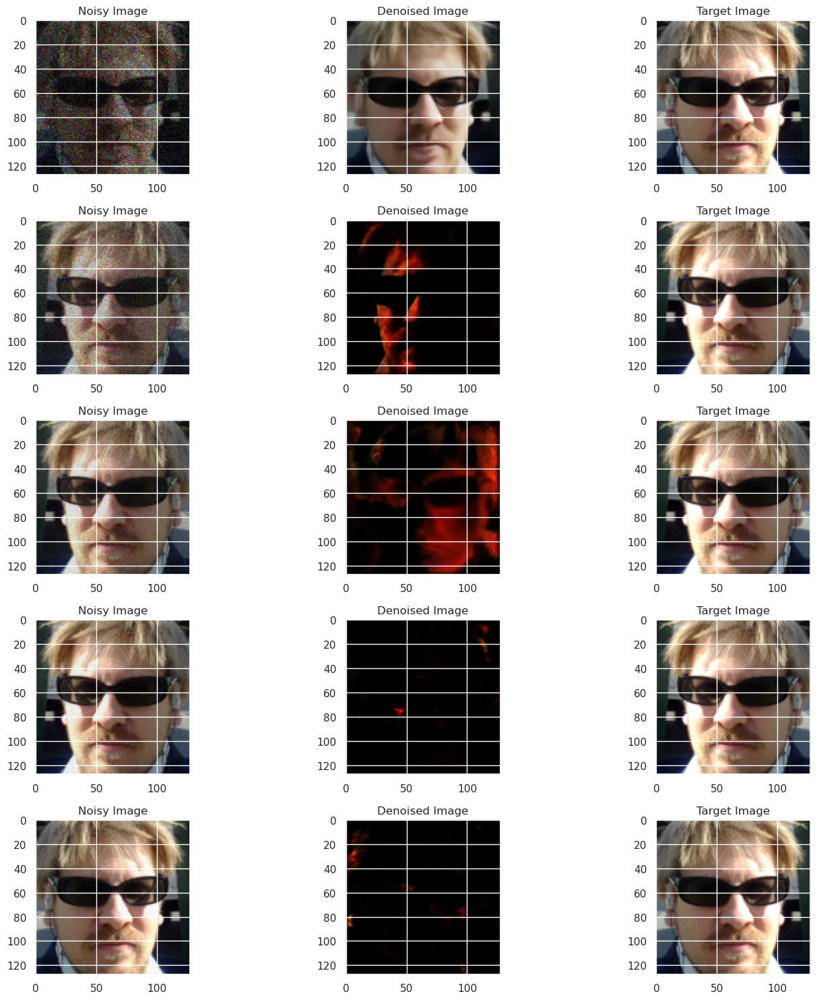

In [104]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [105]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Fourth Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)

def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model.eval()
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = torch.zeros(Noisy_Images.shape[0], 3, 128, 128).to(device)
    
    # Process batches correctly without slicing errors
    batch_size = 32
    with torch.no_grad():
        for i in range(0, Noisy_Images.shape[0], batch_size):
            batch_end = min(i + batch_size, Noisy_Images.shape[0])  # Ensure no overflow
            Predictions[i:batch_end] = model(Noisy_Images[i:batch_end]).detach()

        # Adjust predictions after getting model output
        Predictions = torch.exp(Predictions - Predictions.max())  # Handle exp safely to avoid overflow
        Predictions = Noisy_Images.detach().sum(dim=(1, 2, 3), keepdim=True) * Predictions / Predictions.sum(dim=(1, 2, 3), keepdim=True)
        
        perceptual_score = lpips_model(Target_Images, Predictions)
        perceptual_score = 1 - perceptual_score
        
        # Move everything to CPU for further processing
        Noisy_Images = Noisy_Images.cpu().numpy()
        Target_Images = Target_Images.cpu().numpy()
        Predictions = Predictions.cpu().numpy()
        perceptual_score = perceptual_score.cpu().numpy()

        # Normalize Predictions correctly
        Predictions = Predictions / Predictions.mean(axis=(1, 2, 3), keepdims=True)
        
        # Compute PSNR and SSIM scores
        Psnr_Scores = [psnr(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        SSIM_Scores = [ssim(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        
        return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_5 = np.array(Psnr_Distribution)
SSIM_Distribution_5 = np.array(SSIM_Distribution)
Perceptual_Distribution_5 = np.array(Perceptual_Distribution)
Psnr_Distribution_5.shape, SSIM_Distribution_5.shape, Perceptual_Distribution_5.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/weights/v0.1/alex.pth
-40-32


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during u

-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

In [106]:
np.save("Data/Psnr_Distribution_0_32b.npy", Psnr_Distribution_5)
np.save("Data/SSIM_Distribution_0_32b.npy", SSIM_Distribution_5)
np.save("Data/Perceptual_Distribution_0_32b.npy", Perceptual_Distribution_5)

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,10.262381,-3.559511,10.288758,1.945976,12.234735,8.342782
std,12.760681,20.564969,12.551464,1.016131,12.210810,12.963012
min,-20.008147,-39.119021,-10.455941,0.422472,-7.236200,-15.463046
25%,-1.155972,-21.339266,-1.280000,1.320518,0.052243,-2.745312
50%,9.906280,-3.559511,9.834679,1.644166,11.637049,7.979945
75%,22.254075,14.220245,22.060324,2.161798,23.969803,20.525978
max,32.292721,32.000000,30.079589,5.912408,31.393435,29.131129


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.369818,-3.559511,0.370428,0.047908,0.418336,0.322520
std,0.313274,20.564969,0.308663,0.021262,0.311081,0.307699
min,-0.096816,-39.119021,-0.029527,0.008281,0.011665,-0.084203
25%,0.104743,-21.339266,0.111565,0.031927,0.148228,0.072404
50%,0.231608,-3.559511,0.225142,0.044340,0.288899,0.161815
75%,0.676088,14.220245,0.693673,0.060448,0.759161,0.625964
max,0.928664,32.000000,0.900956,0.132956,0.937377,0.881096


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.399304,-3.119021,0.397447,0.047755,0.407020,0.387874
std,0.267978,20.310653,0.264129,0.020540,0.267053,0.261392
min,-0.049748,-38.238042,0.096241,0.011107,0.100714,0.090785
25%,0.135343,-20.678532,0.126176,0.031804,0.129851,0.122942
50%,0.390104,-3.119021,0.413299,0.046919,0.423606,0.403712
75%,0.609949,14.440489,0.607237,0.058656,0.637930,0.576544
max,0.943682,32.000000,0.889978,0.125339,0.897635,0.883725


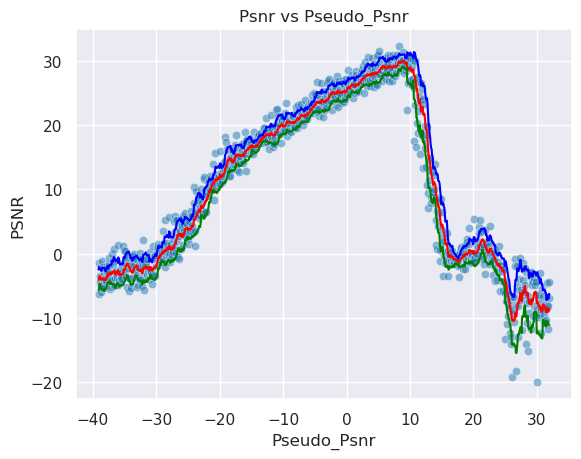

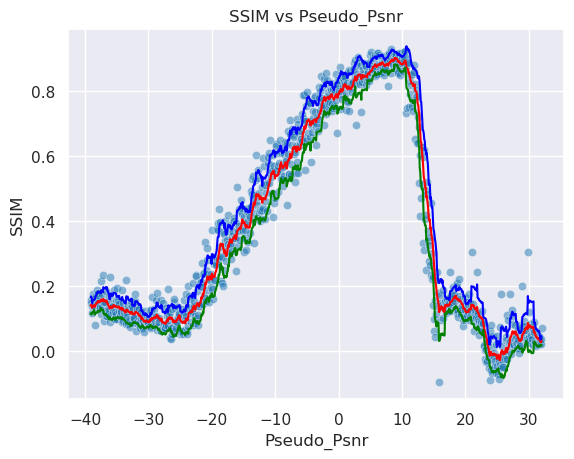

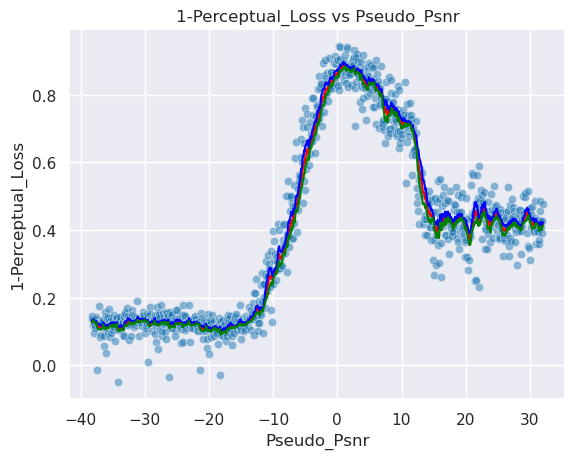

Psnr Area: 733.0610641887347, SSIM Area: 26.36732301310024, Perceptual Area: 27.925750715581408
Mean Psnr 10.262380608566083
Std Psnr 12.760680724376858
Min Psnr -20.00814661352137
Max Psnr 32.29272055338309
Mean Roll Var 1.9459762158352987
Mean SSIM 0.3698184
Std SSIM 0.3132740557193756
Min SSIM -0.09681564569473267
Max SSIM 0.9286641478538513
Mean Roll SSIM 0.04790807623215018
Mean 1-PL 0.39930418
Std 1-PL 0.267977774143219
Min 1-PL -0.04974770545959473
Max 1-PL 0.9436818361282349
Mean Roll 1-PL 0.047754571767619755


(733.0610641887347, 26.36732301310024, 27.925750715581408)

In [107]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Fourth Highest PSNR Range.
Plot_Creater(Psnr_Distribution_5, SSIM_Distribution_5, Perceptual_Distribution_5, minpsnr, maxpsnr)

In [108]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Fifth Highest PSNR Range
print(PSNR_Ranges[-5][0], PSNR_Ranges[-5][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-5][0] , maxPSNR = PSNR_Ranges[-5][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-5][0], maxPSNR = PSNR_Ranges[-5][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

-8 0


(16384, 4096)

In [109]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

/home/linux/KaylenGAP/MScGAPProject/OriginalGAPUNet.py:256: FutureWarning: `nn.init.xavier_normal` is now deprecated in favor of `nn.init.xavier_normal_`.
  init.xavier_normal(m.weight)
/home/linux/KaylenGAP/MScGAPProject/OriginalGAPUNet.py:257: FutureWarning: `nn.init.constant` is now deprecated in favor of `nn.init.constant_`.
  init.constant(m.bias, 0)


In [110]:
# Creates the directory to save the model in for the Fifth Highest PSNR Range.
name = "FaceGenerationUNet128x128-m8-0"
CHECKPOINT_PATH = "./models/" 

In [111]:
# Trains the model using the Pytorch Lightning Trainer for the Fifth Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)])

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


In [112]:
# Trains the model using the Pytorch Lightning Trainer for the Fifth Highest PSNR Range.
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

Missing logger folder: models/FaceGenerationUNet128x128-m8-0/lightning_logs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type       | Params | Mode 
--------------------------------------------------
0 | conv_final | Conv2d     | 153    | train
1 | down_convs | ModuleList | 76.8 M | train
2 | up_convs   | ModuleList | 32.4 M | train
--------------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

In [113]:
# Loads the model from the checkpoint for the Fifth Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lightning_fabric/utilities/cloud_io.py:57: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.


In [114]:
# Validates the trained model on the Train Set for the Fifth Highest PSNR Range.
Trainer.test(model, Train_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:475: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.15955214202404022    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.15955214202404022}]

In [115]:
# Validates the trained model on the Validation Set for the Fifth Highest PSNR Range.
Trainer.test(model, Validation_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.1563989520072937    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.1563989520072937}]

2.1577015 0.008461575 2.149240016937256 0.9392347931861877
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: -1.1691017150878906
-1.183909782176017 -1.183909782176017 0.0


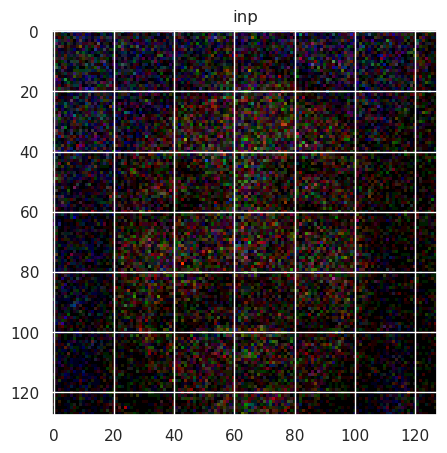

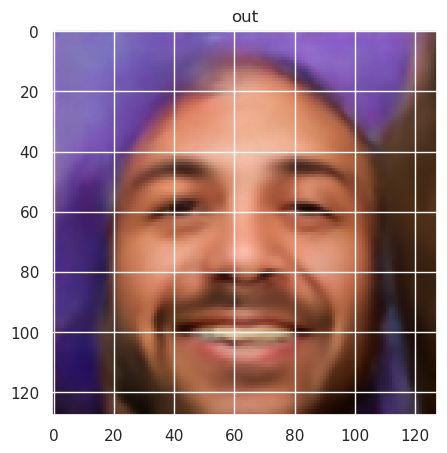

Text(0.5, 1.0, 'GT')

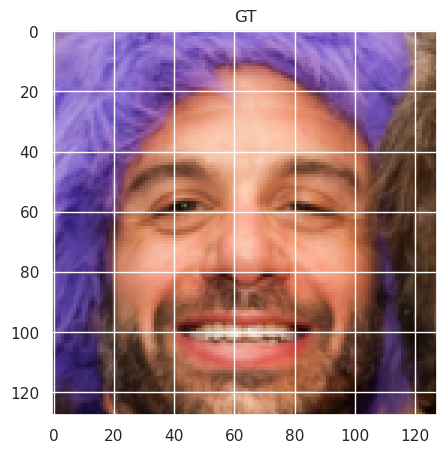

In [116]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

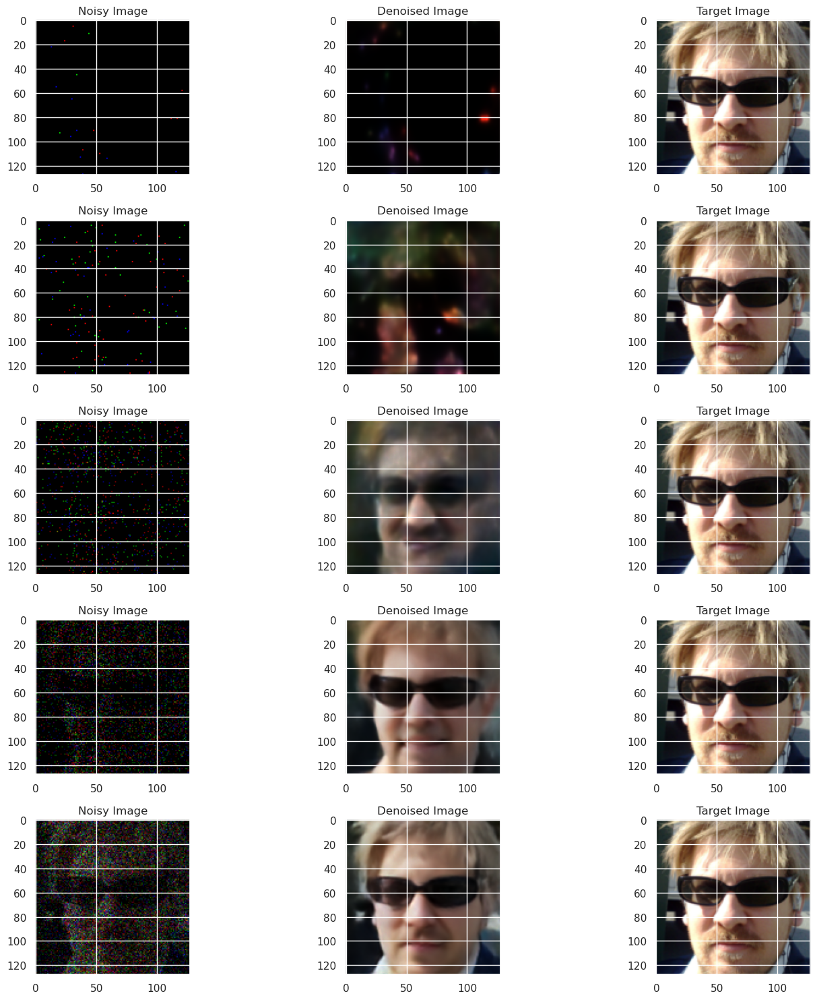

In [117]:
# Plots for a sample image the Noisy Image, its corresponding denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

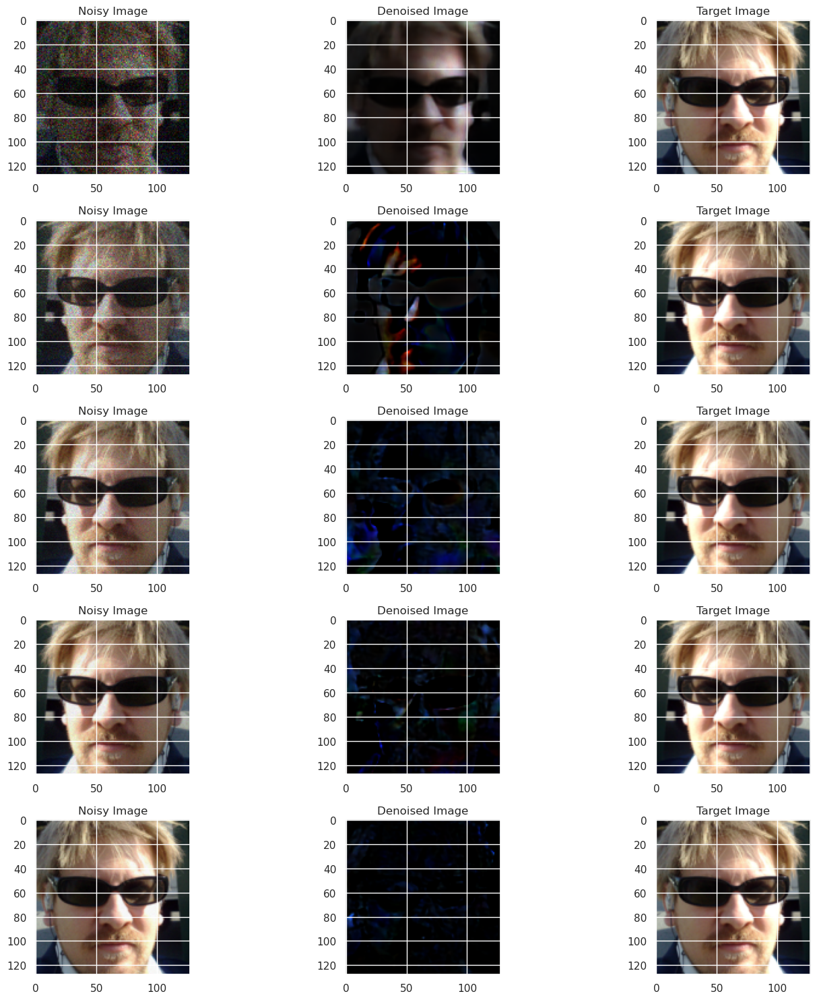

In [118]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [119]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Fifth Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)

def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model.eval()
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = torch.zeros(Noisy_Images.shape[0], 3, 128, 128).to(device)
    
    # Process batches correctly without slicing errors
    batch_size = 32
    with torch.no_grad():
        for i in range(0, Noisy_Images.shape[0], batch_size):
            batch_end = min(i + batch_size, Noisy_Images.shape[0])  # Ensure no overflow
            Predictions[i:batch_end] = model(Noisy_Images[i:batch_end]).detach()

        # Adjust predictions after getting model output
        Predictions = torch.exp(Predictions - Predictions.max())  # Handle exp safely to avoid overflow
        Predictions = Noisy_Images.detach().sum(dim=(1, 2, 3), keepdim=True) * Predictions / Predictions.sum(dim=(1, 2, 3), keepdim=True)
        
        perceptual_score = lpips_model(Target_Images, Predictions)
        perceptual_score = 1 - perceptual_score
        
        # Move everything to CPU for further processing
        Noisy_Images = Noisy_Images.cpu().numpy()
        Target_Images = Target_Images.cpu().numpy()
        Predictions = Predictions.cpu().numpy()
        perceptual_score = perceptual_score.cpu().numpy()

        # Normalize Predictions correctly
        Predictions = Predictions / Predictions.mean(axis=(1, 2, 3), keepdims=True)
        
        # Compute PSNR and SSIM scores
        Psnr_Scores = [psnr(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        SSIM_Scores = [ssim(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        
        return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_6 = np.array(Psnr_Distribution)
SSIM_Distribution_6 = np.array(SSIM_Distribution)
Perceptual_Distribution_6 = np.array(Perceptual_Distribution)
Psnr_Distribution_6.shape, SSIM_Distribution_6.shape, Perceptual_Distribution_6.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/weights/v0.1/alex.pth
-40-32


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(model_pa

-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

In [120]:
np.save("Data/Psnr_Distribution_m8_32b.npy", Psnr_Distribution_6)
np.save("Data/SSIM_Distribution_m8_32b.npy", SSIM_Distribution_6)
np.save("Data/Perceptual_Distribution_m8_32b.npy", Perceptual_Distribution_6)

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,9.545826,-3.559511,9.486942,2.077391,11.564333,7.409550
std,11.093860,20.564969,10.952849,0.877130,10.589821,11.372079
min,-11.740689,-39.119021,-8.897690,0.626384,-7.226898,-10.579792
25%,-0.262180,-21.339266,-0.372777,1.415694,2.305237,-2.707316
50%,9.783113,-3.559511,10.772159,1.908319,12.647701,8.186320
75%,19.558218,14.220245,19.843447,2.552105,21.278511,18.338249
max,28.840871,32.000000,26.610400,5.101960,28.125993,25.474485


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.339477,-3.559511,0.339652,0.047606,0.387258,0.292046
std,0.302010,20.564969,0.297606,0.022498,0.301208,0.295676
min,-0.100467,-39.119021,-0.042281,0.013518,-0.019615,-0.103440
25%,0.060767,-21.339266,0.068584,0.030062,0.099711,0.034611
50%,0.261422,-3.559511,0.261113,0.043131,0.296480,0.206434
75%,0.646688,14.220245,0.650677,0.059951,0.701921,0.595819
max,0.871423,32.000000,0.822525,0.150831,0.871080,0.792420


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.386422,-3.119021,0.384576,0.044221,0.393302,0.375850
std,0.253928,20.310653,0.250604,0.016908,0.253645,0.247718
min,-0.049300,-38.238042,0.094439,0.009082,0.097411,0.089133
25%,0.132548,-20.678532,0.123303,0.029918,0.127283,0.119955
50%,0.399435,-3.119021,0.422605,0.043658,0.429906,0.415380
75%,0.532999,14.440489,0.523238,0.055432,0.544725,0.502971
max,0.938423,32.000000,0.882848,0.098380,0.891075,0.875403


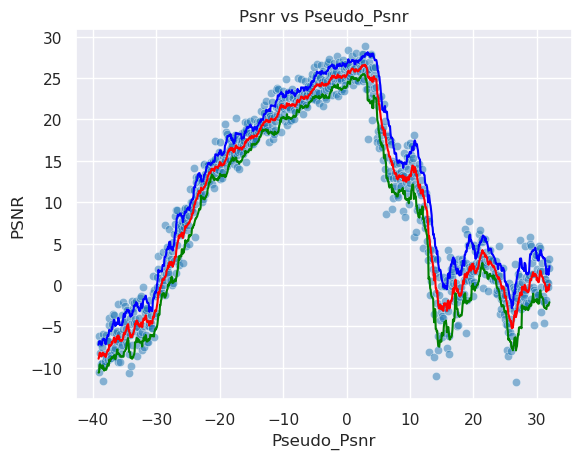

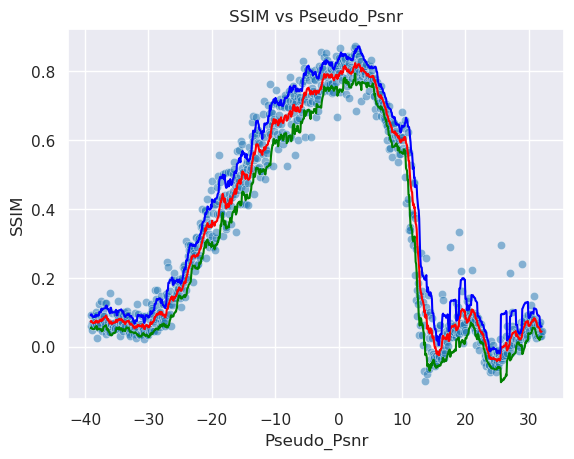

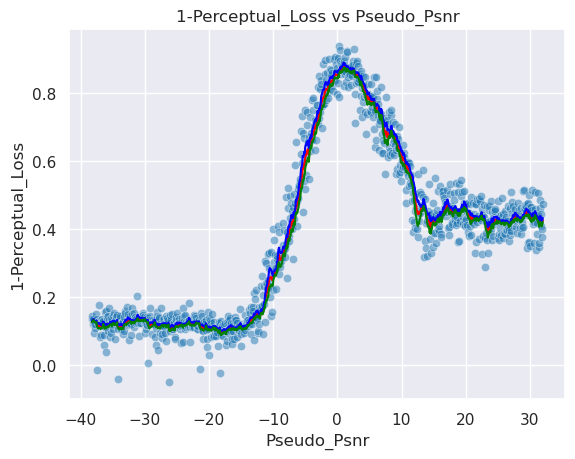

Psnr Area: 675.8146120865631, SSIM Area: 24.178288664255973, Perceptual Area: 27.020336391398057
Mean Psnr 9.545825781200032
Std Psnr 11.093859870588677
Min Psnr -11.740688996863069
Max Psnr 28.840871114823496
Mean Roll Var 2.077391474805544
Mean SSIM 0.33947685
Std SSIM 0.3020102381706238
Min SSIM -0.1004672572016716
Max SSIM 0.8714227080345154
Mean Roll SSIM 0.047605590481596155
Mean 1-PL 0.3864217
Std 1-PL 0.25392818450927734
Min 1-PL -0.049300312995910645
Max 1-PL 0.9384229779243469
Mean Roll 1-PL 0.044221373973385845


(675.8146120865631, 24.178288664255973, 27.020336391398057)

In [121]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Fifth Highest PSNR Range.
Plot_Creater(Psnr_Distribution_6, SSIM_Distribution_6, Perceptual_Distribution_6, minpsnr, maxpsnr)

In [122]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Sixth Highest PSNR Range
print(PSNR_Ranges[-6][0], PSNR_Ranges[-6][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-6][0] , maxPSNR = PSNR_Ranges[-6][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-6][0], maxPSNR = PSNR_Ranges[-6][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

-16 -8


(16384, 4096)

In [123]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

/home/linux/KaylenGAP/MScGAPProject/OriginalGAPUNet.py:256: FutureWarning: `nn.init.xavier_normal` is now deprecated in favor of `nn.init.xavier_normal_`.
  init.xavier_normal(m.weight)
/home/linux/KaylenGAP/MScGAPProject/OriginalGAPUNet.py:257: FutureWarning: `nn.init.constant` is now deprecated in favor of `nn.init.constant_`.
  init.constant(m.bias, 0)


In [124]:
# Creates the directory to save the model in for the Sixth Highest PSNR Range.
name = "FaceGenerationUNet128x128-m16-m8"
CHECKPOINT_PATH = "./models/" 

In [125]:
# Trains the model using the Pytorch Lightning Trainer for the Sixth Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)])

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


In [126]:
# Trains the model using the Pytorch Lightning Trainer for the Sixth Highest PSNR Range.
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

Missing logger folder: models/FaceGenerationUNet128x128-m16-m8/lightning_logs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type       | Params | Mode 
--------------------------------------------------
0 | conv_final | Conv2d     | 153    | train
1 | down_convs | ModuleList | 76.8 M | train
2 | up_convs   | ModuleList | 32.4 M | train
--------------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=30` reached.


In [127]:
# Loads the model from the checkpoint for the Sixth Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lightning_fabric/utilities/cloud_io.py:57: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.


In [128]:
# Validates the trained model on the Train Set for the Sixth Highest PSNR Range.
Trainer.test(model, Train_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:475: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.14597012102603912    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.14597012102603912}]

In [129]:
# Validates the trained model on the Validation Set for the Sixth Highest PSNR Range.
Trainer.test(model, Validation_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.14272530376911163    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.14272530376911163}]

2.5567155 0.020052671 2.556715488433838 0.9224228858947754
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: -15.511402130126953
-15.519769374505834 -15.519769374505834 -2.588596909321764e-07


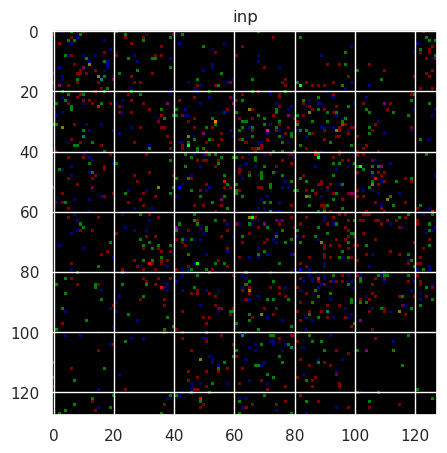

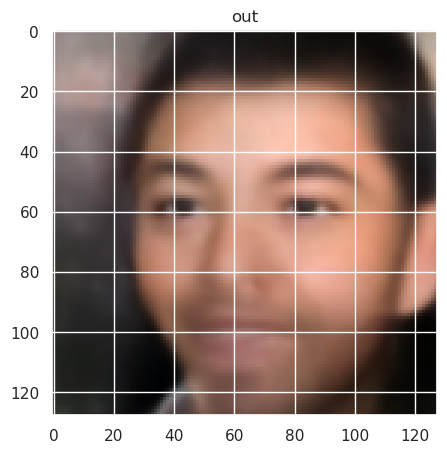

Text(0.5, 1.0, 'GT')

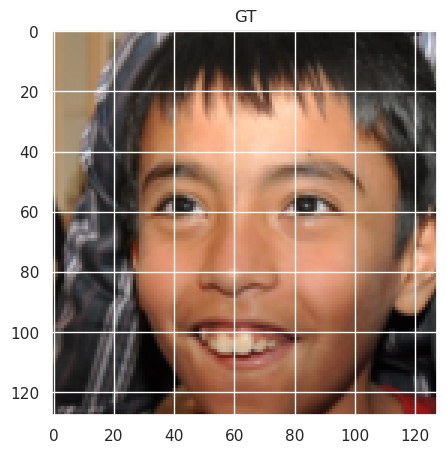

In [130]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

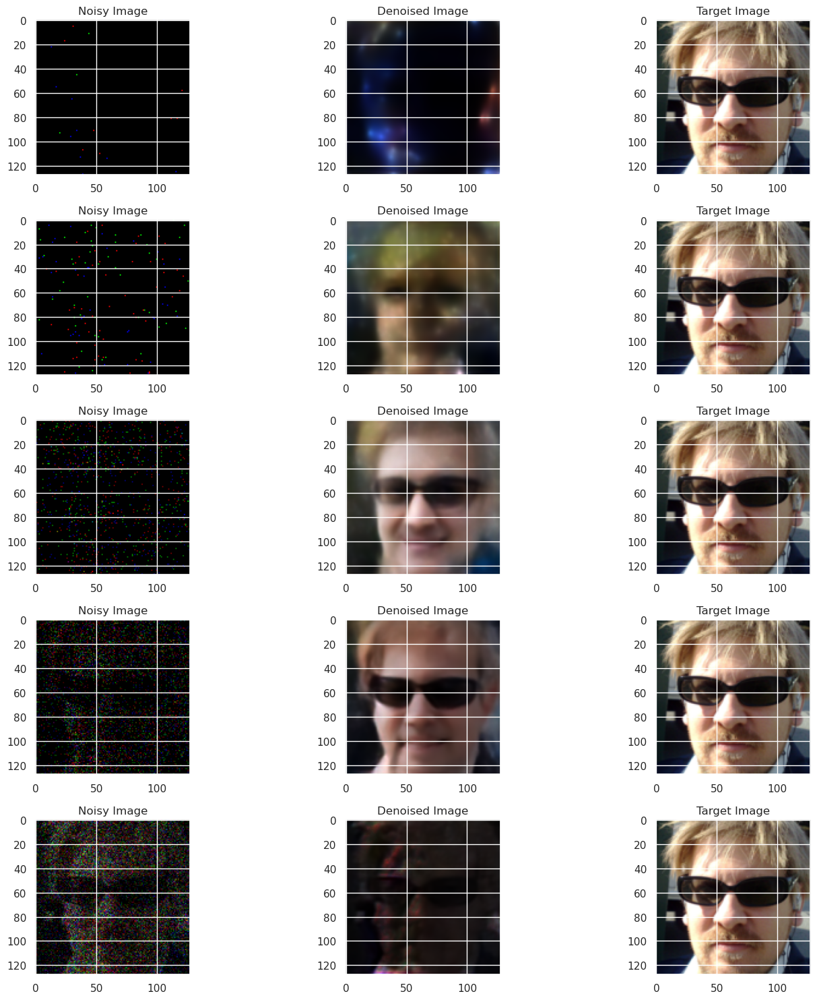

In [131]:
# Plots for a sample image the Noisy Image, its corresponding denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

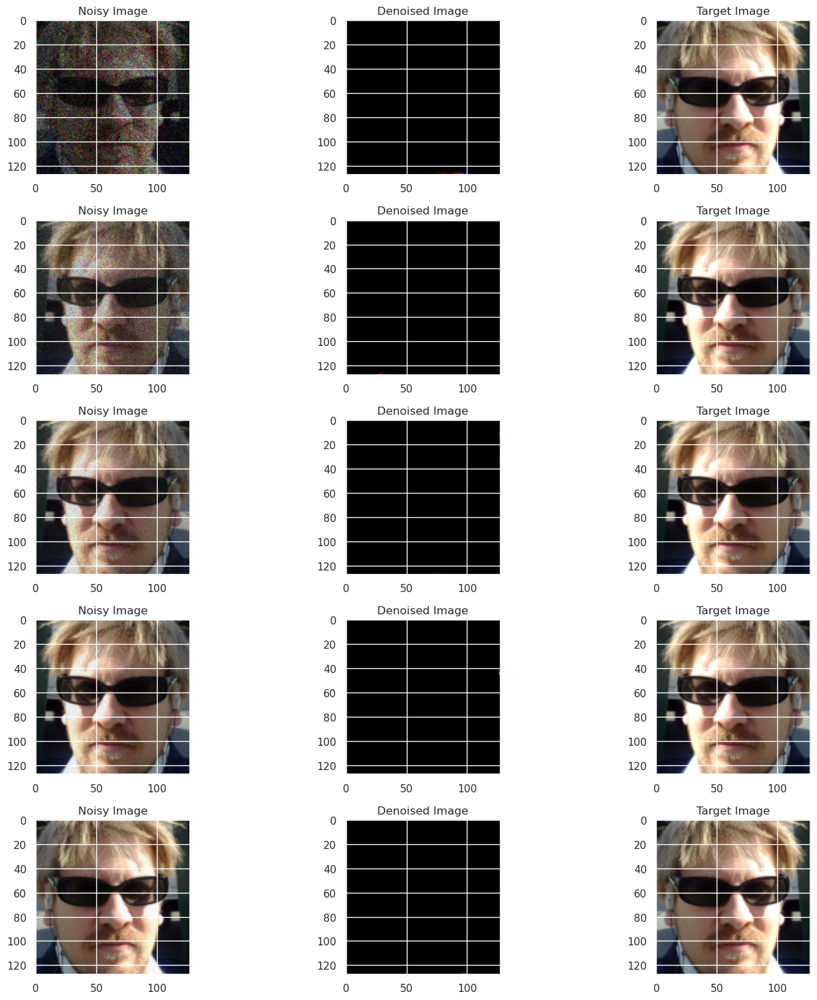

In [132]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [133]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Sixth Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)

def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model.eval()
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = torch.zeros(Noisy_Images.shape[0], 3, 128, 128).to(device)
    
    # Process batches correctly without slicing errors
    batch_size = 32
    with torch.no_grad():
        for i in range(0, Noisy_Images.shape[0], batch_size):
            batch_end = min(i + batch_size, Noisy_Images.shape[0])  # Ensure no overflow
            Predictions[i:batch_end] = model(Noisy_Images[i:batch_end]).detach()

        # Adjust predictions after getting model output
        Predictions = torch.exp(Predictions - Predictions.max())  # Handle exp safely to avoid overflow
        Predictions = Noisy_Images.detach().sum(dim=(1, 2, 3), keepdim=True) * Predictions / Predictions.sum(dim=(1, 2, 3), keepdim=True)
        
        perceptual_score = lpips_model(Target_Images, Predictions)
        perceptual_score = 1 - perceptual_score
        
        # Move everything to CPU for further processing
        Noisy_Images = Noisy_Images.cpu().numpy()
        Target_Images = Target_Images.cpu().numpy()
        Predictions = Predictions.cpu().numpy()
        perceptual_score = perceptual_score.cpu().numpy()

        # Normalize Predictions correctly
        Predictions = Predictions / Predictions.mean(axis=(1, 2, 3), keepdims=True)
        
        # Compute PSNR and SSIM scores
        Psnr_Scores = [psnr(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        SSIM_Scores = [ssim(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        
        return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_7 = np.array(Psnr_Distribution)
SSIM_Distribution_7 = np.array(SSIM_Distribution)
Perceptual_Distribution_7 = np.array(Perceptual_Distribution)
Psnr_Distribution_7.shape, SSIM_Distribution_7.shape, Perceptual_Distribution_7.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/weights/v0.1/alex.pth
-40-32


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(model_pa

-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

In [134]:
np.save("Data/Psnr_Distribution_m16_32b.npy", Psnr_Distribution_7)
np.save("Data/SSIM_Distribution_m16_32b.npy", SSIM_Distribution_7)
np.save("Data/Perceptual_Distribution_m16_32b.npy", Perceptual_Distribution_7)

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,-1.407042,-3.559511,-1.245172,2.807543,1.562371,-4.052714
std,19.337363,20.564969,19.012725,1.434991,17.943714,20.127319
min,-33.940149,-39.119021,-28.634792,0.656839,-25.639075,-32.841541
25%,-21.423781,-21.339266,-22.989799,1.537033,-18.901777,-26.997713
50%,4.304633,-3.559511,3.737353,2.494417,6.364495,1.070297
75%,17.306871,14.220245,17.515533,3.939822,19.380762,15.380697
max,24.913084,32.000000,23.093745,7.576293,24.442093,22.072752


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.257011,-3.559511,0.257663,0.045572,0.303235,0.212091
std,0.256316,20.564969,0.251123,0.022629,0.263545,0.240196
min,-0.002438,-39.119021,0.001422,0.002104,0.003978,-0.049832
25%,0.005414,-21.339266,0.018915,0.030098,0.060332,-0.004932
50%,0.160305,-3.559511,0.147597,0.047260,0.185115,0.110696
75%,0.496867,14.220245,0.506442,0.059842,0.568566,0.441648
max,0.798079,32.000000,0.712736,0.118140,0.778967,0.655217


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.275129,-3.119021,0.273950,0.043023,0.282113,0.265786
std,0.160584,20.310653,0.154629,0.017792,0.158358,0.151037
min,-0.052782,-38.238042,0.093752,0.011169,0.096340,0.090101
25%,0.130910,-20.678532,0.122560,0.028569,0.126205,0.119008
50%,0.275807,-3.119021,0.287809,0.042626,0.293940,0.280732
75%,0.350664,14.440489,0.327428,0.054122,0.337306,0.318928
max,0.767961,32.000000,0.677716,0.099831,0.688278,0.668649


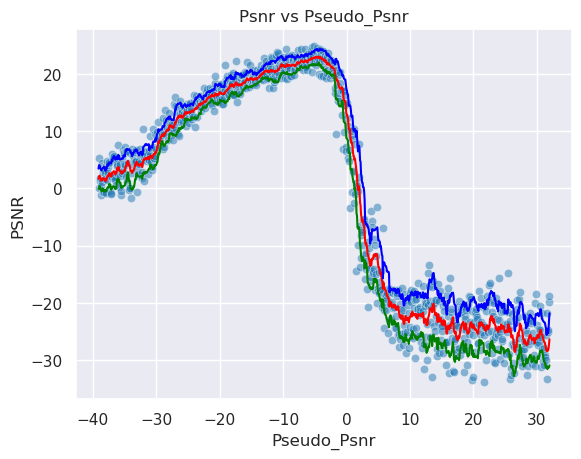

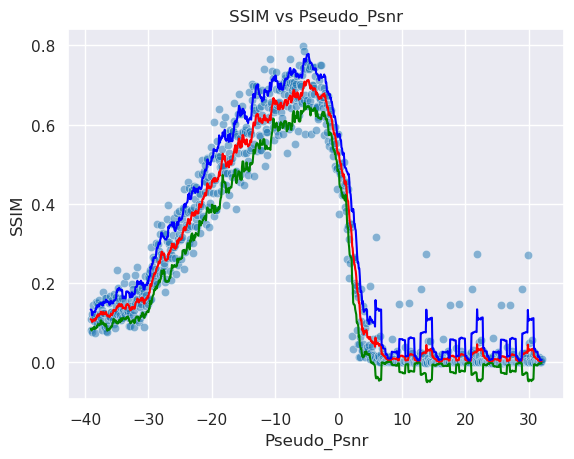

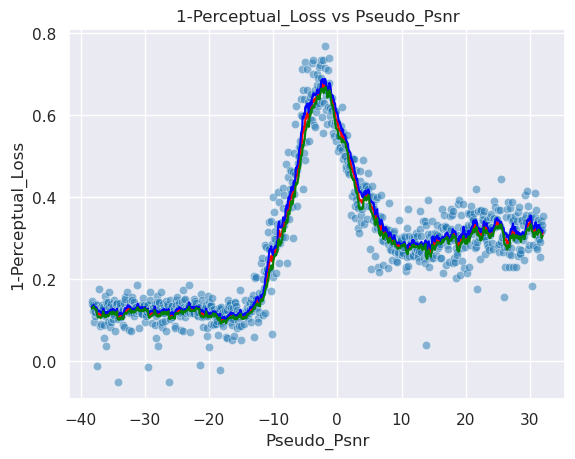

Psnr Area: -87.66528540837703, SSIM Area: 18.340902348881553, Perceptual Area: 19.245956943682224
Mean Psnr -1.4070415595051713
Std Psnr 19.337362561367076
Min Psnr -33.94014897916436
Max Psnr 24.9130837161295
Mean Roll Var 2.807542669277037
Mean SSIM 0.257011
Std SSIM 0.25631627440452576
Min SSIM -0.0024381286930292845
Max SSIM 0.7980785369873047
Mean Roll SSIM 0.04557187692092113
Mean 1-PL 0.275129
Std 1-PL 0.1605844646692276
Min 1-PL -0.052782297134399414
Max 1-PL 0.7679611444473267
Mean Roll 1-PL 0.043023154669636486


(-87.66528540837703, 18.340902348881553, 19.245956943682224)

In [135]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Sixth Highest PSNR Range.
Plot_Creater(Psnr_Distribution_7, SSIM_Distribution_7, Perceptual_Distribution_7, minpsnr, maxpsnr)

In [136]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Seventh Highest PSNR Range
print(PSNR_Ranges[-7][0], PSNR_Ranges[-7][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-7][0] , maxPSNR = PSNR_Ranges[-7][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-7][0], maxPSNR = PSNR_Ranges[-7][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

-24 -16


(16384, 4096)

In [137]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

/home/linux/KaylenGAP/MScGAPProject/OriginalGAPUNet.py:256: FutureWarning: `nn.init.xavier_normal` is now deprecated in favor of `nn.init.xavier_normal_`.
  init.xavier_normal(m.weight)
/home/linux/KaylenGAP/MScGAPProject/OriginalGAPUNet.py:257: FutureWarning: `nn.init.constant` is now deprecated in favor of `nn.init.constant_`.
  init.constant(m.bias, 0)


In [138]:
# Creates the directory to save the model in for the Seventh Highest PSNR Range.
name = "FaceGenerationUNet128x128-m24-m16"
CHECKPOINT_PATH = "./models/" 

In [139]:
# Trains the model using the Pytorch Lightning Trainer for the Seventh Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)])

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


In [140]:
# Trains the model using the Pytorch Lightning Trainer for the Seventh Highest PSNR Range.
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

Missing logger folder: models/FaceGenerationUNet128x128-m24-m16/lightning_logs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type       | Params | Mode 
--------------------------------------------------
0 | conv_final | Conv2d     | 153    | train
1 | down_convs | ModuleList | 76.8 M | train
2 | up_convs   | ModuleList | 32.4 M | train
--------------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=30` reached.


In [141]:
# Loads the model from the checkpoint for the Seventh Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lightning_fabric/utilities/cloud_io.py:57: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.


In [142]:
# Validates the trained model on the Train Set for the Seventh Highest PSNR Range.
Trainer.test(model, Train_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:475: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.119572713971138     │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.119572713971138}]

In [143]:
# Validates the trained model on the Validation Set for the Seventh Highest PSNR Range.
Trainer.test(model, Validation_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.11589184403419495    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.11589184403419495}]

2.6532989 0.021141823 2.5581605434417725 0.8985275030136108
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: -22.078292846679688
-22.41292085696038 -22.41292085696038 0.0


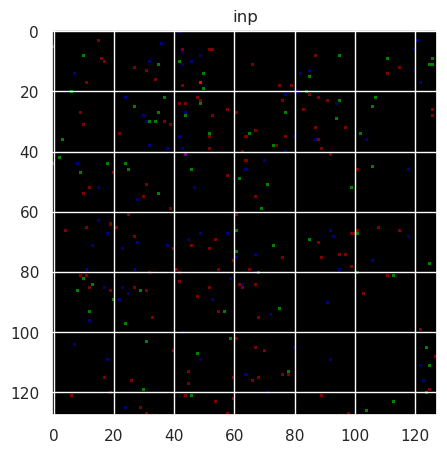

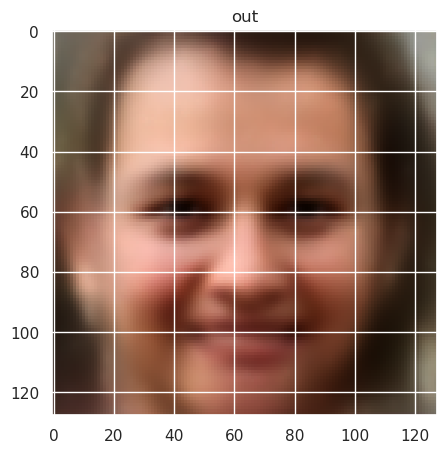

Text(0.5, 1.0, 'GT')

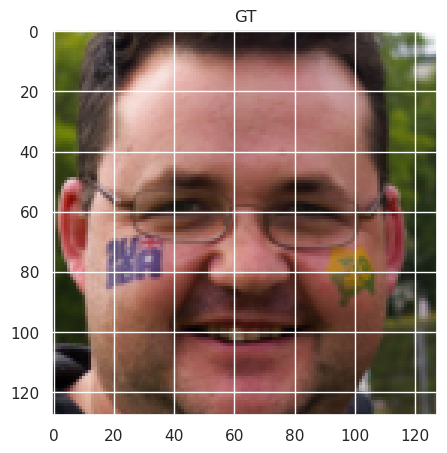

In [144]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

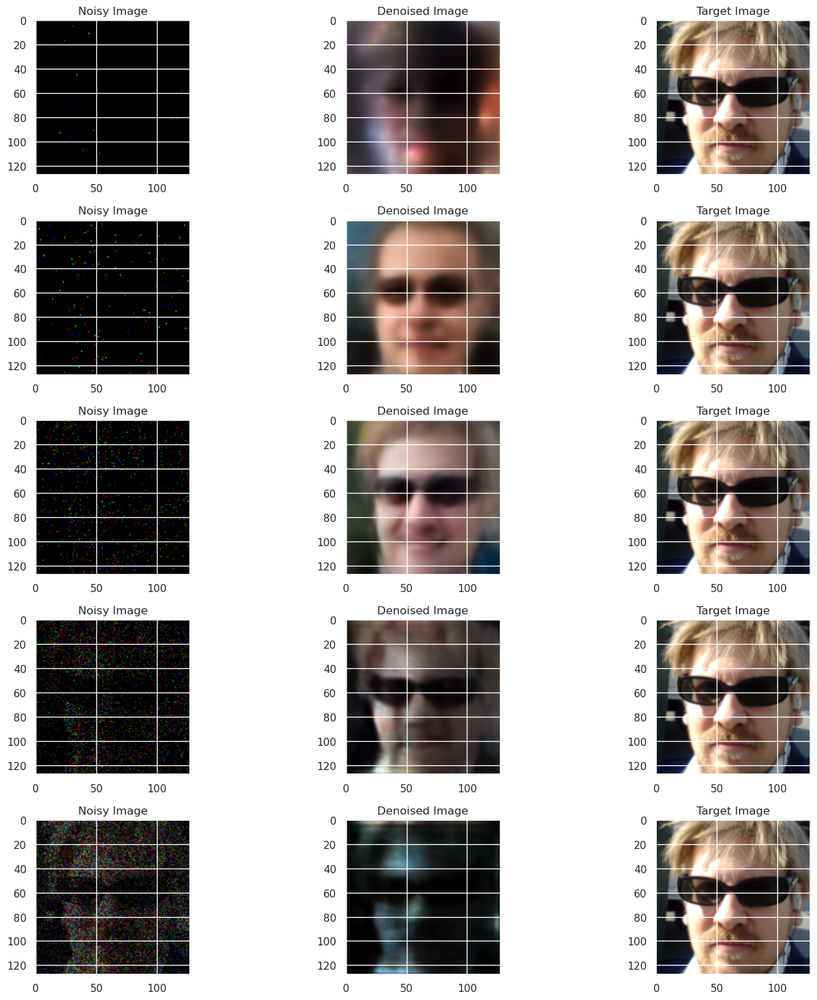

In [145]:
# Plots for a sample image the Noisy Image, its corresponding denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

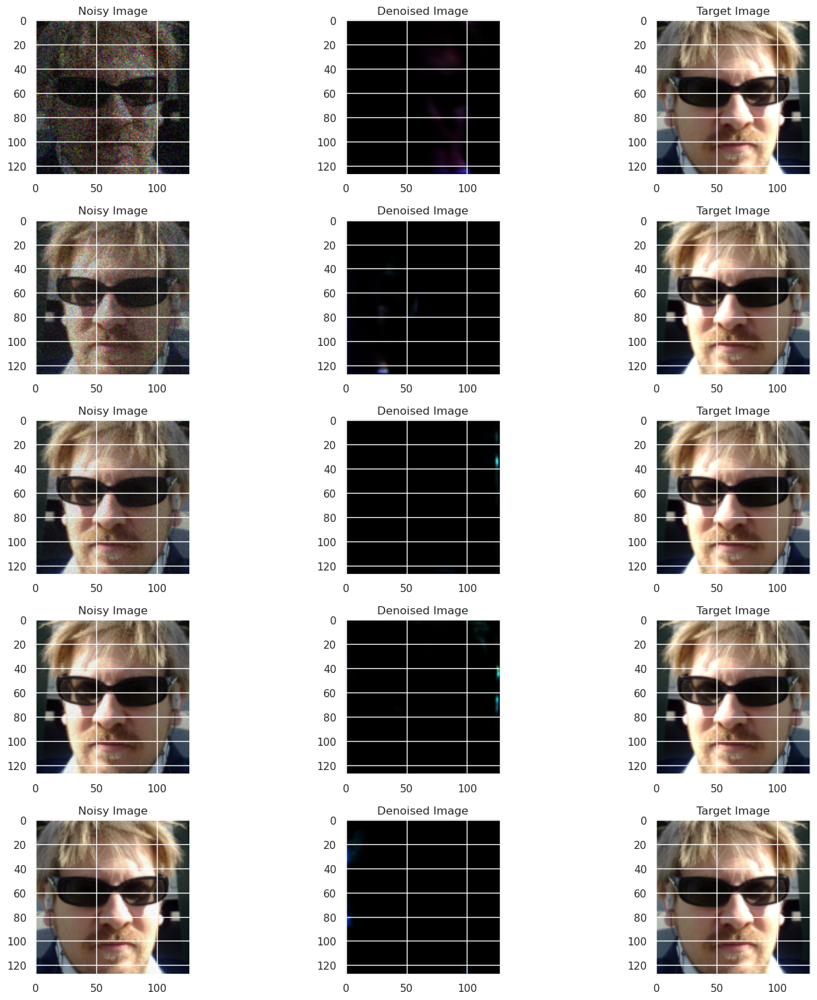

In [146]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [147]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Seventh Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)

def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model.eval()
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = torch.zeros(Noisy_Images.shape[0], 3, 128, 128).to(device)
    
    # Process batches correctly without slicing errors
    batch_size = 32
    with torch.no_grad():
        for i in range(0, Noisy_Images.shape[0], batch_size):
            batch_end = min(i + batch_size, Noisy_Images.shape[0])  # Ensure no overflow
            Predictions[i:batch_end] = model(Noisy_Images[i:batch_end]).detach()

        # Adjust predictions after getting model output
        Predictions = torch.exp(Predictions - Predictions.max())  # Handle exp safely to avoid overflow
        Predictions = Noisy_Images.detach().sum(dim=(1, 2, 3), keepdim=True) * Predictions / Predictions.sum(dim=(1, 2, 3), keepdim=True)
        
        perceptual_score = lpips_model(Target_Images, Predictions)
        perceptual_score = 1 - perceptual_score
        
        # Move everything to CPU for further processing
        Noisy_Images = Noisy_Images.cpu().numpy()
        Target_Images = Target_Images.cpu().numpy()
        Predictions = Predictions.cpu().numpy()
        perceptual_score = perceptual_score.cpu().numpy()

        # Normalize Predictions correctly
        Predictions = Predictions / Predictions.mean(axis=(1, 2, 3), keepdims=True)
        
        # Compute PSNR and SSIM scores
        Psnr_Scores = [psnr(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        SSIM_Scores = [ssim(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        
        return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_8 = np.array(Psnr_Distribution)
SSIM_Distribution_8 = np.array(SSIM_Distribution)
Perceptual_Distribution_8 = np.array(Perceptual_Distribution)
Psnr_Distribution_8.shape, SSIM_Distribution_8.shape, Perceptual_Distribution_8.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/weights/v0.1/alex.pth
-40-32


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(model_pa

-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

In [148]:
np.save("Data/Psnr_Distribution_m24_32b.npy", Psnr_Distribution_8)
np.save("Data/SSIM_Distribution_m24_32b.npy", SSIM_Distribution_8)
np.save("Data/Perceptual_Distribution_m24_32b.npy", Perceptual_Distribution_8)

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,5.955723,-3.559511,6.089289,2.680172,8.769461,3.409118
std,11.767311,20.564969,11.305284,1.437813,10.024450,12.619980
min,-24.209028,-39.119021,-15.022153,0.824284,-10.457467,-21.217567
25%,-4.210701,-21.339266,-5.137386,1.529111,-1.070531,-8.832423
50%,9.626134,-3.559511,9.823385,2.018556,12.099346,7.797016
75%,16.257695,14.220245,16.292482,3.821346,17.705952,14.835253
max,23.024674,32.000000,20.260672,6.657881,21.748752,19.085183


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.292412,-3.559511,0.293616,0.051629,0.345245,0.241988
std,0.205822,20.564969,0.198208,0.016306,0.207075,0.190327
min,-0.056482,-39.119021,-0.012883,0.010087,0.019346,-0.057361
25%,0.088696,-21.339266,0.084458,0.037907,0.139633,0.031258
50%,0.300985,-3.559511,0.299285,0.051780,0.362985,0.244727
75%,0.477691,14.220245,0.486841,0.063920,0.553153,0.427001
max,0.706529,32.000000,0.603431,0.092025,0.677633,0.539564


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.284235,-3.119021,0.282594,0.041560,0.289516,0.275672
std,0.148456,20.310653,0.142480,0.015363,0.144490,0.140582
min,-0.052391,-38.238042,0.095785,0.011007,0.098281,0.091021
25%,0.130245,-20.678532,0.121764,0.029733,0.125277,0.117596
50%,0.329721,-3.119021,0.354012,0.040957,0.359603,0.347261
75%,0.410610,14.440489,0.401682,0.051336,0.409598,0.390957
max,0.607132,32.000000,0.521764,0.085436,0.531765,0.515031


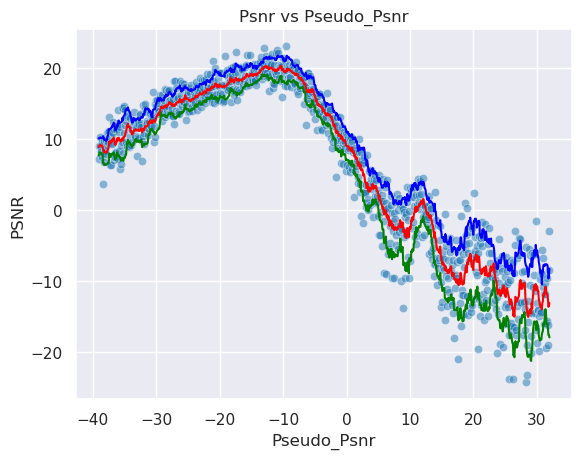

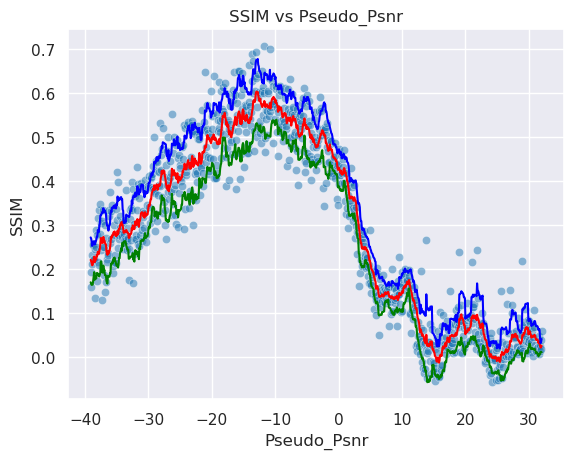

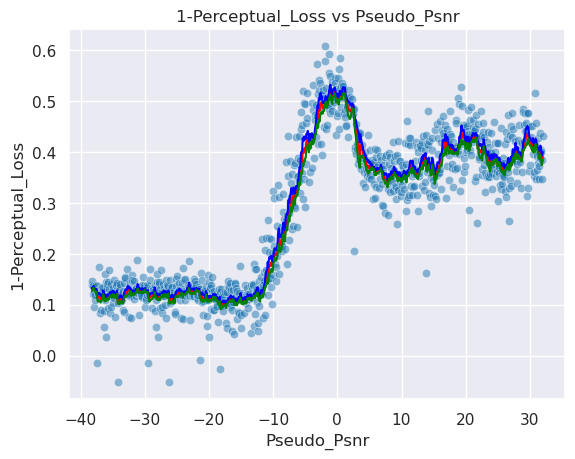

Psnr Area: 433.72178006870024, SSIM Area: 20.895342072273593, Perceptual Area: 19.85056875041117
Mean Psnr 5.955723115364227
Std Psnr 11.767311249410335
Min Psnr -24.2090276633176
Max Psnr 23.0246736998387
Mean Roll Var 2.680171805327294
Mean SSIM 0.29241216
Std SSIM 0.205821692943573
Min SSIM -0.056482091546058655
Max SSIM 0.7065289616584778
Mean Roll SSIM 0.05162862493900736
Mean 1-PL 0.2842352
Std 1-PL 0.14845584332942963
Min 1-PL -0.05239129066467285
Max 1-PL 0.6071324348449707
Mean Roll 1-PL 0.04155963888901853


(433.72178006870024, 20.895342072273593, 19.85056875041117)

In [149]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Seventh Highest PSNR Range.
Plot_Creater(Psnr_Distribution_8, SSIM_Distribution_8, Perceptual_Distribution_8, minpsnr, maxpsnr)

In [150]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Eighth Highest PSNR Range
print(PSNR_Ranges[-8][0], PSNR_Ranges[-8][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-8][0] , maxPSNR = PSNR_Ranges[-8][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-8][0], maxPSNR = PSNR_Ranges[-8][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

-32 -24


(16384, 4096)

In [151]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

/home/linux/KaylenGAP/MScGAPProject/OriginalGAPUNet.py:256: FutureWarning: `nn.init.xavier_normal` is now deprecated in favor of `nn.init.xavier_normal_`.
  init.xavier_normal(m.weight)
/home/linux/KaylenGAP/MScGAPProject/OriginalGAPUNet.py:257: FutureWarning: `nn.init.constant` is now deprecated in favor of `nn.init.constant_`.
  init.constant(m.bias, 0)


In [152]:
# Creates the directory to save the model in for the Eighth Highest PSNR Range.
name = "FaceGenerationUNet128x128-m32-m24"
CHECKPOINT_PATH = "./models/" 

In [153]:
# Trains the model using the Pytorch Lightning Trainer for the Eighth Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)])

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


In [154]:
# Trains the model using the Pytorch Lightning Trainer for the Eighth Highest PSNR Range.
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

Missing logger folder: models/FaceGenerationUNet128x128-m32-m24/lightning_logs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type       | Params | Mode 
--------------------------------------------------
0 | conv_final | Conv2d     | 153    | train
1 | down_convs | ModuleList | 76.8 M | train
2 | up_convs   | ModuleList | 32.4 M | train
--------------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=30` reached.


In [155]:
# Loads the model from the checkpoint for the Eighth Highest PSNR Range.
Trainer.test(model, Train_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:475: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.08179547637701035    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.08179547637701035}]

In [156]:
# Validates the trained model on the Train Set for the Eighth Highest PSNR Range.
Trainer.test(model, Validation_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.08198774605989456    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.08198774605989456}]

In [157]:
# Validates the trained model on the Validation Set for the Eighth Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lightning_fabric/utilities/cloud_io.py:57: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.


2.4319644 0.05722269 2.43196439743042 1.0395455360412598
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: -31.614391326904297
-30.383286802400555 -30.383286802400555 0.0


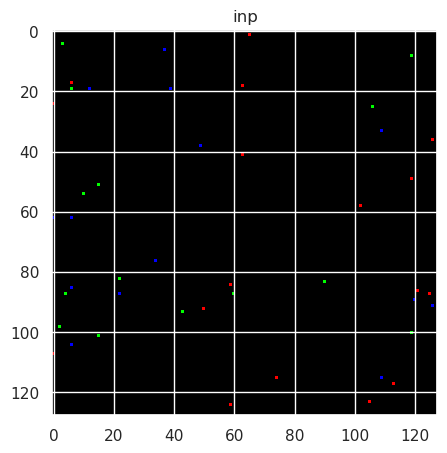

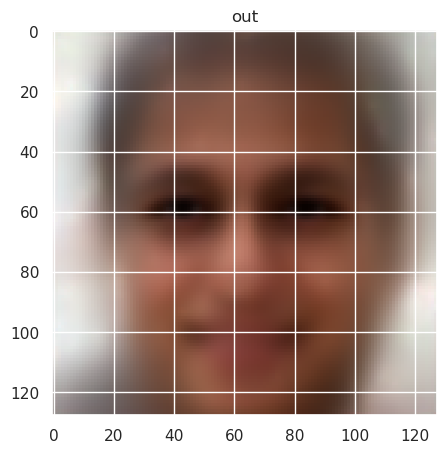

Text(0.5, 1.0, 'GT')

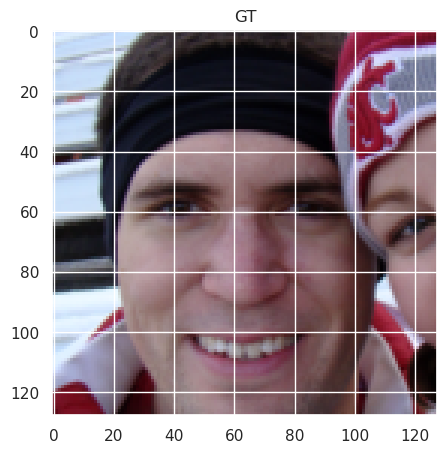

In [158]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

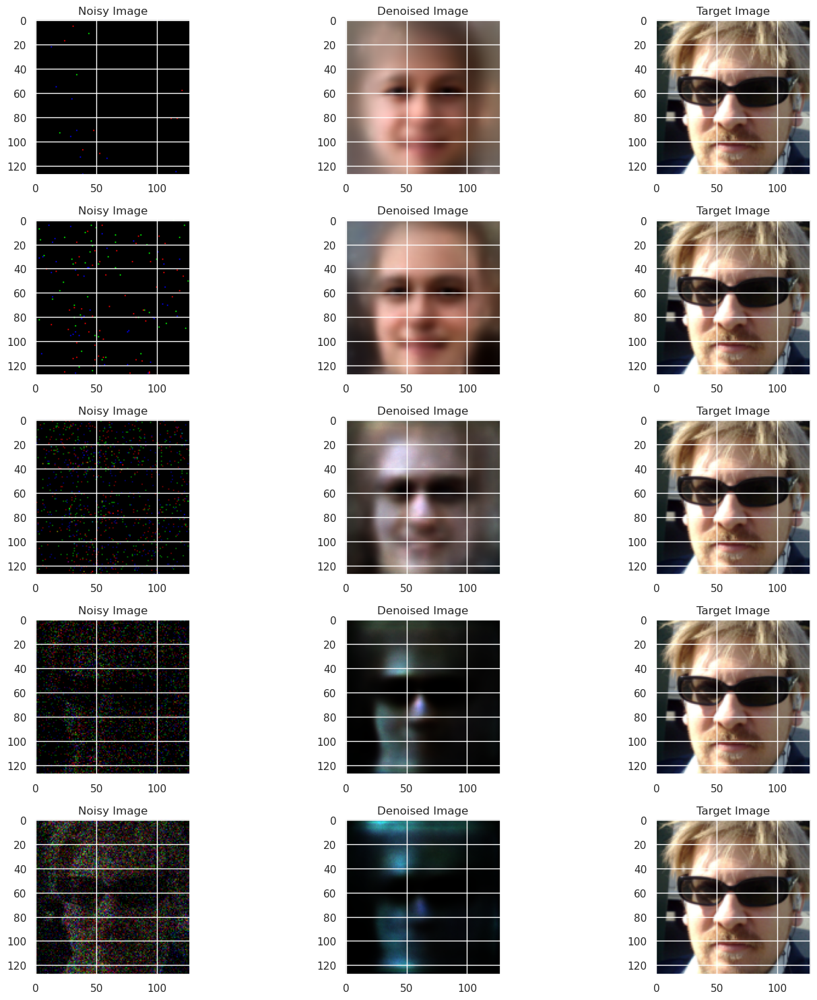

In [159]:
# Plots for a sample image the Noisy Image, its corresponding denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

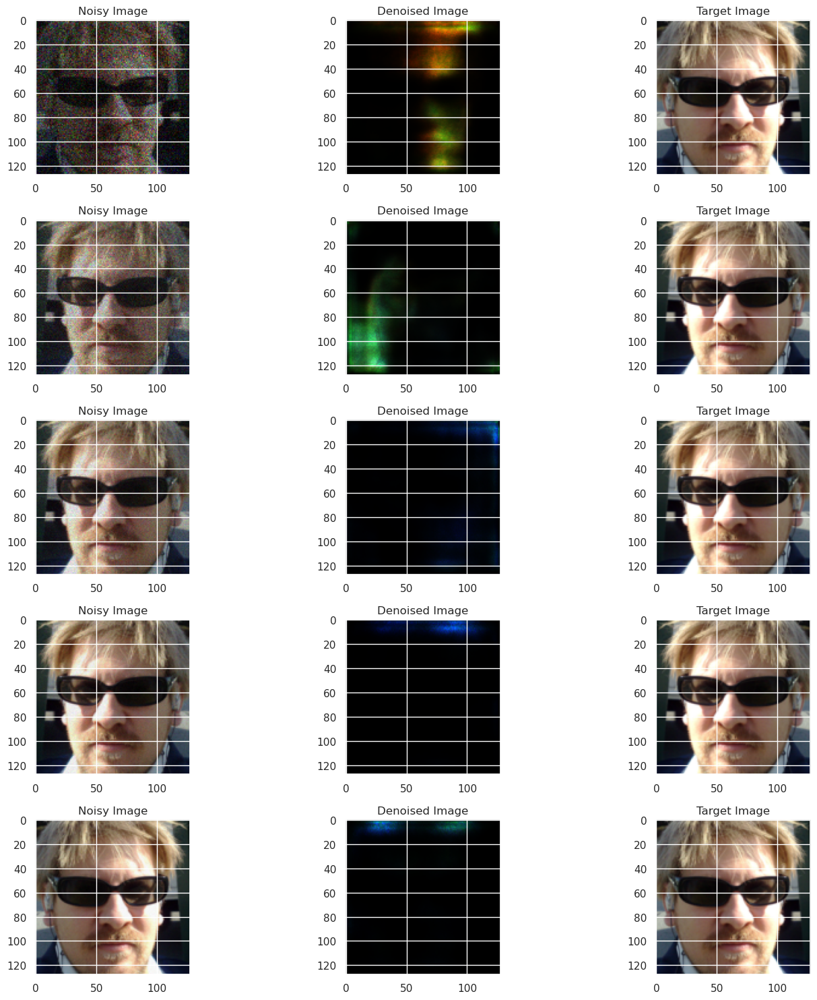

In [160]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [161]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Eighth Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)

def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model.eval()
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = torch.zeros(Noisy_Images.shape[0], 3, 128, 128).to(device)
    
    # Process batches correctly without slicing errors
    batch_size = 32
    with torch.no_grad():
        for i in range(0, Noisy_Images.shape[0], batch_size):
            batch_end = min(i + batch_size, Noisy_Images.shape[0])  # Ensure no overflow
            Predictions[i:batch_end] = model(Noisy_Images[i:batch_end]).detach()

        # Adjust predictions after getting model output
        Predictions = torch.exp(Predictions - Predictions.max())  # Handle exp safely to avoid overflow
        Predictions = Noisy_Images.detach().sum(dim=(1, 2, 3), keepdim=True) * Predictions / Predictions.sum(dim=(1, 2, 3), keepdim=True)
        
        perceptual_score = lpips_model(Target_Images, Predictions)
        perceptual_score = 1 - perceptual_score
        
        # Move everything to CPU for further processing
        Noisy_Images = Noisy_Images.cpu().numpy()
        Target_Images = Target_Images.cpu().numpy()
        Predictions = Predictions.cpu().numpy()
        perceptual_score = perceptual_score.cpu().numpy()

        # Normalize Predictions correctly
        Predictions = Predictions / Predictions.mean(axis=(1, 2, 3), keepdims=True)
        
        # Compute PSNR and SSIM scores
        Psnr_Scores = [psnr(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        SSIM_Scores = [ssim(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        
        return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_9 = np.array(Psnr_Distribution)
SSIM_Distribution_9 = np.array(SSIM_Distribution)
Perceptual_Distribution_9 = np.array(Perceptual_Distribution)
Psnr_Distribution_9.shape, SSIM_Distribution_9.shape, Perceptual_Distribution_9.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/weights/v0.1/alex.pth
-40-32


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(model_pa

-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

In [162]:
np.save("Data/Psnr_Distribution_m32_32b.npy", Psnr_Distribution_9)
np.save("Data/SSIM_Distribution_m32_32b.npy", SSIM_Distribution_9)
np.save("Data/Perceptual_Distribution_m32_32b.npy", Perceptual_Distribution_9)

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,6.803840,-3.559511,6.913322,2.412250,9.325572,4.501072
std,8.156668,20.564969,7.728340,1.064201,6.929272,8.585145
min,-15.383768,-39.119021,-6.439857,0.679836,-2.374547,-11.206834
25%,0.006849,-21.339266,-0.975090,1.594288,2.439102,-4.271042
50%,6.786079,-3.559511,6.315997,2.077026,8.592407,4.419570
75%,14.506984,14.220245,14.293494,3.107892,16.038457,12.700190
max,20.897265,32.000000,17.541005,5.813663,19.671027,16.099468


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.259268,-3.559511,0.260959,0.052286,0.313244,0.208673
std,0.159636,20.564969,0.150177,0.018256,0.161774,0.140006
min,-0.046062,-39.119021,-0.005206,0.013795,0.021755,-0.036912
25%,0.109504,-21.339266,0.108946,0.038908,0.146957,0.070761
50%,0.256221,-3.559511,0.248029,0.051166,0.287747,0.209845
75%,0.395913,14.220245,0.401952,0.065320,0.465326,0.338419
max,0.629100,32.000000,0.508156,0.098869,0.570104,0.459712


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.263669,-3.119021,0.262405,0.041466,0.269564,0.255246
std,0.131636,20.310653,0.124951,0.014977,0.126960,0.123042
min,-0.054064,-38.238042,0.091229,0.011002,0.095955,0.082554
25%,0.128747,-20.678532,0.120375,0.030674,0.124038,0.116225
50%,0.310309,-3.119021,0.337517,0.040891,0.347766,0.326092
75%,0.375700,14.440489,0.377619,0.050601,0.386881,0.368728
max,0.509885,32.000000,0.420944,0.092864,0.429937,0.413728


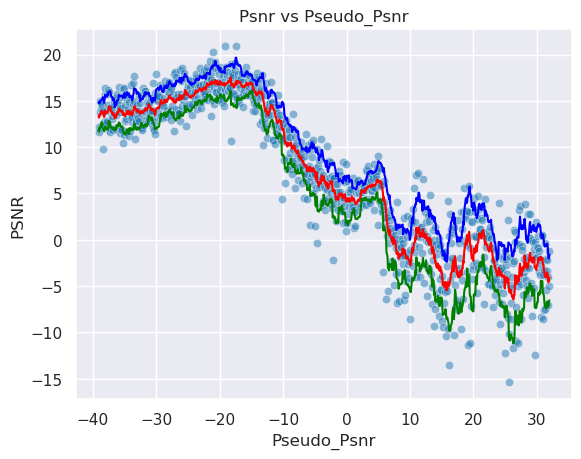

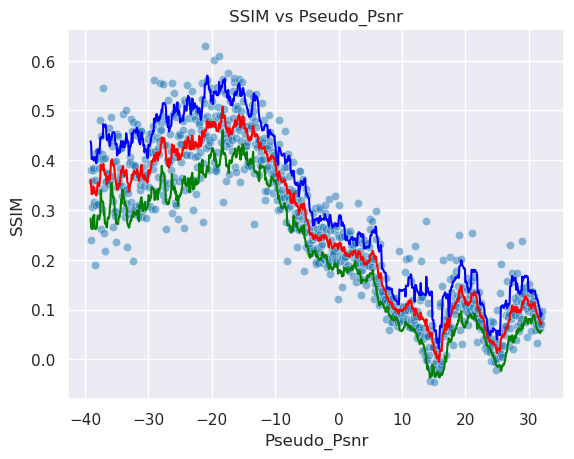

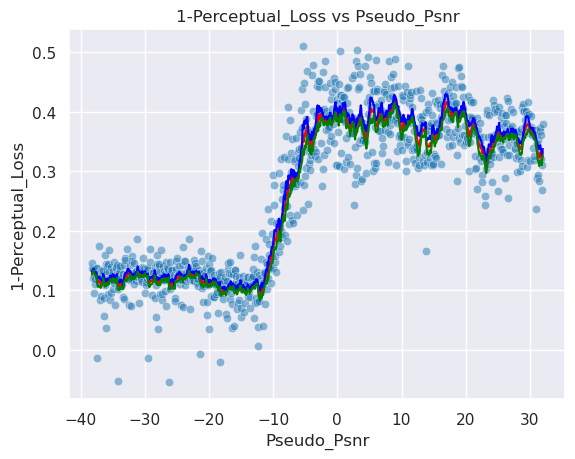

Psnr Area: 491.85131477315576, SSIM Area: 18.562583396136418, Perceptual Area: 18.433338839697495
Mean Psnr 6.80383965475722
Std Psnr 8.156667931151327
Min Psnr -15.383768401095384
Max Psnr 20.897265007539815
Mean Roll Var 2.4122498101221748
Mean SSIM 0.25926834
Std SSIM 0.15963616967201233
Min SSIM -0.04606233909726143
Max SSIM 0.6290995478630066
Mean Roll SSIM 0.052285537994193096
Mean 1-PL 0.26366866
Std 1-PL 0.13163620233535767
Min 1-PL -0.05406367778778076
Max 1-PL 0.5098845958709717
Mean Roll 1-PL 0.04146576954586002


(491.85131477315576, 18.562583396136418, 18.433338839697495)

In [163]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Eighth Highest PSNR Range.
Plot_Creater(Psnr_Distribution_9, SSIM_Distribution_9, Perceptual_Distribution_9, minpsnr, maxpsnr)

In [164]:
# Splits the data into the 9 uniformly spaced PSNR ranges.
# Generates data for the Ninth Highest PSNR Range
print(PSNR_Ranges[-9][0], PSNR_Ranges[-9][1])
Train_Dataset = FacesDataset(root_dir = root_path, names = Train_Paths, minPSNR= PSNR_Ranges[-9][0] , maxPSNR = PSNR_Ranges[-9][1], augment = True, grayscale= GREYSCALE, virtSize = 512*Batch_Size, amplification_factor = 1e3)
Val_Dataset = FacesDataset(root_dir = root_path, names = Val_Paths, minPSNR= PSNR_Ranges[-9][0], maxPSNR = PSNR_Ranges[-9][1], augment = False, grayscale= GREYSCALE, virtSize = 128*Batch_Size, amplification_factor = 1e3)
Train_Loader = DataLoader(Train_Dataset, batch_size = Batch_Size, shuffle = True)
Validation_Loader = DataLoader(Val_Dataset, batch_size = Batch_Size, shuffle = False)
Train_Dataset.__len__(), Val_Dataset.__len__()

-40 -32


(16384, 4096)

In [165]:
# Define the callbacks for the model training and validation.
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, verbose=True, mode='min')
lr_monitor = LearningRateMonitor(logging_interval='step')
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, mode='min', verbose=True)


# Create the U-net model
in_channels = 3
levels = 10
depth = 6
start_filts = 50
up_mode = 'upsample'
merge_mode = 'concat'

model = UNet(channels = in_channels, levels=levels, depth=depth,
                start_filts=start_filts, up_mode = up_mode, merge_mode = "concat").to(device)

/home/linux/KaylenGAP/MScGAPProject/OriginalGAPUNet.py:256: FutureWarning: `nn.init.xavier_normal` is now deprecated in favor of `nn.init.xavier_normal_`.
  init.xavier_normal(m.weight)
/home/linux/KaylenGAP/MScGAPProject/OriginalGAPUNet.py:257: FutureWarning: `nn.init.constant` is now deprecated in favor of `nn.init.constant_`.
  init.constant(m.bias, 0)


In [166]:
# Creates the directory to save the model in for the Ninth Highest PSNR Range.
name = "FaceGenerationUNet128x128-m40-m32"
CHECKPOINT_PATH = "./models/" 

In [167]:
# Trains the model using the Pytorch Lightning Trainer for the Ninth Highest PSNR Range.
Trainer = pL.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator= "gpu", devices = [0],
                     max_epochs=max_epochs,
                     callbacks=[#ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=20)])

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


In [168]:
# Trains the model using the Pytorch Lightning Trainer for the Ninth Highest PSNR Range.
Trainer.fit(model, Train_Loader, Validation_Loader)
Trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

Missing logger folder: models/FaceGenerationUNet128x128-m40-m32/lightning_logs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type       | Params | Mode 
--------------------------------------------------
0 | conv_final | Conv2d     | 153    | train
1 | down_convs | ModuleList | 76.8 M | train
2 | up_convs   | ModuleList | 32.4 M | train
--------------------------------------------------
109 M     Trainable params
0         Non-trainable params
109 M     Total params
436.777   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=30` reached.


In [169]:
# Loads the model from the checkpoint for the Ninth Highest PSNR Range.
model = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lightning_fabric/utilities/cloud_io.py:57: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.


In [170]:
# Validates the trained model on the Train Set for the Ninth Highest PSNR Range.
Trainer.test(model, Train_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:475: Your `test_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you turn shuffling off for val/test dataloaders.
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:424: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=27` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   -0.047546856105327606   │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.047546856105327606}]

In [171]:
# Validates the trained model on the Validation Set for the Ninth Highest PSNR Range.
Trainer.test(model, Validation_Loader)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    -0.0473569892346859    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': -0.0473569892346859}]

1.8089103 0.07203625 1.7608860731124878 0.9604833126068115
torch.Size([3, 128, 128]) torch.Size([3, 128, 128]) torch.Size([3, 128, 128])
PSNR: -35.39447784423828
-36.12359947967774 -36.12359947967774 0.0


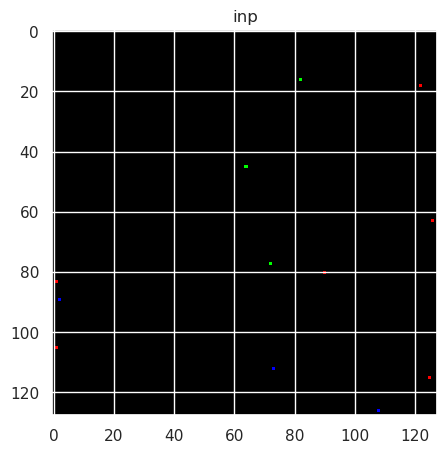

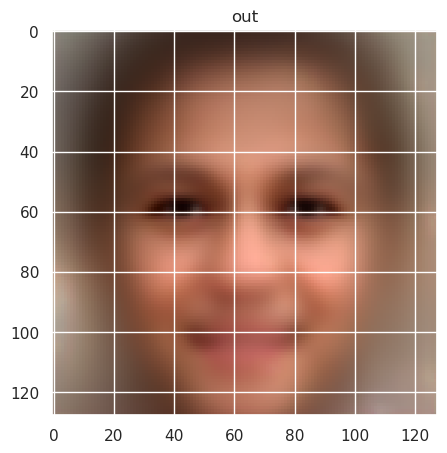

Text(0.5, 1.0, 'GT')

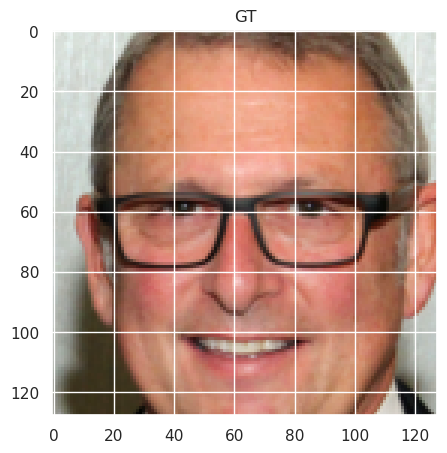

In [172]:
# Draws a sample noisy image, denoises it using the model and evaluates the visual quality of the denoised image.
ImageNoise, Psnr_map, image_target = Train_Dataset.__getitem__(10)
model = model.to(device)
inp_img = ImageNoise.unsqueeze(0).to(device)
out = model(inp_img)
out = out.detach().cpu()
out -= out.max()
out = torch.exp(out)
out = ImageNoise.sum() * out / out.sum()
out = out.squeeze(0)

print(image_target.max().detach().cpu().numpy(), image_target.min().detach().cpu().numpy(), np.percentile(image_target, 99.9), np.percentile(image_target, 50))
print(ImageNoise.shape, out.shape, image_target.shape)
print(f"PSNR: {Psnr_map.min().detach().cpu().numpy()}")

Psnr = np.log10(ImageNoise.mean().item()+ 1e-50) * 10
Psnr = max(-40,Psnr)

Psnr_out = np.log10(out.mean().item()+ 1e-50) * 10
Psnr_out = max(-40,Psnr_out)

Pnsr_Target = np.log10(image_target.mean().item()+ 1e-50) * 10
Pnsr_Target = max(-40,Pnsr_Target)

print(Psnr, Psnr_out, Pnsr_Target)

ImageNoise = (ImageNoise - ImageNoise.min())/(ImageNoise.max() - ImageNoise.min())
image_target = (image_target - image_target.min())/(image_target.max() - image_target.min())
out = (out - out.min())/(out.max() - out.min())
vmax = np.percentile(image_target, 99.9)

plt.figure(figsize=(5,5))
plt.imshow(ImageNoise.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('inp')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(out.permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
plt.title('out')
plt.show()
    
plt.figure(figsize=(5,5))
plt.imshow(image_target.permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
plt.title('GT')

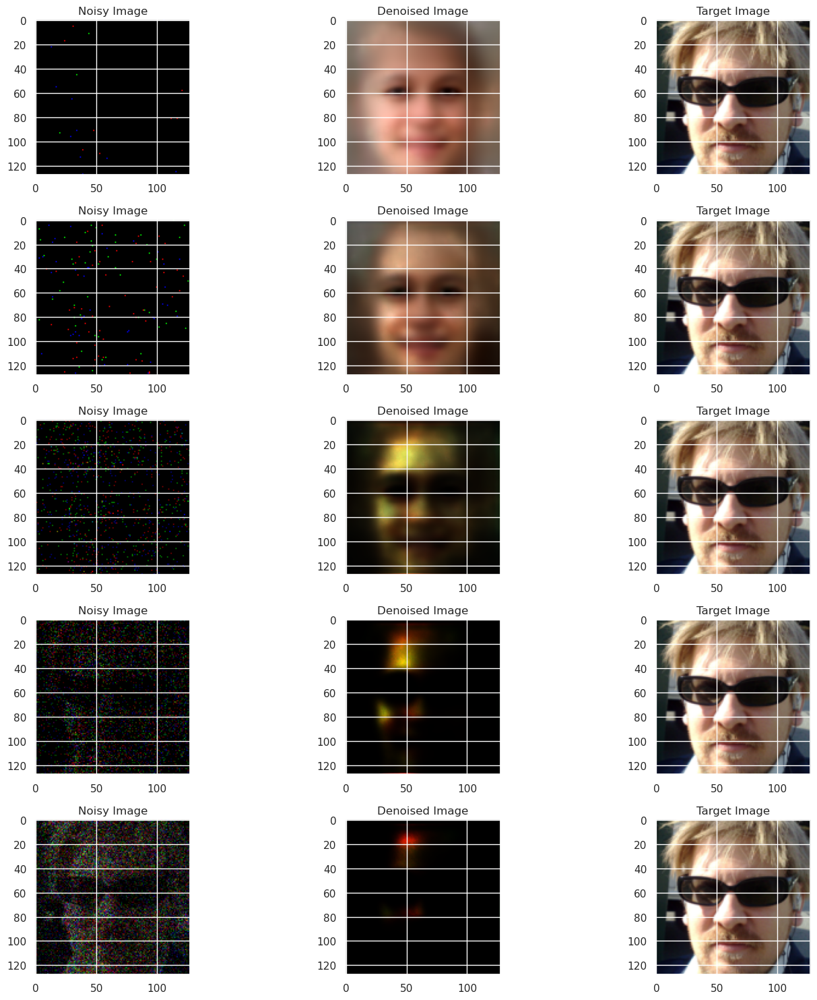

In [173]:
# Plots for a sample image the Noisy Image, its corresponding denoised image
Noisy_Images, Psnr_Maps, Image_Targets = ValidationNoisyTest_Batch.clone(), ValidationPsnrTest_Batch.clone(), ValidationTargetTest_Batch.clone()
Noisy_Images = Noisy_Images.to(device)
Psnr_Maps = Psnr_Maps.to(device)
Image_Targets = Image_Targets.to(device)
model = model.to(device)
model.eval()
with torch.no_grad():
    Denoised_Images = model(Noisy_Images).detach().cpu().numpy()
    
Denoised_Images -= Denoised_Images.max(axis=(1,2,3), keepdims=True)
Denoised_Images = np.exp(Denoised_Images)
Denoised_Images = Noisy_Images.cpu().detach().numpy().sum() * Denoised_Images / Denoised_Images.sum(axis = (1,2,3), keepdims=True)
Denoised_Images = Denoised_Images.transpose(0,2,3,1)

Noisy_Images = Noisy_Images.cpu().detach().numpy().transpose(0,2,3,1)
Image_Targets = Image_Targets.cpu().detach().numpy().transpose(0,2,3,1)
Psnr_Maps = Psnr_Maps.cpu().detach().numpy().transpose(0,2,3,1)

Normalised_Noisy_Images = (Noisy_Images - Noisy_Images.min(axis = (1,2,3), keepdims=True))/(Noisy_Images.max(axis = (1,2,3), keepdims=True) - Noisy_Images.min(axis = (1,2,3), keepdims=True))
Normalised_Image_Targets = (Image_Targets - Image_Targets.min(axis = (1,2,3), keepdims=True))/(Image_Targets.max(axis = (1,2,3), keepdims=True) - Image_Targets.min(axis = (1,2,3), keepdims=True))
Normalised_Denoised_Images = (Denoised_Images - Denoised_Images.min(axis = (1,2,3), keepdims=True))/(Denoised_Images.max(axis = (1,2,3), keepdims=True) - Denoised_Images.min(axis = (1,2,3), keepdims=True))

Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    Axes[index, 0].imshow(Normalised_Noisy_Images[index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

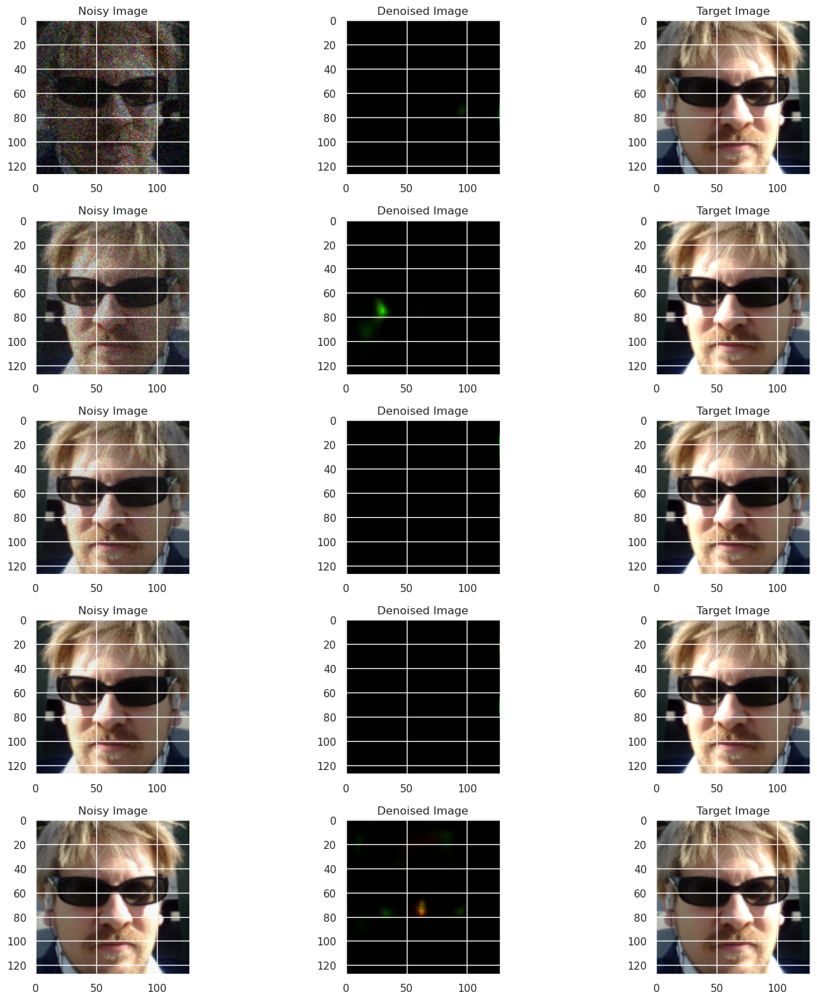

In [174]:
# Continuation of above.
Figure, Axes = plt.subplots(5, 3, figsize=(15,15))
for index in range(5):
    actual_index = index + 5
    Axes[index, 0].imshow(Normalised_Noisy_Images[actual_index])
    Axes[index, 0].set_title("Noisy Image")
    Axes[index, 1].imshow(Normalised_Denoised_Images[actual_index])
    Axes[index, 1].set_title("Denoised Image")
    Axes[index, 2].imshow(Normalised_Image_Targets[actual_index])
    Axes[index, 2].set_title("Target Image")
plt.tight_layout()
plt.show()

In [175]:
# Generates the Psnr, SSIM and Perceptual Loss Scores of the model on the Validation Set for the Ninth Highest PSNR Range.
lpips_model = lpips.LPIPS(net='alex').to(device)

def Generate_Psnr_Scores(model, Noisy_Images, Psnr_Maps, Target_Images):
    model.eval()
    model = model.to(device)
    Noisy_Images = Noisy_Images.to(device)
    Psnr_Maps = Psnr_Maps.to(device)
    Target_Images = Target_Images.to(device)

    Predictions = torch.zeros(Noisy_Images.shape[0], 3, 128, 128).to(device)
    
    # Process batches correctly without slicing errors
    batch_size = 32
    with torch.no_grad():
        for i in range(0, Noisy_Images.shape[0], batch_size):
            batch_end = min(i + batch_size, Noisy_Images.shape[0])  # Ensure no overflow
            Predictions[i:batch_end] = model(Noisy_Images[i:batch_end]).detach()

        # Adjust predictions after getting model output
        Predictions = torch.exp(Predictions - Predictions.max())  # Handle exp safely to avoid overflow
        Predictions = Noisy_Images.detach().sum(dim=(1, 2, 3), keepdim=True) * Predictions / Predictions.sum(dim=(1, 2, 3), keepdim=True)
        
        perceptual_score = lpips_model(Target_Images, Predictions)
        perceptual_score = 1 - perceptual_score
        
        # Move everything to CPU for further processing
        Noisy_Images = Noisy_Images.cpu().numpy()
        Target_Images = Target_Images.cpu().numpy()
        Predictions = Predictions.cpu().numpy()
        perceptual_score = perceptual_score.cpu().numpy()

        # Normalize Predictions correctly
        Predictions = Predictions / Predictions.mean(axis=(1, 2, 3), keepdims=True)
        
        # Compute PSNR and SSIM scores
        Psnr_Scores = [psnr(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min()) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        SSIM_Scores = [ssim(Target_Image, Prediction, data_range=Target_Image.max() - Target_Image.min(), channel_axis=0) for Target_Image, Prediction in zip(Target_Images, Predictions)]
        
        return Psnr_Scores, SSIM_Scores, perceptual_score.reshape(-1,)

Psnr_Distribution = []
SSIM_Distribution = []
Perceptual_Distribution = []
for key in Validation_Noisy_Images.keys():
    if key == "3240":
        continue
    print(key)
    Psnr_Scores, SSIM_Scores, Perceptual_Scores = Generate_Psnr_Scores(model, Validation_Noisy_Images[key], Validation_Psnr_Maps[key], Validation_Target_Images[key])
    Psnr_Distribution.extend(Psnr_Scores)
    SSIM_Distribution.extend(SSIM_Scores)
    Perceptual_Distribution.extend(Perceptual_Scores)
Psnr_Distribution_10 = np.array(Psnr_Distribution)
SSIM_Distribution_10 = np.array(SSIM_Distribution)
Perceptual_Distribution_10 = np.array(Perceptual_Distribution)
Psnr_Distribution_10.shape, SSIM_Distribution_10.shape, Perceptual_Distribution_10.shape

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/weights/v0.1/alex.pth
-40-32


/home/linux/anaconda3/envs/GAPProject/lib/python3.11/site-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(model_pa

-32-24
-24-16
-16-8
-80
08
816
1624
2432


((900,), (900,), (900,))

In [176]:
np.save("Data/Psnr_Distribution_m40_32b.npy", Psnr_Distribution_10)
np.save("Data/SSIM_Distribution_m40_32b.npy", SSIM_Distribution_10)
np.save("Data/Perceptual_Distribution_m40_32b.npy", Perceptual_Distribution_10)

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,-4.078266,-3.559511,-3.841150,4.286934,0.445784,-8.128084
std,14.010084,20.564969,13.161390,2.441275,11.036962,15.380165
min,-30.809820,-39.119021,-24.122936,0.899442,-20.231679,-29.603666
25%,-14.798429,-21.339266,-15.403222,1.787657,-8.581905,-21.966854
50%,-5.831931,-3.559511,-8.262367,4.555849,-3.405125,-12.915828
75%,11.448998,14.220245,13.132648,6.534176,14.455881,11.529421
max,18.147896,32.000000,15.267088,9.521082,16.940300,14.017421


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,889.000000,889.000000,889.000000,889.000000,889.000000,889.000000
mean,0.152862,-3.559511,0.155039,0.043212,0.198251,0.111826
std,0.160164,20.564969,0.153581,0.023587,0.170066,0.139156
min,-0.004026,-39.119021,0.005529,0.004302,0.013758,-0.041043
25%,0.020731,-21.339266,0.030019,0.018700,0.053713,0.000702
50%,0.055432,-3.559511,0.053268,0.042957,0.102646,0.019972
75%,0.301762,14.220245,0.351631,0.062527,0.409855,0.278656
max,0.563281,32.000000,0.433539,0.101793,0.495705,0.378076


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,878.000000,878.000000,878.000000,878.000000,878.000000,878.000000
mean,0.267717,-3.119021,0.266444,0.040666,0.273472,0.259415
std,0.116467,20.310653,0.109236,0.014700,0.110878,0.107688
min,-0.053609,-38.238042,0.086757,0.011060,0.093022,0.080492
25%,0.137497,-20.678532,0.125357,0.030642,0.129120,0.121702
50%,0.316561,-3.119021,0.335220,0.039285,0.344394,0.326436
75%,0.365051,14.440489,0.355231,0.048255,0.361921,0.347611
max,0.489326,32.000000,0.387593,0.090669,0.397798,0.377388


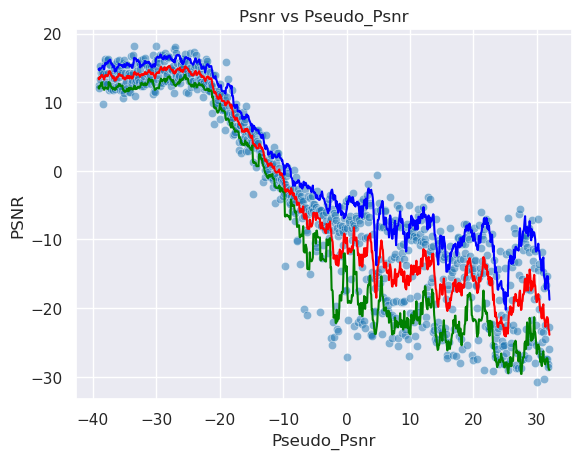

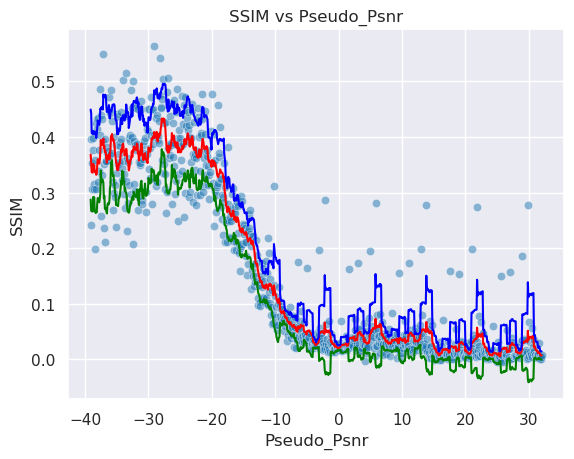

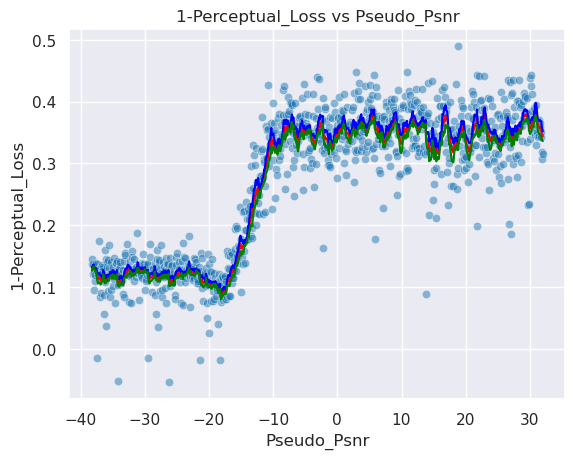

Psnr Area: -273.06947885791664, SSIM Area: 11.02356722318887, Perceptual Area: 18.716854388575932
Mean Psnr -4.0782663427948025
Std Psnr 14.010083623666903
Min Psnr -30.809819621431206
Max Psnr 18.14789579723044
Mean Roll Var 4.286933590888993
Mean SSIM 0.15286225
Std SSIM 0.16016413271427155
Min SSIM -0.00402592308819294
Max SSIM 0.5632809996604919
Mean Roll SSIM 0.04321210079946499
Mean 1-PL 0.26771748
Std 1-PL 0.11646725982427597
Min 1-PL -0.053609251976013184
Max 1-PL 0.4893256425857544
Mean Roll 1-PL 0.04066565870775858


(-273.06947885791664, 11.02356722318887, 18.716854388575932)

In [177]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Ninth Highest PSNR Range.
Plot_Creater(Psnr_Distribution_10, SSIM_Distribution_10, Perceptual_Distribution_10, minpsnr, maxpsnr)

In [25]:
Psnr_Distribution_1 = np.load("Data/Psnr_Distribution_0.npy")
SSIM_Distribution_1 = np.load("Data/SSIM_Distribution_0.npy")    
Perceptual_Distribution_1 = np.load("Data/Perceptual_Distribution_0.npy")

Psnr_Distribution_2 = np.load("Data/Psnr_Distribution_24_32b.npy")
SSIM_Distribution_2 = np.load("Data/SSIM_Distribution_24_32b.npy")   
Perceptual_Distribution_2 = np.load("Data/Perceptual_Distribution_24_32b.npy")

Psnr_Distribution_3 = np.load("Data/Psnr_Distribution_16_32b.npy")
SSIM_Distribution_3 = np.load("Data/SSIM_Distribution_16_32b.npy")
Perceptual_Distribution_3 = np.load("Data/Perceptual_Distribution_16_32b.npy")

Psnr_Distribution_4 = np.load("Data/Psnr_Distribution_8_32b.npy")
SSIM_Distribution_4 = np.load("Data/SSIM_Distribution_8_32b.npy")
Perceptual_Distribution_4 = np.load("Data/Perceptual_Distribution_8_32b.npy")

Psnr_Distribution_5 = np.load("Data/Psnr_Distribution_0_32b.npy")    
SSIM_Distribution_5 = np.load("Data/SSIM_Distribution_0_32b.npy")
Perceptual_Distribution_5 = np.load("Data/Perceptual_Distribution_0_32b.npy")

Psnr_Distribution_6 = np.load("Data/Psnr_Distribution_m8_32b.npy")
SSIM_Distribution_6 = np.load("Data/SSIM_Distribution_m8_32b.npy")
Perceptual_Distribution_6 = np.load("Data/Perceptual_Distribution_m8_32b.npy")

Psnr_Distribution_7 = np.load("Data/Psnr_Distribution_m16_32b.npy")
SSIM_Distribution_7 = np.load("Data/SSIM_Distribution_m16_32b.npy")
Perceptual_Distribution_7 = np.load("Data/Perceptual_Distribution_m16_32b.npy")

Psnr_Distribution_8 = np.load("Data/Psnr_Distribution_m24_32b.npy")
SSIM_Distribution_8 = np.load("Data/SSIM_Distribution_m24_32b.npy")
Perceptual_Distribution_8 = np.load("Data/Perceptual_Distribution_m24_32b.npy")

Psnr_Distribution_9 = np.load("Data/Psnr_Distribution_m32_32b.npy")
SSIM_Distribution_9 = np.load("Data/SSIM_Distribution_m32_32b.npy")
Perceptual_Distribution_9 = np.load("Data/Perceptual_Distribution_m32_32b.npy")

Psnr_Distribution_10 = np.load("Data/Psnr_Distribution_m40_32b.npy")
SSIM_Distribution_10 = np.load("Data/SSIM_Distribution_m40_32b.npy") 
Perceptual_Distribution_10 = np.load("Data/Perceptual_Distribution_m40_32b.npy")


In [26]:
# Combines the data from the 9 uniformly spaced PSNR ranges into a single dataframe.
uniform = np.linspace(-40, 32, 900)
Psnr_Distribution = pd.DataFrame({"Psuedo_Psnr":uniform, "Psnr_Distribution_m40_32":Psnr_Distribution_1, "Psnr_Distribution_24_32":Psnr_Distribution_2, "Psnr_Distribution_16_24":Psnr_Distribution_3, 
                                  "Psnr_Distribution_8_16":Psnr_Distribution_4, "Psnr_Distribution_0_8":Psnr_Distribution_5, "Psnr_Distribution_m8_0":Psnr_Distribution_6, 
                                  "Psnr_Distribution_m16_m8":Psnr_Distribution_7, "Psnr_Distribution_m24_m16":Psnr_Distribution_8, "Psnr_Distribution_m32_m24":Psnr_Distribution_9, 
                                  "Psnr_Distribution_m40_m32":Psnr_Distribution_10})
Psnr_Distribution

,Psuedo_Psnr,Psnr_Distribution_m40_32,Psnr_Distribution_24_32,Psnr_Distribution_16_24,Psnr_Distribution_8_16,Psnr_Distribution_0_8,Psnr_Distribution_m8_0,Psnr_Distribution_m16_m8,Psnr_Distribution_m24_m16,Psnr_Distribution_m32_m24,Psnr_Distribution_m40_m32
0,-40.000000,13.931335,-11.601313,-15.290301,-8.305859,-4.625904,-8.686549,1.204146,7.965330,13.487273,13.971093
1,-39.919911,11.197247,-14.656991,-18.404453,-11.630762,-7.858856,-12.722479,-1.051871,7.042907,10.745531,11.264569
2,-39.839822,15.486684,-10.084936,-13.852092,-7.179682,-3.400152,-8.607787,4.073569,9.633423,14.704423,14.757774
3,-39.759733,12.448342,-9.004909,-12.658004,-5.826681,-2.272947,-6.539519,3.666585,8.946536,13.235443,13.034628
4,-39.679644,11.442880,-9.578383,-13.327440,-6.621408,-2.997527,-7.698345,3.400789,9.025577,11.416425,11.512735
...,...,...,...,...,...,...,...,...,...,...,...
895,31.679644,26.798373,35.698416,9.952625,5.313564,-4.630015,2.686256,-21.731217,-9.546684,-3.368420,-27.420714
896,31.759733,28.674237,38.008996,12.199434,4.277497,-11.706106,0.216620,-25.076601,-16.181068,-3.981656,-28.084460
897,31.839822,29.096009,37.837596,17.421135,3.144764,-8.104466,-0.215026,-24.859689,-18.950699,-7.054433,-28.556049
898,31.919911,30.148988,39.540944,8.079102,3.798708,-4.426352,2.089462,-19.939028,-8.499146,-5.044513,-25.984141


In [27]:
# Generates the smoothed Psnr Distribution for the combined data.
Smoothed_Psnr_Distribution = Psnr_Distribution.rolling(window=10).mean()
Smoothed_Psnr_Distribution = Smoothed_Psnr_Distribution.dropna()
Smoothed_Psnr_Distribution

,Psuedo_Psnr,Psnr_Distribution_m40_32,Psnr_Distribution_24_32,Psnr_Distribution_16_24,Psnr_Distribution_8_16,Psnr_Distribution_0_8,Psnr_Distribution_m8_0,Psnr_Distribution_m16_m8,Psnr_Distribution_m24_m16,Psnr_Distribution_m32_m24,Psnr_Distribution_m40_m32
9,-39.639600,13.287141,-10.570261,-14.286650,-7.438668,-3.901005,-8.869857,1.807307,8.885616,13.198371,13.359208
10,-39.559511,13.361748,-10.452495,-14.169191,-7.325758,-3.799428,-8.758751,1.923757,9.108990,13.446756,13.522822
11,-39.479422,13.514017,-10.244363,-13.959726,-7.117584,-3.645815,-8.536325,2.029545,9.121220,13.592125,13.651228
12,-39.399333,13.179642,-10.055482,-13.766851,-6.917961,-3.453121,-8.293975,2.148451,9.063427,13.282281,13.379048
13,-39.319244,13.476313,-10.254812,-13.965920,-7.051408,-3.580314,-8.337544,1.913977,9.063363,13.460735,13.600233
...,...,...,...,...,...,...,...,...,...,...,...
895,31.319244,29.550289,38.487999,15.502989,3.794247,-8.837858,-0.755246,-28.770265,-12.810158,-4.397709,-21.948484
896,31.399333,29.333183,38.277671,14.527424,3.947312,-9.131115,-0.537186,-28.364536,-13.344812,-3.944193,-22.406731
897,31.479422,29.168538,38.079866,14.298479,3.848679,-9.276935,-0.422297,-27.835354,-14.567431,-4.271859,-23.794454
898,31.559511,29.226247,38.121315,13.085399,4.112258,-8.771365,0.244708,-26.729529,-13.809265,-4.445363,-23.354774


In [28]:
str(PSNR_Ranges[0][0]) + "_" + str(PSNR_Ranges[-1][1])

'-40_32'

In [29]:
Psnr_columns = ["m40_32", "24_32", "16_24", "8_16", "0_8", "m8_0", "m16_m8", "m24_m16", "m32_m24", "m40_m32"]

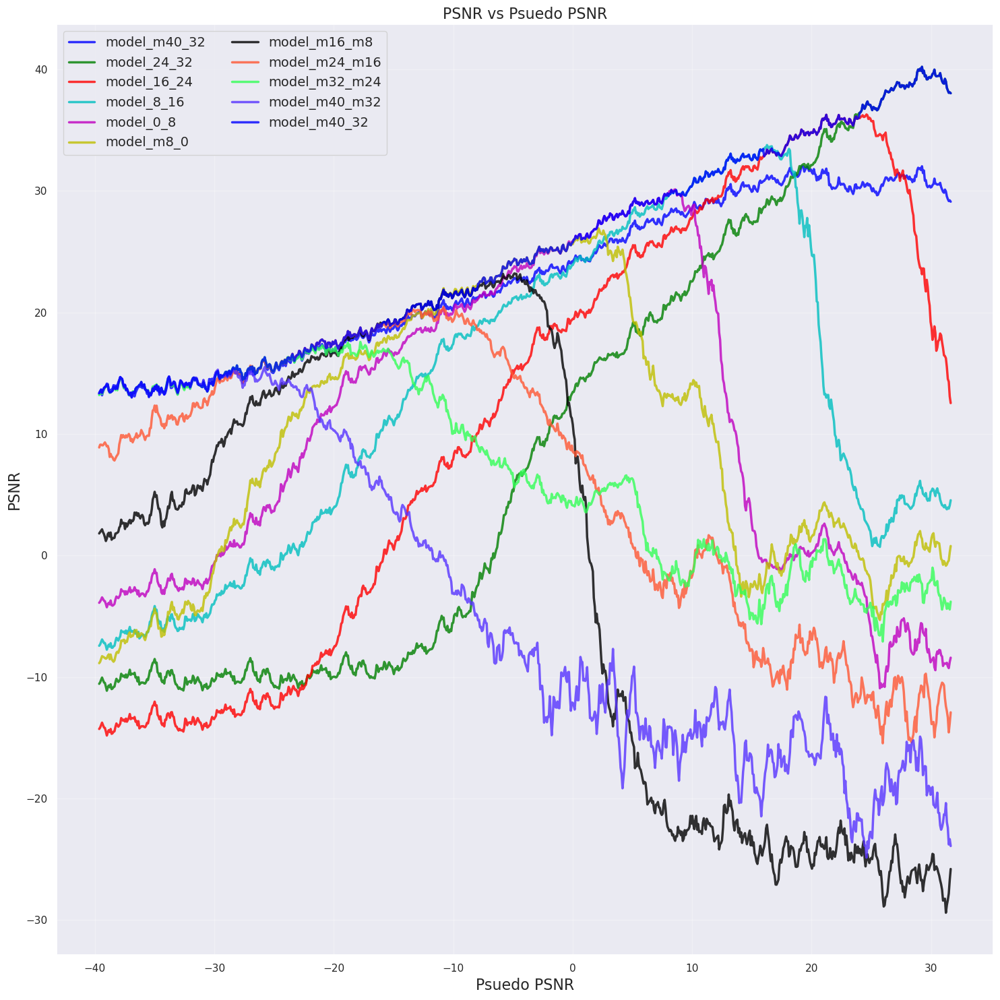

In [51]:
# Plots the PSNR vs Psuedo PSNR for the different models in the cascade.
plt.figure(figsize=(15,15))
sns.set_style("darkgrid")
markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', 'h']
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', '#ff5733', '#33ff57', '#5733ff']
labels = [f"model_{psnr}" for psnr in Psnr_columns]
for idx, psnr in enumerate(Smoothed_Psnr_Distribution.columns[1:]):
    marker = markers[idx % len(markers)]
    label = labels[idx % len(labels)]
    color = colors[idx % len(colors)]
    sns.lineplot(data = Smoothed_Psnr_Distribution, x = "Psuedo_Psnr", y = psnr, alpha = 0.8, color = color, linewidth = 2.5, label = label)
plt.xlabel("Psuedo PSNR", fontsize = 16)
plt.ylabel("PSNR", fontsize = 16)
plt.grid(True, alpha = 0.3)
plt.title("PSNR vs Psuedo PSNR", fontsize = 16)
plt.legend(fontsize = 14, loc = "upper left", ncol = 2)
plt.tight_layout()
plt.savefig("Figures/PSNR_vs_Psuedo_PSNR_Cascade_Models.pdf", format = "pdf", dpi = 300)
plt.show()

In [31]:
# Combines the 9 different models into a single model.
Augmented_Psnr_Distribution = []
for idx in range(len(PSNR_Ranges)):
    Psnr_query = Smoothed_Psnr_Distribution.query(f"Psuedo_Psnr >= {PSNR_Ranges[idx][0]} and Psuedo_Psnr <= {PSNR_Ranges[idx][1]}")
    Specific_Psnr_Distribution = Psnr_query.iloc[:, -(idx+1)].values
    Augmented_Psnr_Distribution.extend(Specific_Psnr_Distribution)
Augmented_Psnr_Distribution = np.array(Augmented_Psnr_Distribution)
Augmented_Psnr_Distribution.shape

(891,)

In [32]:
Smoothed_Psnr_Distribution

,Psuedo_Psnr,Psnr_Distribution_m40_32,Psnr_Distribution_24_32,Psnr_Distribution_16_24,Psnr_Distribution_8_16,Psnr_Distribution_0_8,Psnr_Distribution_m8_0,Psnr_Distribution_m16_m8,Psnr_Distribution_m24_m16,Psnr_Distribution_m32_m24,Psnr_Distribution_m40_m32
9,-39.639600,13.287141,-10.570261,-14.286650,-7.438668,-3.901005,-8.869857,1.807307,8.885616,13.198371,13.359208
10,-39.559511,13.361748,-10.452495,-14.169191,-7.325758,-3.799428,-8.758751,1.923757,9.108990,13.446756,13.522822
11,-39.479422,13.514017,-10.244363,-13.959726,-7.117584,-3.645815,-8.536325,2.029545,9.121220,13.592125,13.651228
12,-39.399333,13.179642,-10.055482,-13.766851,-6.917961,-3.453121,-8.293975,2.148451,9.063427,13.282281,13.379048
13,-39.319244,13.476313,-10.254812,-13.965920,-7.051408,-3.580314,-8.337544,1.913977,9.063363,13.460735,13.600233
...,...,...,...,...,...,...,...,...,...,...,...
895,31.319244,29.550289,38.487999,15.502989,3.794247,-8.837858,-0.755246,-28.770265,-12.810158,-4.397709,-21.948484
896,31.399333,29.333183,38.277671,14.527424,3.947312,-9.131115,-0.537186,-28.364536,-13.344812,-3.944193,-22.406731
897,31.479422,29.168538,38.079866,14.298479,3.848679,-9.276935,-0.422297,-27.835354,-14.567431,-4.271859,-23.794454
898,31.559511,29.226247,38.121315,13.085399,4.112258,-8.771365,0.244708,-26.729529,-13.809265,-4.445363,-23.354774


In [33]:
idx = 8
print(PSNR_Ranges[idx][0], PSNR_Ranges[idx][1])
Specific_Psnr_Distribution = Smoothed_Psnr_Distribution.query(f"Psuedo_Psnr >= {PSNR_Ranges[idx][0]} and Psuedo_Psnr <= {PSNR_Ranges[idx][1]}")
Specific_Psnr_Distribution.iloc[:, -(idx+1)]

24 32


804    36.438519
805    36.495615
806    36.653043
807    37.097793
808    36.976866
         ...    
895    38.487999
896    38.277671
897    38.079866
898    38.121315
899    38.043687
Name: Psnr_Distribution_24_32, Length: 96, dtype: float64

In [34]:
Augmented_Psnr_Distribution.shape

(891,)

In [35]:
Smoothed_Psnr_Distribution["Augmented_Psnr_Distribution_m40_32"] = Augmented_Psnr_Distribution

In [213]:
np.save("Data/Original_Psnr_Ensemble_Model_m40_32.npy", Smoothed_Psnr_Distribution["Augmented_Psnr_Distribution_m40_32"].values)

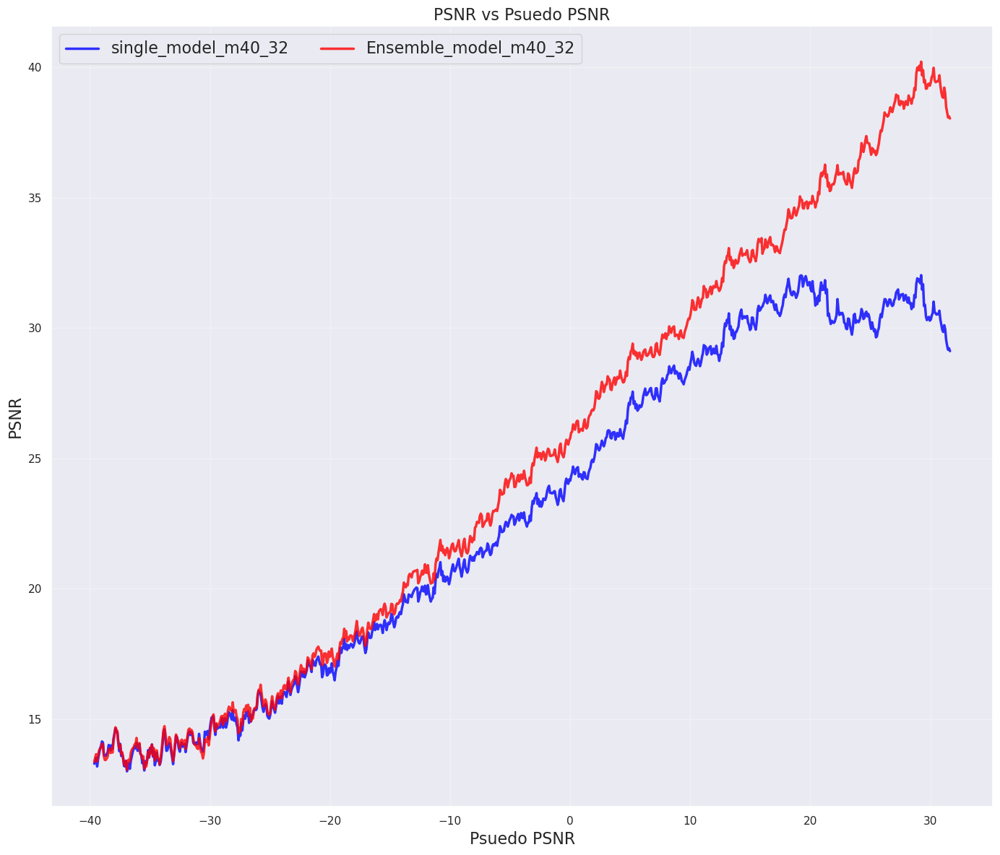

In [36]:
# Plots the PSNR vs Psuedo PSNR for the different models in the cascade and compares this to the original model.
plt.figure(figsize=(14,12))
sns.set_style("darkgrid")
sns.lineplot(data = Smoothed_Psnr_Distribution, x = "Psuedo_Psnr", y = "Psnr_Distribution_m40_32", alpha = 0.8, color = "blue", linewidth = 2.5, label = "single_model_m40_32")
sns.lineplot(data = Smoothed_Psnr_Distribution, x = "Psuedo_Psnr", y = "Augmented_Psnr_Distribution_m40_32", alpha = 0.8, color = "red", linewidth = 2.5, label = "Ensemble_model_m40_32")
plt.xlabel("Psuedo PSNR", fontsize = 16)
plt.ylabel("PSNR", fontsize = 16)
plt.grid(True, alpha = 0.3)
plt.title("PSNR vs Psuedo PSNR", fontsize = 16)
plt.legend(fontsize = 16, loc = "upper left", ncol = 2)
plt.tight_layout()
plt.savefig("Figures/PSNR_vs_Psuedo_PSNR_Ensemble_Model_m40_32.pdf", format = "pdf", dpi = 300)
plt.show()

In [37]:
# Generates the SSIM Distribution for the combined data.
uniform = np.linspace(-40, 32, 900)
SSIM_Distribution = pd.DataFrame({"Psuedo_Psnr":uniform, "SSIM_Distribution_m40_32":SSIM_Distribution_1, "SSIM_Distribution_24_32":SSIM_Distribution_2, "SSIM_Distribution_16_24":SSIM_Distribution_3, 
                                  "SSIM_Distribution_8_16":SSIM_Distribution_4, "SSIM_Distribution_0_8":SSIM_Distribution_5, "SSIM_Distribution_m8_0":SSIM_Distribution_6, 
                                  "SSIM_Distribution_m16_m8":SSIM_Distribution_7, "SSIM_Distribution_m24_m16":SSIM_Distribution_8, "SSIM_Distribution_m32_m24":SSIM_Distribution_9, 
                                  "SSIM_Distribution_m40_m32":SSIM_Distribution_10})
SSIM_Distribution

,Psuedo_Psnr,SSIM_Distribution_m40_32,SSIM_Distribution_24_32,SSIM_Distribution_16_24,SSIM_Distribution_8_16,SSIM_Distribution_0_8,SSIM_Distribution_m8_0,SSIM_Distribution_m16_m8,SSIM_Distribution_m24_m16,SSIM_Distribution_m32_m24,SSIM_Distribution_m40_m32
0,-40.000000,0.390496,0.115476,0.084216,0.138377,0.124729,0.061746,0.121168,0.233373,0.392855,0.403746
1,-39.919911,0.526384,0.166340,0.102755,0.189749,0.161408,0.069508,0.100203,0.266638,0.496114,0.524046
2,-39.839822,0.375515,0.162026,0.122524,0.242259,0.205623,0.103610,0.172330,0.285416,0.350528,0.361343
3,-39.759733,0.356718,0.144531,0.114372,0.140399,0.121180,0.082173,0.107551,0.236269,0.381764,0.378672
4,-39.679644,0.221678,0.102527,0.081798,0.125722,0.118156,0.069152,0.106300,0.158911,0.205960,0.210103
...,...,...,...,...,...,...,...,...,...,...,...
895,31.679644,0.918908,0.984714,0.191118,0.026624,0.023065,0.030696,0.000902,0.025261,0.062573,0.005558
896,31.759733,0.911203,0.976545,0.460944,0.048364,0.032227,0.072120,0.000560,0.014569,0.074409,0.001298
897,31.839822,0.906421,0.975573,0.491588,0.020922,0.019887,0.042969,0.000609,0.018550,0.070092,0.001053
898,31.919911,0.928583,0.982876,0.238327,0.013916,0.035356,0.030492,0.003380,0.038462,0.085662,0.003718


In [38]:
# Generates the smoothed SSIM Distribution for the combined data.
Smoothed_SSIM_Distribution = SSIM_Distribution.rolling(window=10).mean()
Smoothed_SSIM_Distribution = Smoothed_SSIM_Distribution.dropna()
Smoothed_SSIM_Distribution

,Psuedo_Psnr,SSIM_Distribution_m40_32,SSIM_Distribution_24_32,SSIM_Distribution_16_24,SSIM_Distribution_8_16,SSIM_Distribution_0_8,SSIM_Distribution_m8_0,SSIM_Distribution_m16_m8,SSIM_Distribution_m24_m16,SSIM_Distribution_m32_m24,SSIM_Distribution_m40_m32
9,-39.639600,0.351868,0.129258,0.094504,0.156318,0.137852,0.070990,0.110233,0.222101,0.348510,0.356087
10,-39.559511,0.356867,0.133124,0.097613,0.158838,0.139655,0.074357,0.110948,0.225895,0.355297,0.362164
11,-39.479422,0.345892,0.131051,0.096675,0.157282,0.139214,0.073489,0.109143,0.215038,0.343723,0.349382
12,-39.399333,0.332943,0.127904,0.094548,0.148255,0.133215,0.072350,0.102909,0.205833,0.332660,0.337467
13,-39.319244,0.327897,0.124555,0.091544,0.148381,0.132770,0.068896,0.099955,0.203411,0.325060,0.330247
...,...,...,...,...,...,...,...,...,...,...,...
895,31.319244,0.925335,0.979541,0.569707,0.024539,0.026480,0.040084,0.002124,0.022391,0.070269,0.008762
896,31.399333,0.923415,0.979500,0.536255,0.027480,0.027234,0.043739,0.002143,0.021962,0.071856,0.008071
897,31.479422,0.920253,0.978945,0.511066,0.027931,0.026277,0.044742,0.002149,0.020994,0.071695,0.007325
898,31.559511,0.920735,0.979372,0.461781,0.028427,0.028288,0.045209,0.002464,0.023561,0.073106,0.007274


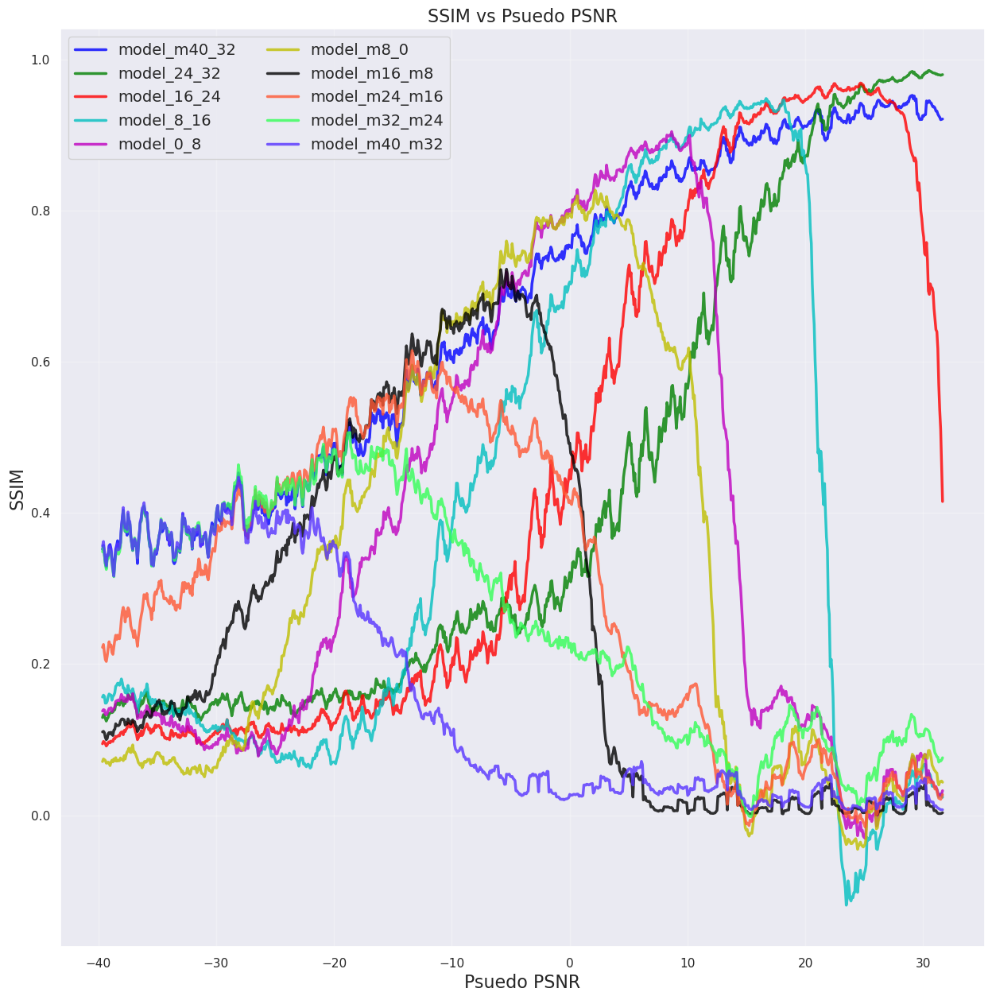

In [217]:
# Plots the SSIM vs Psuedo PSNR for the different models in the cascade.
plt.figure(figsize=(15,15))
sns.set_style("darkgrid")
markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', 'h']
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', '#ff5733', '#33ff57', '#5733ff']
labels = [f"model_{psnr}" for psnr in Psnr_columns]
for idx, SSIM in enumerate(Smoothed_SSIM_Distribution.columns[1:]):
    marker = markers[idx % len(markers)]
    label = labels[idx % len(labels)]
    color = colors[idx % len(colors)]
    sns.lineplot(data = Smoothed_SSIM_Distribution, x = "Psuedo_Psnr", y = SSIM, alpha = 0.8, color = color, linewidth = 2.5, label = label)
plt.xlabel("Psuedo PSNR", fontsize = 16)
plt.ylabel("SSIM", fontsize = 16)
plt.grid(True, alpha = 0.3)
plt.title("SSIM vs Psuedo PSNR", fontsize = 16)
plt.legend(fontsize = 14, loc = "upper left", ncol = 2)
plt.show()

In [39]:
# Combines the 9 different models into a single model.
Augmented_SSIM_Distribution = []
for idx in range(len(PSNR_Ranges)):
    Psnr_query = Smoothed_SSIM_Distribution.query(f"Psuedo_Psnr >= {PSNR_Ranges[idx][0]} and Psuedo_Psnr <= {PSNR_Ranges[idx][1]}")
    Specific_SSIM_Distribution = Psnr_query.iloc[:, -(idx+1)].values
    Augmented_SSIM_Distribution.extend(Specific_SSIM_Distribution)
Augmented_SSIM_Distribution = np.array(Augmented_SSIM_Distribution)
Augmented_SSIM_Distribution.shape

(891,)

In [40]:
Smoothed_SSIM_Distribution["Augmented_SSIM_Distribution_m40_32"] = Augmented_SSIM_Distribution

In [220]:
np.save("Data/Original_Ensemble_Model_SSIM_m40_32.npy", Smoothed_SSIM_Distribution["Augmented_SSIM_Distribution_m40_32"].values)

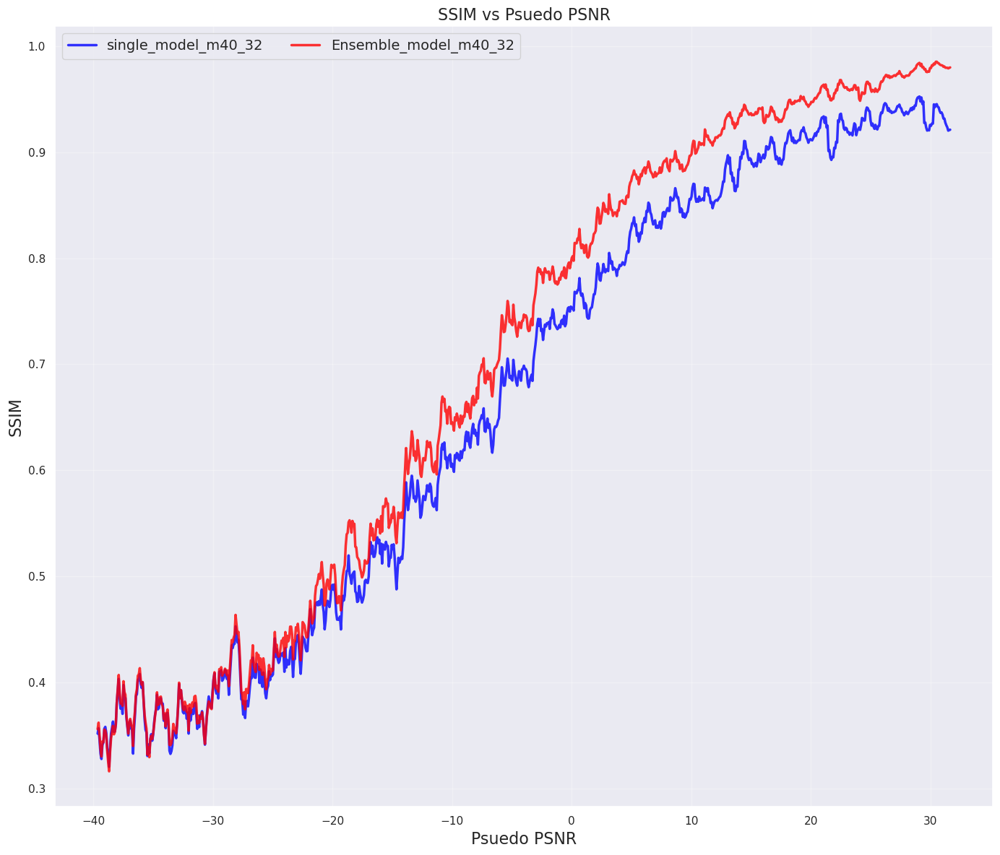

In [41]:
# Plots the SSIM vs Psuedo PSNR for the different models in the cascade and compares this to the original model.
plt.figure(figsize=(14,12))
sns.set_style("darkgrid")
sns.lineplot(data = Smoothed_SSIM_Distribution, x = "Psuedo_Psnr", y = "SSIM_Distribution_m40_32", alpha = 0.8, color = "blue", linewidth = 2.5, label = "single_model_m40_32")
sns.lineplot(data = Smoothed_SSIM_Distribution, x = "Psuedo_Psnr", y = "Augmented_SSIM_Distribution_m40_32", alpha = 0.8, color = "red", linewidth = 2.5, label = "Ensemble_model_m40_32")
plt.xlabel("Psuedo PSNR", fontsize = 16)
plt.ylabel("SSIM", fontsize = 16)
plt.grid(True, alpha = 0.3)
plt.title("SSIM vs Psuedo PSNR", fontsize = 16)
plt.legend(fontsize = 14, loc = "upper left", ncol = 2)
plt.tight_layout()
plt.savefig("Figures/SSIM_vs_Psuedo_PSNR_Ensemble_Model_m40_32.pdf", format = "pdf", dpi = 300)
plt.show()

In [42]:
# Generates the Perceptual Loss Distribution for the combined data.
uniform = np.linspace(-40, 32, 900)
Perceptual_Distribution = pd.DataFrame({"Psuedo_Psnr":uniform, "Perceptual_Distribution_m40_32":Perceptual_Distribution_1, "Perceptual_Distribution_24_32":Perceptual_Distribution_2, "Perceptual_Distribution_16_24":Perceptual_Distribution_3, 
                                  "Perceptual_Distribution_8_16":Perceptual_Distribution_4, "Perceptual_Distribution_0_8":Perceptual_Distribution_5, "Perceptual_Distribution_m8_0":Perceptual_Distribution_6, 
                                  "Perceptual_Distribution_m16_m8":Perceptual_Distribution_7, "Perceptual_Distribution_m24_m16":Perceptual_Distribution_8, "Perceptual_Distribution_m32_m24":Perceptual_Distribution_9, 
                                  "Perceptual_Distribution_m40_m32":Perceptual_Distribution_10})
Perceptual_Distribution

,Psuedo_Psnr,Perceptual_Distribution_m40_32,Perceptual_Distribution_24_32,Perceptual_Distribution_16_24,Perceptual_Distribution_8_16,Perceptual_Distribution_0_8,Perceptual_Distribution_m8_0,Perceptual_Distribution_m16_m8,Perceptual_Distribution_m24_m16,Perceptual_Distribution_m32_m24,Perceptual_Distribution_m40_m32
0,-40.000000,0.172402,0.172471,0.172535,0.172383,0.172152,0.172290,0.172114,0.172341,0.172383,0.172368
1,-39.919911,0.151720,0.151741,0.151726,0.151696,0.151620,0.151652,0.151614,0.151644,0.151655,0.151659
2,-39.839822,0.126976,0.126897,0.126885,0.126873,0.126889,0.126856,0.126832,0.126868,0.126854,0.126844
3,-39.759733,0.153367,0.153335,0.153297,0.153239,0.153194,0.153809,0.153121,0.153304,0.153366,0.153370
4,-39.679644,0.111610,0.111674,0.111655,0.111602,0.111566,0.111513,0.111484,0.111603,0.111653,0.111661
...,...,...,...,...,...,...,...,...,...,...,...
895,31.679644,0.700143,0.760210,0.549881,0.327733,0.426341,0.446500,0.340634,0.403851,0.320594,0.343137
896,31.759733,0.675431,0.711991,0.516730,0.355432,0.408861,0.408557,0.315067,0.399867,0.361277,0.350946
897,31.839822,0.577300,0.612782,0.541900,0.387946,0.390482,0.401430,0.318124,0.346411,0.269027,0.318322
898,31.919911,0.661423,0.700552,0.497096,0.324350,0.426386,0.378065,0.332513,0.383573,0.310340,0.306761


In [43]:
# Generates the smoothed Perceptual Loss Distribution for the combined data.
Smoothed_Perceptual_Distribution = Perceptual_Distribution.rolling(window=10).mean()
Smoothed_Perceptual_Distribution = Smoothed_Perceptual_Distribution.dropna()
Smoothed_Perceptual_Distribution

,Psuedo_Psnr,Perceptual_Distribution_m40_32,Perceptual_Distribution_24_32,Perceptual_Distribution_16_24,Perceptual_Distribution_8_16,Perceptual_Distribution_0_8,Perceptual_Distribution_m8_0,Perceptual_Distribution_m16_m8,Perceptual_Distribution_m24_m16,Perceptual_Distribution_m32_m24,Perceptual_Distribution_m40_m32
9,-39.639600,0.135467,0.135548,0.135541,0.135426,0.135323,0.135667,0.135206,0.135406,0.135448,0.135450
10,-39.559511,0.136927,0.137003,0.136995,0.136881,0.136787,0.137117,0.136655,0.136865,0.136908,0.136912
11,-39.479422,0.135272,0.135346,0.135338,0.135224,0.135151,0.135495,0.134996,0.135208,0.135255,0.135258
12,-39.399333,0.134909,0.135000,0.134986,0.134866,0.134784,0.135134,0.134629,0.134850,0.134906,0.134911
13,-39.319244,0.127537,0.127669,0.127676,0.127520,0.127425,0.127847,0.127249,0.127480,0.127531,0.127535
...,...,...,...,...,...,...,...,...,...,...,...
895,31.319244,0.648668,0.686270,0.558755,0.362558,0.409039,0.419397,0.303149,0.385213,0.319334,0.351245
896,31.399333,0.655081,0.693457,0.553922,0.366661,0.413949,0.426414,0.306808,0.390518,0.331813,0.353412
897,31.479422,0.649299,0.689193,0.550407,0.373953,0.412339,0.428036,0.305199,0.388741,0.329870,0.350582
898,31.559511,0.653860,0.694675,0.540970,0.368127,0.414903,0.424028,0.311187,0.387967,0.326403,0.346114


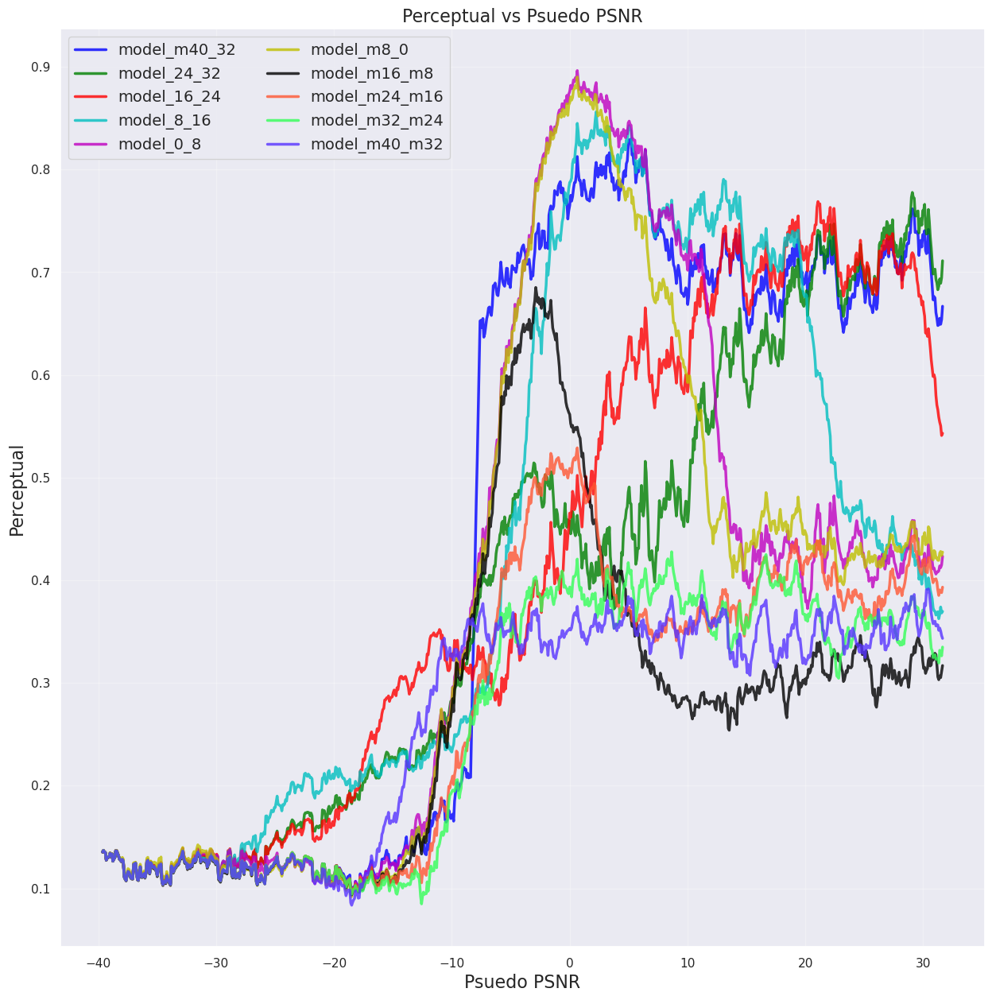

In [47]:
# Plots the Perceptual Loss vs Psuedo PSNR for the different models in the cascade.
plt.figure(figsize=(15,15))
sns.set_style("darkgrid")
markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', 'h']
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', '#ff5733', '#33ff57', '#5733ff']
labels = [f"model_{psnr}" for psnr in Psnr_columns]
for idx, psnr in enumerate(Smoothed_Perceptual_Distribution.columns[1:]):
    marker = markers[idx % len(markers)]
    label = labels[idx % len(labels)]
    color = colors[idx % len(colors)]
    sns.lineplot(data = Smoothed_Perceptual_Distribution, x = "Psuedo_Psnr", y = psnr, alpha = 0.8, color = color, linewidth = 2.5, label = label)
plt.xlabel("Psuedo PSNR", fontsize = 16)
plt.ylabel("Perceptual", fontsize = 16)
plt.grid(True, alpha = 0.3)
plt.title("Perceptual vs Psuedo PSNR", fontsize = 16)
plt.legend(fontsize = 14, loc = "upper left", ncol = 2)
plt.show()

In [44]:
# Combines the 9 different models into a single model.
Augmented_Perceptual_Distribution = []
for idx in range(len(PSNR_Ranges)):
    Psnr_query = Smoothed_Perceptual_Distribution.query(f"Psuedo_Psnr >= {PSNR_Ranges[idx][0]} and Psuedo_Psnr <= {PSNR_Ranges[idx][1]}")
    Specific_Perceptual_Distribution = Psnr_query.iloc[:, -(idx+1)].values
    Augmented_Perceptual_Distribution.extend(Specific_Perceptual_Distribution)
Augmented_Perceptual_Distribution = np.array(Augmented_Perceptual_Distribution)
Augmented_Perceptual_Distribution.shape

(891,)

In [45]:
Smoothed_Perceptual_Distribution["Augmented_Perceptual_Distribution_m40_32"] = Augmented_Perceptual_Distribution

In [227]:
np.save("Data/Original_Ensemble_Model_Perceptual_m40_32.npy", Smoothed_Perceptual_Distribution["Augmented_Perceptual_Distribution_m40_32"].values)

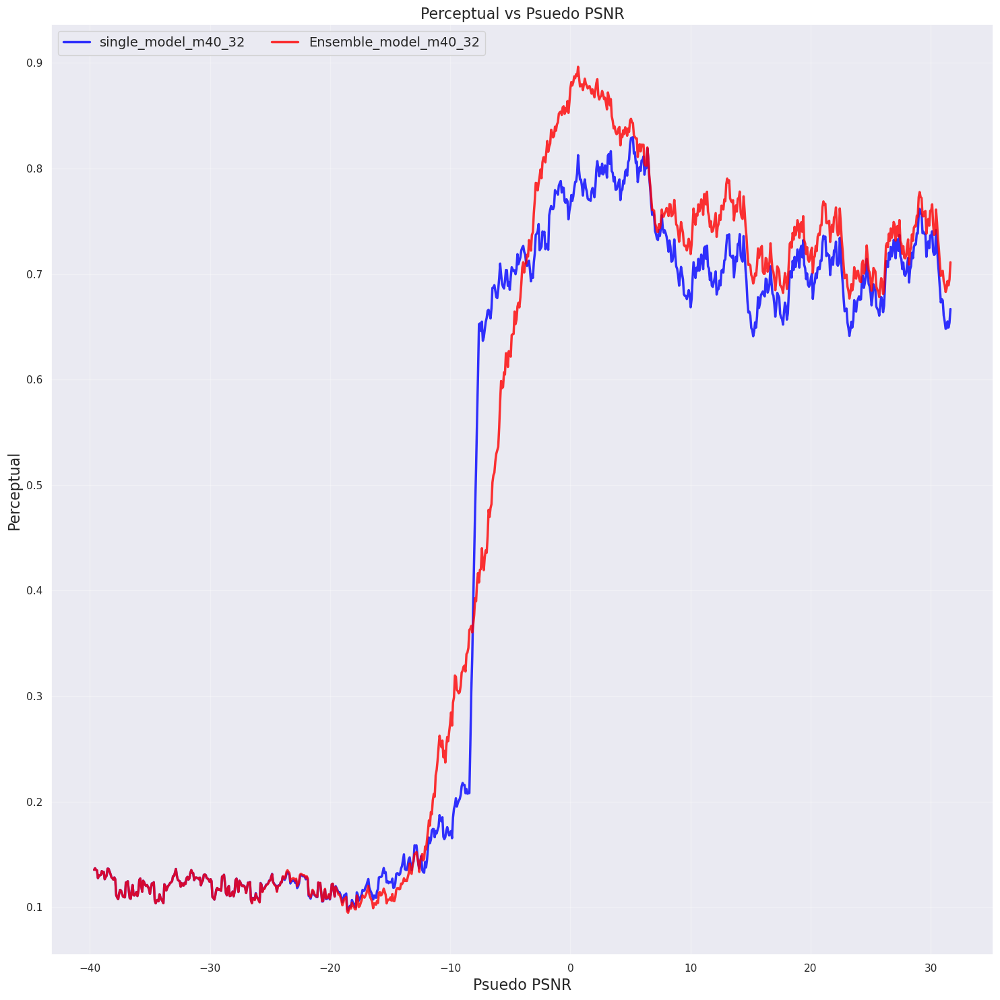

In [46]:
# Plots the Perceptual Loss vs Psuedo PSNR for the different models in the cascade and compares this to the original model.
plt.figure(figsize=(15,15))
sns.set_style("darkgrid")
sns.lineplot(data = Smoothed_Perceptual_Distribution, x = "Psuedo_Psnr", y = "Perceptual_Distribution_m40_32", alpha = 0.8, color = "blue", linewidth = 2.5, label = "single_model_m40_32")
sns.lineplot(data = Smoothed_Perceptual_Distribution, x = "Psuedo_Psnr", y = "Augmented_Perceptual_Distribution_m40_32", alpha = 0.8, color = "red", linewidth = 2.5, label = "Ensemble_model_m40_32")
plt.xlabel("Psuedo PSNR", fontsize = 16)
plt.ylabel("Perceptual", fontsize = 16)
plt.grid(True, alpha = 0.3)
plt.title("Perceptual vs Psuedo PSNR", fontsize = 16)
plt.legend(fontsize = 14, loc = "upper left", ncol = 2)
plt.tight_layout()
plt.savefig("Figures/Perceptual_vs_Psuedo_PSNR_Ensemble_Model_m40_32.pdf", format = "pdf", dpi = 300)
plt.show()

In [47]:
Ensemble_Model_Psnr = np.load("Data/Original_Psnr_Ensemble_Model_m40_32.npy")
Ensemble_Model_SSIM = np.load("Data/Original_Ensemble_Model_SSIM_m40_32.npy")
Ensemble_Model_Perceptual = np.load("Data/Original_Ensemble_Model_Perceptual_m40_32.npy")

,PSNR,Pseudo_PSNR,PSNR_Average,PSNR_Variance,PSNR_Variance_Upper,PSNR_Variance_Lower
count,880.000000,880.000000,880.000000,880.000000,880.000000,880.000000
mean,25.000216,-3.555056,24.846073,0.265347,25.111420,24.580727
std,8.321141,20.562748,8.294425,0.103159,8.294013,8.296120
min,13.048566,-39.110112,13.460849,0.114029,13.691034,13.211092
25%,17.280903,-21.332584,17.238414,0.186903,17.502822,16.974006
50%,24.352513,-3.555056,24.213775,0.239533,24.389101,24.025099
75%,32.639319,14.222472,32.610014,0.323134,32.852190,32.400263
max,40.220697,32.000000,39.728020,0.595254,40.104940,39.394259


,SSIM,Pseudo_PSNR,SSIM_Average,SSIM_Variance,SSIM_Variance_Upper,SSIM_Variance_Lower
count,880.000000,880.000000,880.000000,880.000000,880.000000,880.000000
mean,0.706212,-3.555056,0.702251,0.009340,0.711591,0.692911
std,0.223947,20.562748,0.224421,0.006189,0.220069,0.228859
min,0.316275,-39.110112,0.339673,0.000857,0.351672,0.327674
25%,0.477016,-21.332584,0.473499,0.004774,0.491188,0.455811
50%,0.747222,-3.555056,0.742407,0.007826,0.752109,0.733360
75%,0.931296,14.222472,0.930542,0.012480,0.935514,0.925285
max,0.985213,32.000000,0.983031,0.032658,0.984863,0.981721


,1-PL,Pseudo_PSNR,1-PL_Average,1-PL_Variance,1-PL_Variance_Upper,1-PL_Variance_Lower
count,869.000000,869.000000,869.000000,869.000000,869.000000,869.000000
mean,0.481994,-3.110112,0.478419,0.010641,0.485249,0.471589
std,0.307567,20.305860,0.308121,0.006676,0.310334,0.306029
min,0.094793,-38.220225,0.100727,0.002821,0.103016,0.097332
25%,0.123540,-20.665169,0.122324,0.005803,0.124330,0.119239
50%,0.685850,-3.110112,0.691419,0.008622,0.698693,0.677707
75%,0.749195,14.444944,0.749918,0.013040,0.755644,0.742575
max,0.896368,32.000000,0.884283,0.036715,0.892992,0.879143


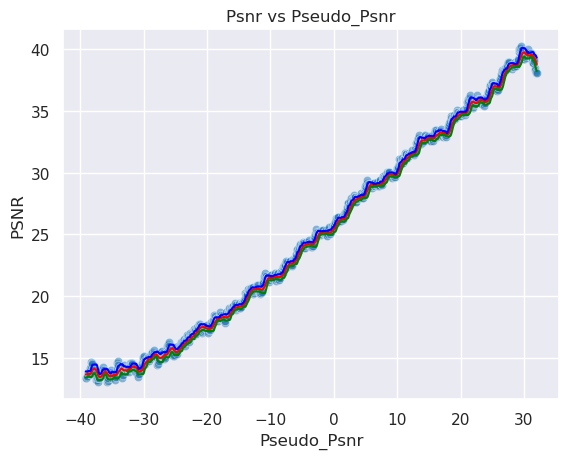

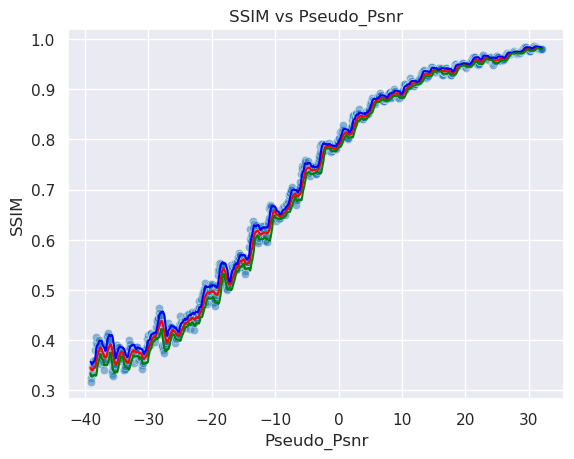

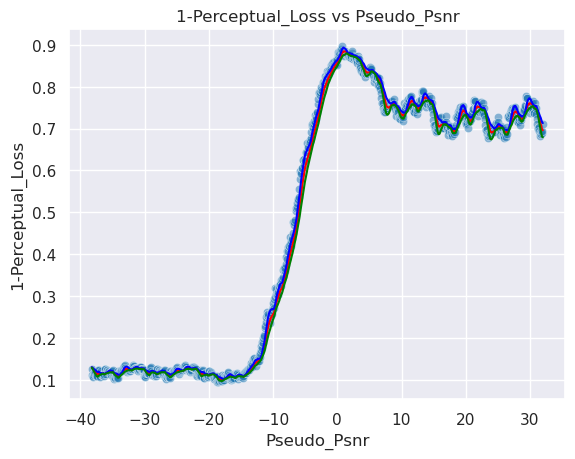

Psnr Area: 1766.6962831970313, SSIM Area: 49.940321415021515, Perceptual Area: 33.599977358619824
Mean Psnr 25.00021560505074
Std Psnr 8.321141351731157
Min Psnr 13.048565888250803
Max Psnr 40.220697468399365
Mean Roll Var 0.2653465607389636
Mean SSIM 0.7062121257135135
Std SSIM 0.22394672332681648
Min SSIM 0.31627493649721145
Max SSIM 0.9852134585380554
Mean Roll SSIM 0.009339782787042955
Mean 1-PL 0.481994172886134
Std 1-PL 0.3075672983620723
Min 1-PL 0.09479270577430725
Max 1-PL 0.8963682472705841
Mean Roll 1-PL 0.010640973798586084


(1766.6962831970313, 49.940321415021515, 33.599977358619824)

In [231]:
# Generates the dataframes for the Psnr, SSIM and Perceptual Loss, and produces their plots for the Ninth Highest PSNR Range.
Plot_Creater(Ensemble_Model_Psnr, Ensemble_Model_SSIM, Ensemble_Model_Perceptual, minpsnr, maxpsnr)

In [250]:
# Loads the models from their checkpoints and combines them to form the ensemble model.
name = "FaceGenerationUNet128x128-m40-m32"
CHECKPOINT_PATH = "./models/"
model_m40_32 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationUNet128x128-m32-m24"
CHECKPOINT_PATH = "./models/"
model_m32_24 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationUNet128x128-m24-m16"
CHECKPOINT_PATH = "./models/"
model_m24_16 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationUNet128x128-m16-m8"
CHECKPOINT_PATH = "./models/"
model_m16_8 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationUNet128x128-m8-0"
CHECKPOINT_PATH = "./models/"
model_m8_0 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationUNet128x128-0-8"
CHECKPOINT_PATH = "./models/"
model_0_8 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationUNet128x128-8-16"
CHECKPOINT_PATH = "./models/"
model_8_16 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationUNet128x128-16-24"
CHECKPOINT_PATH = "./models/"
model_16_24 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

name = "FaceGenerationUNet128x128-24-32"
CHECKPOINT_PATH = "./models/"
model_24_32 = UNet.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

Models = [model_m40_32, model_m32_24, model_m24_16, model_m16_8, model_m8_0, model_0_8, model_8_16, model_16_24, model_24_32]
Models

c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:256: UserWarning: nn.init.xavier_normal is now deprecated in favor of nn.init.xavier_normal_.
  init.xavier_normal(m.weight)
c:\Users\kdarn\OneDrive\Documents\Life's Portfolio\Projects\GAPGalaxies\OriginalGAPUNet.py:257: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  init.constant(m.bias, 0)


[UNet(
   (conv_final): Conv2d(50, 3, kernel_size=(1, 1), stride=(1, 1))
   (down_convs): ModuleList(
     (0): DownConv(
       (conv1): Conv2d(30, 50, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (conv2): Conv2d(50, 50, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (conv3): Conv2d(50, 50, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
     )
     (1): DownConv(
       (conv1): Conv2d(50, 100, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (conv2): Conv2d(100, 100, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (conv3): Conv2d(100, 100, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
     )
     (2): DownConv(
       (conv1): Conv2d(100, 200, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
       (conv2): Conv2d(200, 200, kernel_size=(3, 3), stride=(1,

In [251]:
def sample_image_3(input_image,
                 model,
                 max_photons = None,
                 max_its = 500000,
                 max_psnr = -15,
                 save_every_n = 5,
                 beta = 0.1
                ):

    start = input_image.clone()
    photons = start
    photnum = 1
    model = model.to(device)

    denoised = None
    stack = []
    
    sumDenoised = start
    region = 64
    
    for i in range(max_its):
        #print(i)
        # compute the pseudo PSNR
        psnr = np.log10(photons.mean().item() + 1e-50) * 10
        psnr = max(-40, psnr)
        print("Hello World", psnr, max_psnr)
        if i % 10 == 0:
            print(psnr)
            
        if (max_photons is not None) and (photons.sum().item() > max_photons):
            print(max_photons, "Maximum Photons Reached")
            break
            
        if psnr > max_psnr:
            print(psnr, "Maximum Psnr Reached")
            break
    
        denoised = model(photons).detach()
        denoised = denoised - denoised.max()
        denoised = torch.exp(denoised)   
        denoised = denoised / (denoised.sum(dim=(-1,-2,-3), keepdim = True))

        #denoised = (denoised - denoised.min())/(denoised.max() - denoised.min())
        #plt.figure(figsize=(5,5))
        #plt.imshow(denoised.squeeze(0).permute(1,2,0).detach().cpu().numpy(),vmin = 0, vmax = vmax)
        #plt.title('denoised')
        #plt.show()
        #plt.clf()

        #photon_image = (photons - photons.min())/(photons.max() - photons.min())
        #plt.imshow(photon_image.squeeze(0).permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
        #plt.title('photons')
        #plt.show()
        #plt.clf()

        # here we save an image into our stack
        if (save_every_n is not None) and (i%save_every_n == 0):  

            imgsave = denoised.squeeze(0).permute(1,2,0).detach().cpu()
            imgsave = imgsave/imgsave.max()
            photsave = photons.squeeze(0).permute(1,2,0).detach().cpu()
            photsave = photsave / max(photsave.max(),1)      
            combi = torch.hstack((photsave,imgsave))
            stack.append(combi.numpy())

        # increase photon number
        photnum = max(beta* photons.sum(),1)
        
        # draw new photons
        new_photons = torch.poisson(denoised*(photnum)) 
        
        # add new photons
        photons = photons + new_photons 
        #photon_image_new = (photons_new - photons_new.min())/(photons_new.max() - photons_new.min())
        #plt.imshow(photon_image_new.squeeze(0).permute(1,2,0).detach().cpu().numpy(), vmin = 0, vmax = vmax)
        #plt.title('photons_new')
        #plt.show()
        #plt.clf()
    
    #print("Final PSNR Score", psnr)
    denoised_2 = denoised[...].detach().cpu().numpy()
    denoised_2 = (denoised_2 - denoised_2.min())/(denoised_2.max() - denoised_2.min())
    vmax = denoised_2.max()
    plt.figure(figsize=(5,5))
    plt.imshow(denoised_2[0].transpose(1,2,0),vmin = 0, vmax = vmax)
    plt.show()
    plt.clf()
    return denoised, photons, stack, i, psnr


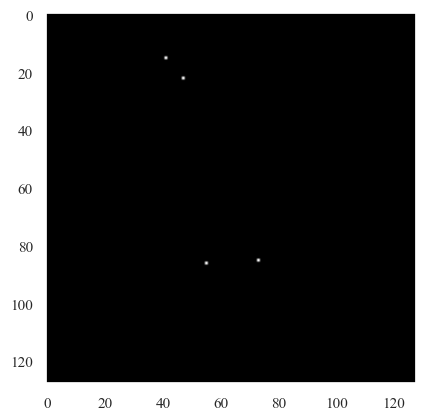

PSNR: -35.68800735473633


In [254]:
# Checks the Train_Dataset works
ImageNoise, psnr_map, image_target = Train_Dataset.__getitem__(40)
plt.imshow(ImageNoise.detach().cpu().numpy().transpose(1,2,0)[:,:,0], cmap = "gray")
plt.show()
print(f"PSNR: {psnr_map.min().detach().cpu().numpy()}")

In [255]:
PSNR_Ranges

[(-40, -32),
 (-32, -24),
 (-24, -16),
 (-16, -8),
 (-8, 0),
 (0, 8),
 (8, 16),
 (16, 24),
 (24, 32)]

PSNR: -500.0
Model: 1, psnr_level -32
Hello World -40 -32
-40
Hello World -40 -32
Hello World -40 -32
Hello World -40 -32
Hello World -40 -32
Hello World -40 -32
Hello World -40 -32
Hello World -40 -32
Hello World -39.92571168970606 -32
Hello World -39.133899436317556 -32
Hello World -38.46443124417179 -32
-38.46443124417179
Hello World -38.46443124417179 -32
Hello World -36.91541173306625 -32
Hello World -36.50148499444094 -32
Hello World -36.50148499444094 -32
Hello World -35.45413128753198 -32
Hello World -35.45413128753198 -32
Hello World -35.45413128753198 -32
Hello World -35.45413128753198 -32
Hello World -35.45413128753198 -32
Hello World -35.15449934959718 -32
-35.15449934959718
Hello World -34.610922482738616 -32
Hello World -34.36268688912093 -32
Hello World -34.36268688912093 -32
Hello World -33.90511177642644 -32
Hello World -33.90511177642644 -32
Hello World -33.6932189928148 -32
Hello World -33.6932189928148 -32
Hello World -33.49118503780113 -32
Hello World -33.298133399

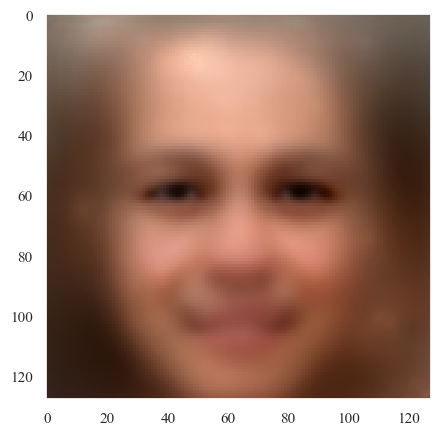

Psnr_Range -31.863912027525096 has been reached at 38 iterations
Model: 2, psnr_level -24
Hello World -31.863912027525096 -24
-31.863912027525096
Hello World -31.863912027525096 -24
Hello World -31.863912027525096 -24
Hello World -31.863912027525096 -24
Hello World -31.73027254137512 -24
Hello World -31.474731378315383 -24
Hello World -31.11757586499234 -24
Hello World -30.78757327193823 -24
Hello World -30.580727191718363 -24
Hello World -30.580727191718363 -24
Hello World -30.194433272674374 -24
-30.194433272674374
Hello World -30.102999566398122 -24
Hello World -30.013450970817637 -24
Hello World -29.925711565453422 -24
Hello World -29.925711565453422 -24
Hello World -29.925711565453422 -24
Hello World -29.591474341924307 -24
Hello World -29.511784894602286 -24
Hello World -29.433531374252357 -24
Hello World -29.433531374252357 -24
Hello World -29.433531374252357 -24
-29.433531374252357
Hello World -29.35666338342908 -24
Hello World -29.281131861705486 -24
Hello World -29.2068915429

<Figure size 640x480 with 0 Axes>

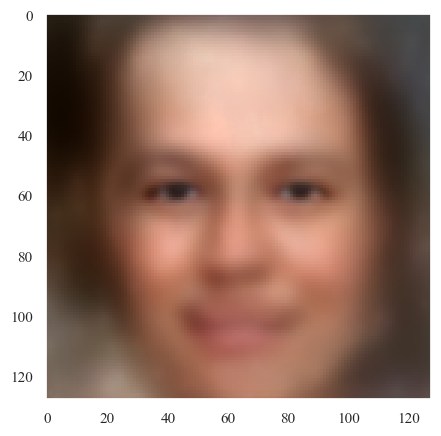

Psnr_Range -23.94876003753868 has been reached at 120 iterations
Model: 3, psnr_level -16
Hello World -23.94876003753868 -16
-23.94876003753868
Hello World -23.94876003753868 -16
Hello World -23.92688100955422 -16
Hello World -23.840451234578136 -16
Hello World -23.819110265895006 -16
Hello World -23.79787316796699 -16
Hello World -23.6932189928148 -16
Hello World -23.6932189928148 -16
Hello World -23.672587230143705 -16
Hello World -23.672587230143705 -16
Hello World -23.631615905766616 -16
-23.631615905766616
Hello World -23.631615905766616 -16
Hello World -23.631615905766616 -16
Hello World -23.570874428644682 -16
Hello World -23.570874428644682 -16
Hello World -23.510970791752808 -16
Hello World -23.451882195647606 -16
Hello World -23.43236316108925 -16
Hello World -23.355153076292908 -16
Hello World -23.355153076292908 -16
Hello World -23.355153076292908 -16
-23.355153076292908
Hello World -23.317056972064986 -16
Hello World -23.26053194842586 -16
Hello World -23.20473317644072 -1

<Figure size 640x480 with 0 Axes>

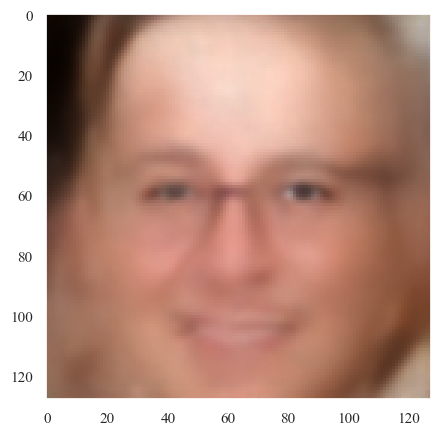

Psnr_Range -15.974195981748379 has been reached at 187 iterations
Model: 4, psnr_level -8
Hello World -15.974195981748379 -8
-15.974195981748379
Hello World -15.946311598015582 -8
Hello World -15.897941095835774 -8
Hello World -15.867127799504196 -8
Hello World -15.819626471110125 -8
Hello World -15.765967681311984 -8
Hello World -15.716257737015539 -8
Hello World -15.680162130726671 -8
Hello World -15.667110346588426 -8
Hello World -15.61529224693954 -8
Hello World -15.576830493357743 -8
-15.576830493357743
Hello World -15.548206075106485 -8
Hello World -15.510331317968788 -8
Hello World -15.460340226057365 -8
Hello World -15.413990321668404 -8
Hello World -15.359015602556227 -8
Hello World -15.328772040038974 -8
Hello World -15.280816240523885 -8
Hello World -15.215730200185067 -8
Hello World -15.180635505624046 -8
Hello World -15.142933489475311 -8
-15.142933489475311
Hello World -15.074178311018958 -8
Hello World -15.026127102545457 -8
Hello World -14.981382569911233 -8
Hello World

<Figure size 640x480 with 0 Axes>

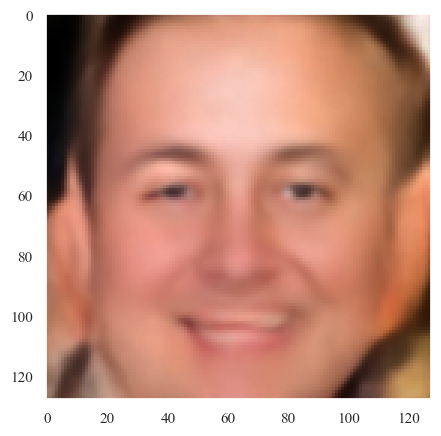

Psnr_Range -7.971143560512113 has been reached at 185 iterations
Model: 5, psnr_level 0
Hello World -7.971143560512113 0
-7.971143560512113
Hello World -7.927063425630144 0
Hello World -7.879086779311615 0
Hello World -7.8332431472985515 0
Hello World -7.7905343268307545 0
Hello World -7.747188837372967 0
Hello World -7.710526166239532 0
Hello World -7.665902798938161 0
Hello World -7.624800699306338 0
Hello World -7.579526714639425 0
Hello World -7.54374465793508 0
-7.54374465793508
Hello World -7.503777338569259 0
Hello World -7.454821336302755 0
Hello World -7.407870124218956 0
Hello World -7.361902248967779 0
Hello World -7.322612438844604 0
Hello World -7.2850929587157855 0
Hello World -7.242272642966256 0
Hello World -7.1956991761564275 0
Hello World -7.160174698374498 0
Hello World -7.114923378490996 0
-7.114923378490996
Hello World -7.072389620354959 0
Hello World -7.01868946391526 0
Hello World -6.9770830589235056 0
Hello World -6.941985034137767 0
Hello World -6.9063011072283

<Figure size 640x480 with 0 Axes>

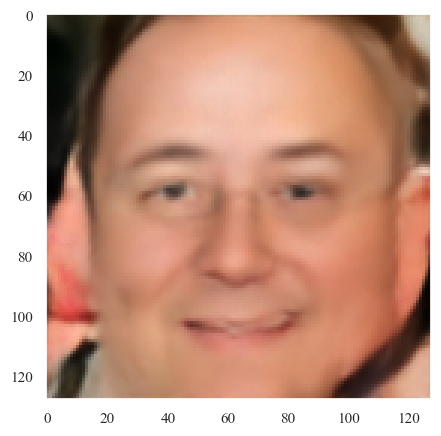

Psnr_Range 0.037040249139962164 has been reached at 185 iterations
Model: 6, psnr_level 8
Hello World 0.037040249139962164 8
0.037040249139962164
Hello World 0.080450879838603 8
Hello World 0.12377556357572829 8
Hello World 0.16573654017492415 8
Hello World 0.20872812871600646 8
Hello World 0.25096456889400953 8
Hello World 0.29312425256912167 8
Hello World 0.33626930062924865 8
Hello World 0.377208465462568 8
Hello World 0.42193620472155113 8
Hello World 0.46596988959151087 8
0.46596988959151087
Hello World 0.5086185808304405 8
Hello World 0.5539643805008714 8
Hello World 0.5983801680710871 8
Hello World 0.6417362894539681 8
Hello World 0.6830791308600281 8
Hello World 0.7271716961752163 8
Hello World 0.7683050689044836 8
Hello World 0.8097855537097755 8
Hello World 0.8510191486290142 8
Hello World 0.8897053481765193 8
0.8897053481765193
Hello World 0.9347529419885416 8
Hello World 0.97658652267513 8
Hello World 1.0215145578373412 8
Hello World 1.0654985168209437 8
Hello World 1.10958

<Figure size 640x480 with 0 Axes>

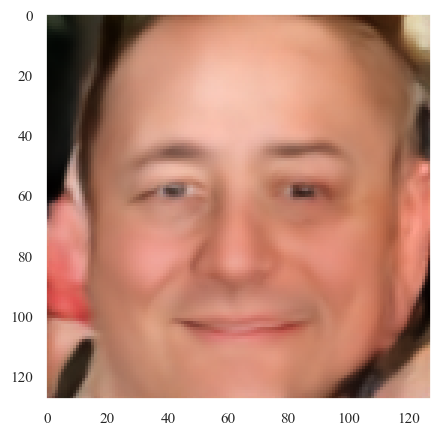

Psnr_Range 8.01022273408285 has been reached at 185 iterations
Model: 7, psnr_level 16
Hello World 8.01022273408285 16
8.01022273408285
Hello World 8.053704841467516 16
Hello World 8.096043919197966 16
Hello World 8.139249005010855 16
Hello World 8.18240460009888 16
Hello World 8.22553444598979 16
Hello World 8.269030002180887 16
Hello World 8.313553773304006 16
Hello World 8.356245342010222 16
Hello World 8.398904589967653 16
Hello World 8.442198995368512 16
8.442198995368512
Hello World 8.486718888085448 16
Hello World 8.530526486593757 16
Hello World 8.57332024731145 16
Hello World 8.61734871103102 16
Hello World 8.660129329941743 16
Hello World 8.702361697734098 16
Hello World 8.745296338119974 16
Hello World 8.788931586720576 16
Hello World 8.832977071821658 16
Hello World 8.875286770523495 16
8.875286770523495
Hello World 8.918831730532983 16
Hello World 8.961630377035345 16
Hello World 9.005067172257634 16
Hello World 9.048326498596166 16
Hello World 9.092662586602495 16
Hello W

<Figure size 640x480 with 0 Axes>

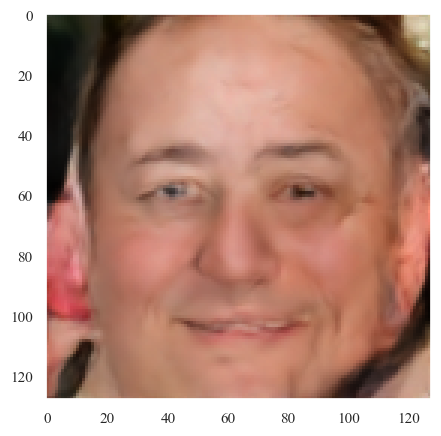

Psnr_Range 16.010234408400702 has been reached at 185 iterations
Model: 8, psnr_level 24
Hello World 16.010234408400702 24
16.010234408400702
Hello World 16.053562158961263 24
Hello World 16.097161088855305 24
Hello World 16.140436265831795 24
Hello World 16.183584078613414 24
Hello World 16.226659764173068 24
Hello World 16.26992719589233 24
Hello World 16.313162771489786 24
Hello World 16.35663615124809 24
Hello World 16.40056370264102 24
Hello World 16.443570089565213 24
16.443570089565213
Hello World 16.486139147427373 24
Hello World 16.529383351088903 24
Hello World 16.572833671773203 24
Hello World 16.616862452523552 24
Hello World 16.65967935808333 24
Hello World 16.702855979429202 24
Hello World 16.745444936806418 24
Hello World 16.7887788387606 24
Hello World 16.83171073818494 24
Hello World 16.874938935074326 24
16.874938935074326
Hello World 16.91823694377447 24
Hello World 16.96179755721982 24
Hello World 17.005086049165126 24
Hello World 17.048771745549985 24
Hello World 1

<Figure size 640x480 with 0 Axes>

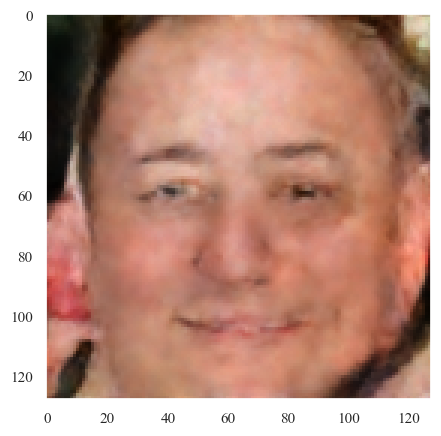

Psnr_Range 24.009338364606684 has been reached at 185 iterations
Model: 9, psnr_level 32
Hello World 24.009338364606684 32
24.009338364606684
Hello World 24.0524078748096 32
Hello World 24.095648570836154 32
Hello World 24.13902615267049 32
Hello World 24.18241038833479 32
Hello World 24.225663573758315 32
Hello World 24.268807162436797 32
Hello World 24.312052318003936 32
Hello World 24.35524937455225 32
Hello World 24.398456671509166 32
Hello World 24.44170877664085 32
24.44170877664085
Hello World 24.484966640814246 32
Hello World 24.52820110422767 32
Hello World 24.571462293911242 32
Hello World 24.61474977391152 32
Hello World 24.657858557384394 32
Hello World 24.700975139308067 32
Hello World 24.74429292603297 32
Hello World 24.787495418452433 32
Hello World 24.830768743901245 32
Hello World 24.873894740026895 32
24.873894740026895
Hello World 24.91696325563726 32
Hello World 24.960356712641083 32
Hello World 25.003597276900145 32
Hello World 25.046842783016242 32
Hello World 25.

<Figure size 640x480 with 0 Axes>

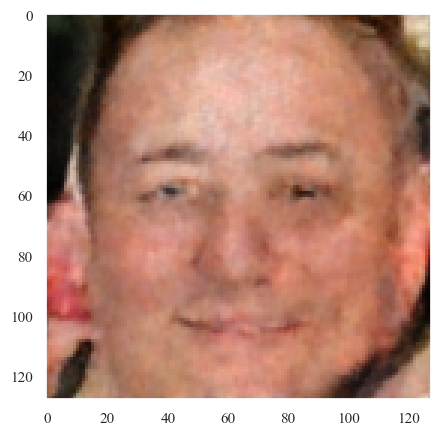

Psnr_Range 32.00384669195975 has been reached at 185 iterations


((9, 1, 3, 128, 128), (9, 1, 3, 128, 128))

<Figure size 640x480 with 0 Axes>

In [261]:
# Generates an unseen image from a blank canvas using the ensemble model.
def Sample_From_Scratch(input_image,
                        Models,
                        max_photons = None,
                        max_its = 500000,
                        max_psnr_list = None,
                        save_every_n = 5,
                        beta = 0.15
                        ):
    output_images = np.zeros((len(Models), input_image.shape[0], input_image.shape[1], input_image.shape[2], input_image.shape[3]))
    output_photons = np.zeros((len(Models), input_image.shape[0], input_image.shape[1], input_image.shape[2], input_image.shape[3]))
    stacks = []
    for i, model in enumerate(Models):
        if i == 0:
            photons = input_image.clone()
        if max_psnr_list is not None:
            max_psnr = max_psnr_list[i]
        else:
            max_psnr = -15
        print(f"Model: {i+1}, psnr_level {max_psnr_list[i]}")
        denoised, photons, stack, it, psnr = sample_image_3(photons, model, max_photons = max_photons, max_its = max_its, max_psnr = max_psnr, save_every_n = save_every_n, beta = beta)
        print(f"Psnr_Range {psnr} has been reached at {it} iterations")
        output_images[i] = denoised[...].detach().cpu().numpy()
        output_photons[i] = photons[...].detach().cpu().numpy()
        stacks.append(stack)

    return output_images, output_photons

inp_img = torch.zeros(1,3,128,128).to(device)
Psnr = np.log10(inp_img.mean().item() + 1e-50) * 10
print(f"PSNR: {Psnr}")
Output_Images, Output_Photons = Sample_From_Scratch(inp_img, Models, max_photons = 1e8, max_its = 1000, max_psnr_list = [-32, -24, -16, -8, 0, 8, 16, 24, 32], save_every_n = 5, beta = 0.01)
Output_Images.shape, Output_Photons.shape